In [2]:
from pygradu import shortest_path
from pygradu import gridify

import shapely.geometry
import pandas as pd
import numpy as np
import importlib

importlib.reload(gridify)

grid_2500m = gridify.area_to_grid(side_length=2500)
grid_5km = gridify.area_to_grid(side_length=5000)

MODELS_DIR = 'data/models/'
DATASET_DIR = 'data/datasets/'

graph_df_adj_2500m = pd.read_csv(MODELS_DIR + 'complete_graph_adjacent_2500m.csv')[['original', 'connected', 'cost']]
graph_df_ship_2500m = pd.read_csv(MODELS_DIR + 'complete_graph_ship_model_2500m.csv')[['original', 'connected', 'cost']]

graph_df_adj_5km = pd.read_csv(MODELS_DIR + 'complete_graph_adjacent_5km.csv')[['original', 'connected', 'cost']]
graph_df_ship_5km = pd.read_csv(MODELS_DIR + 'complete_graph_ship_model_5km.csv')[['original', 'connected', 'cost']]

graph_df_adj_5km.head()

/Users/howardhuang/anaconda3/envs/treehacks2025/lib/python3.11/site-packages/pyproj/crs/crs.py:143: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/howardhuang/anaconda3/envs/treehacks2025/lib/python3.11/site-packages/pyproj/crs/crs.py:143: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:160: FutureWarning: This function is deprecated. See: https://pyproj4.gi

Original NE: POINT (31.5 66.8)
Original SW: POINT (8.5 53)
Transformed NE: (697681.2863658136, 7416224.9393330095)
Transformed SW: (-735260.4063631196, 6033964.466017238)
col_count 573
row_count 552
grid_size 316296
Original NE: POINT (31.5 66.8)
Original SW: POINT (8.5 53)
Transformed NE: (697681.2863658136, 7416224.9393330095)
Transformed SW: (-735260.4063631196, 6033964.466017238)
col_count 286
row_count 276
grid_size 78936


,original,connected,cost
0,350,351,1.0
1,350,625,1.0
2,350,626,1.0
3,350,627,1.0
4,351,350,1.0


In [3]:
importlib.reload(shortest_path)

%time graph_adj_2500m = shortest_path.df_to_graph(graph_df_adj_2500m)
%time graph_ship_2500m = shortest_path.df_to_graph(graph_df_ship_2500m)

%time graph_adj_5km = shortest_path.df_to_graph(graph_df_adj_5km)
%time graph_ship_5km = shortest_path.df_to_graph(graph_df_ship_5km)

CPU times: user 564 ms, sys: 42.5 ms, total: 607 ms
Wall time: 609 ms
CPU times: user 4.67 s, sys: 299 ms, total: 4.97 s
Wall time: 5.04 s
CPU times: user 114 ms, sys: 7.14 ms, total: 121 ms
Wall time: 123 ms
CPU times: user 1.18 s, sys: 129 ms, total: 1.31 s
Wall time: 1.34 s


In [4]:
# Convert speed model to dict

speed_model_2500m = pd.read_csv(MODELS_DIR + 'speed_model_2500m.csv', index_col=0).to_dict()
speed_model_2500m = {int(k):v for k,v in speed_model_2500m.items()}

speed_model_5km = pd.read_csv(MODELS_DIR + 'speed_model_5km.csv', index_col=0).to_dict()
speed_model_5km = {int(k):v for k,v in speed_model_5km.items()}
speed_model_5km[354]

{'CONT': nan,
 'GC': 4.114166666666667,
 'PAS': 4.644285714285715,
 'RORO': nan,
 'T': nan}

In [7]:
# Load test set

test_voyages = pd.read_csv(DATASET_DIR + '/datasets/validation_set_summer.csv', index_col=0, parse_dates = ['timestamp', 'ata', 'atd'])
test_voyages.head()

,timestamp,mmsi,lat,lon,speed,node,vessel_type,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage,end_port_sea_area
2741,2019-06-07 11:27:49,209014000,53.974982,11.340805,4.63,849,GC,2803,19942,56.889288,12.479425,2019-06-08 10:13:53,2019-06-07 11:27:49,False,14,-1
2742,2019-06-07 11:35:43,209014000,53.992868,11.331420,4.63,849,GC,2803,19942,56.889288,12.479425,2019-06-08 10:13:53,2019-06-07 11:27:49,False,14,-1
2743,2019-06-07 11:41:43,209014000,54.007890,11.331562,4.63,849,GC,2803,19942,56.889288,12.479425,2019-06-08 10:13:53,2019-06-07 11:27:49,False,14,-1
2744,2019-06-07 11:47:53,209014000,54.018665,11.345753,4.42,849,GC,2803,19942,56.889288,12.479425,2019-06-08 10:13:53,2019-06-07 11:27:49,False,14,-1
2745,2019-06-07 11:52:59,209014000,54.020092,11.367012,4.53,849,GC,2803,19942,56.889288,12.479425,2019-06-08 10:13:53,2019-06-07 11:27:49,False,14,-1


In [8]:
# Load shallow water

shallow_graph_2500m = set(pd.read_csv(MODELS_DIR + 'shallow_water_model_2500m.csv', index_col=0).original.values)
shallow_graph_5km = set(pd.read_csv(MODELS_DIR + 'shallow_water_model_5km.csv', index_col=0).original.values)

#### Functions for debugging and visualizing the prediction results

In [17]:
# import matplotlib.pyplot as plt
# %matplotlib inline 
# from mpl_toolkits.basemap import Basemap  # import Basemap matplotlib toolkit
# from shapely.geometry import Polygon
# plt.rcParams.update({'font.size': 40})
# import matplotlib as mpl


# def plot_route_and_search_area(routes, areas, test_voyages, title, area_marker_size=6, use_start_time=True):
#     routes_groupped = routes.groupby('voyage')
#     for voyage, route in routes_groupped:
#         mpl.rcParams['savefig.pad_inches'] = 0
#         fig, ax = plt.subplots(figsize=(50,50))
#         plt.title(title + str(voyage))
#         plt.autoscale(tight=True)
        
#         m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
#                urcrnrlat = test_voyages.lat.max(),
#                resolution='l')
#         m.shadedrelief()

#         xy = areas[areas.voyage == voyage].loc[:, ('lat', 'lon')]
#         plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c='orange', alpha=1, markersize=area_marker_size, label='Search Area')
        
#         if use_start_time:
#             xy = test_voyages[(test_voyages.timestamp >= start_time) & (test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
#         else:
#             xy = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
#         plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='firebrick', alpha=1, markersize=7, linewidth=7, label='Actual')
        
#         xy = route.loc[:, ('lat', 'lon')]
#         plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='darkturquoise', alpha=1, markersize=7, linewidth=7, label='Predicted')
        
        
#         x_y_curve1 = route.loc[:, ('lon', 'lat')].values
#         x_y_curve2 = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lon', 'lat')].values #these are your points for curve 2 (I just put some random numbers)

#         polygon_points = [] #creates a empty list where we will append the points to create the polygon

#         for xyvalue in x_y_curve1:
#             polygon_points.append([xyvalue[0],xyvalue[1]]) #append all xy points for curve 1

#         for xyvalue in x_y_curve2[::-1]:
#             polygon_points.append([xyvalue[0],xyvalue[1]]) #append all xy points for curve 2 in the reverse order (from last point to first point)

#         for xyvalue in x_y_curve1[0:1]:
#             polygon_points.append([xyvalue[0],xyvalue[1]]) #append the first point in curve 1 again, to it "closes" the polygon

#         polygon = Polygon(polygon_points)
#         ax.fill(*polygon.exterior.xy, label="Difference area")
        
#         handles, labels = plt.gca().get_legend_handles_labels()
#         newLabels, newHandles = [], []
#         for handle, label in zip(handles, labels):
#           if label not in newLabels:
#             newLabels.append(label)
#             newHandles.append(handle)
#         plt.legend(newHandles, newLabels)
#         #plt.legend()
#         plt.savefig('pictures/' + (title + str(voyage)).replace(':', '') + '.png',  bbox_inches = 'tight',
#         pad_inches = 0)
#         plt.show()

        
# def plot_predicted_and_actual_route(routes, test_voyages):
#     routes_groupped = routes.groupby('voyage')
#     for voyage, route in routes_groupped:
#         fig = plt.figure(figsize=(60,60))
#         m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
#                urcrnrlat = test_voyages.lat.max(),
#                resolution='l')
#         m.shadedrelief()
        
#         start_time = route.head(1).iloc[0].start_time
        
#         xy = route.loc[:, ('lat', 'lon')]
#         #print(xy)
#         #plt.plot(lons, lats, alpha=1, markersize=2, linewidth=1, c='black')
#         plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='black', alpha=1, markersize=5, linewidth=5)
        
#         xy = test_voyages[(test_voyages.timestamp >= start_time) & (test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
#         plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], c='darkorange', alpha=1, dashes=[4, 2], markersize=5, linewidth=5)
#         plt.show()
        
        
# def plot_route(data):
#     fig = plt.figure(figsize=(50,50))
#     m = Basemap(llcrnrlon = test_voyages.lon.min(),llcrnrlat = test_voyages.lat.min(), urcrnrlon = test_voyages.lon.max(),
#            urcrnrlat = test_voyages.lat.max(),
#            resolution='l')
#     m.shadedrelief()

#     #data = pred_routes[(pred_routes.voyage == voyage)]

#     xy = data.loc[:, ('pred_lat', 'pred_lon')]
#     #print(xy)
#     plt.plot(xy.loc[:, ('pred_lon')], xy.loc[:, ('pred_lat')], 'o', c='black', alpha=1, markersize=5)

#     xy = data.loc[:, ('actual_lat', 'actual_lon')]
#     plt.plot(xy.loc[:, ('actual_lon')], xy.loc[:, ('actual_lat')], 'o', c='darkorange', alpha=1, markersize=2.5)

# Replace the plotting code with this simpler version
import matplotlib.pyplot as plt
%matplotlib inline 
from shapely.geometry import Polygon
plt.rcParams.update({'font.size': 40})

def plot_route_and_search_area(routes, areas, test_voyages, title, area_marker_size=6, use_start_time=True):
    routes_groupped = routes.groupby('voyage')
    for voyage, route in routes_groupped:
        plt.figure(figsize=(50,50))
        plt.title(title + str(voyage))
        
        # Plot search area
        xy = areas[areas.voyage == voyage].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', 
                c='orange', alpha=1, markersize=area_marker_size, label='Search Area')
        
        # Plot actual route
        if use_start_time:
            xy = test_voyages[(test_voyages.timestamp >= start_time) & 
                            (test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
        else:
            xy = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 
                c='firebrick', alpha=1, linewidth=7, label='Actual')
        
        # Plot predicted route
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 
                c='darkturquoise', alpha=1, linewidth=7, label='Predicted')
        
        # Create difference area polygon
        x_y_curve1 = route.loc[:, ('lon', 'lat')].values
        x_y_curve2 = test_voyages[(test_voyages.voyage == voyage)].loc[:, ('lon', 'lat')].values

        polygon_points = []
        for xyvalue in x_y_curve1:
            polygon_points.append([xyvalue[0],xyvalue[1]])
        for xyvalue in x_y_curve2[::-1]:
            polygon_points.append([xyvalue[0],xyvalue[1]])
        for xyvalue in x_y_curve1[0:1]:
            polygon_points.append([xyvalue[0],xyvalue[1]])

        polygon = Polygon(polygon_points)
        plt.fill(*polygon.exterior.xy, alpha=0.3, label="Difference area")
        
        # Handle legend
        handles, labels = plt.gca().get_legend_handles_labels()
        newLabels, newHandles = [], []
        for handle, label in zip(handles, labels):
            if label not in newLabels:
                newLabels.append(label)
                newHandles.append(handle)
        plt.legend(newHandles, newLabels)
        
        plt.grid(True)
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')
        plt.savefig('pictures/' + (title + str(voyage)).replace(':', '') + '.png', 
                   bbox_inches='tight', pad_inches=0)
        plt.show()

### Predict routes

In [14]:
importlib.reload(shortest_path)

start_time = '2019-06-01 12:00:00'
%time test = shortest_path.get_observations_at_time(test_voyages, start_time)
print(len(test.mmsi))
summer_test_voyages = []

# Get the first observation on each voyage for prediction of the whole route
for i, obs in test.iterrows():
    summer_test_voyages.append(test_voyages.loc[(test_voyages.mmsi == obs.mmsi) & (test_voyages.timestamp == obs.atd)].iloc[0])
summer_test_voyages = pd.DataFrame(data=summer_test_voyages, columns = test.columns)
summer_test_voyages.head()

CPU times: user 8.23 ms, sys: 4.12 ms, total: 12.4 ms
Wall time: 12.7 ms
14


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/shortest_path.py:449: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row.course = course


,timestamp,mmsi,lat,lon,speed,node,vessel_type,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage,end_port_sea_area,course
125892,2019-05-30 23:35:34,215211000,54.697348,19.742035,7.05,766,T,2636,34840,59.192500,10.949767,2019-06-01 14:02:14,2019-05-30 23:35:34,False,996,-1,-1
188213,2019-05-30 15:02:51,230015000,59.408583,23.896805,4.32,7694,GC,3108577,1073,65.753285,24.160850,2019-06-01 19:52:22,2019-05-30 15:02:51,False,1616,1,-1
297674,2019-05-31 14:47:13,235060914,56.632365,12.810450,6.22,4452,GC,18289,15942,57.034102,24.082683,2019-06-02 09:16:42,2019-05-31 14:47:13,False,2461,7,-1
314364,2019-06-01 05:59:13,236119000,60.436850,22.215370,3.14,9204,GC,1079,975,63.843040,23.024517,2019-06-02 08:39:33,2019-06-01 05:59:13,False,2561,1,-1
322918,2019-05-30 12:50:01,236278000,57.837333,19.105500,4.94,5596,GC,8616690,1073,65.755333,24.151167,2019-06-01 17:04:11,2019-05-30 12:50:01,False,2589,1,-1


In [18]:
# Predicting routes using the adjacent model 5km
importlib.reload(shortest_path)

graph_adj_5km.use_turn_penalty = False
graph_adj_5km.use_shallow_penalty = True
graph_adj_5km.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(summer_test_voyages.tail(5), grid_5km, graph_adj_5km, speed_model_5km, [], shallow_graph_5km)
routes_adjacent_5km = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_adjacent_5km = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:140: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return pyproj.transform(self.p_from, self.p_to, lon, lat)
/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Error count= 0
[]
CPU times: user 15min 45s, sys: 1min 18s, total: 17min 3s
Wall time: 17min 9s


Routes DataFrame head:
         lat        lon    node     speed       mmsi  voyage  \
0  54.449152  18.676552  1794.0  5.920000  256956000    3521   
1  54.509777  18.744763  2071.0  4.652819  256956000    3521   
2  54.559748  18.812619  2348.0  4.905537  256956000    3521   
3  54.609686  18.880640  2625.0  5.434124  256956000    3521   
4  54.659592  18.948827  2902.0  5.462376  256956000    3521   

           start_time  number  
0 2019-05-31 12:53:09       0  
1 2019-05-31 12:53:09       1  
2 2019-05-31 12:53:09       2  
3 2019-05-31 12:53:09       3  
4 2019-05-31 12:53:09       4  

Unique voyages: [3521 5801 5900 6029 6264]


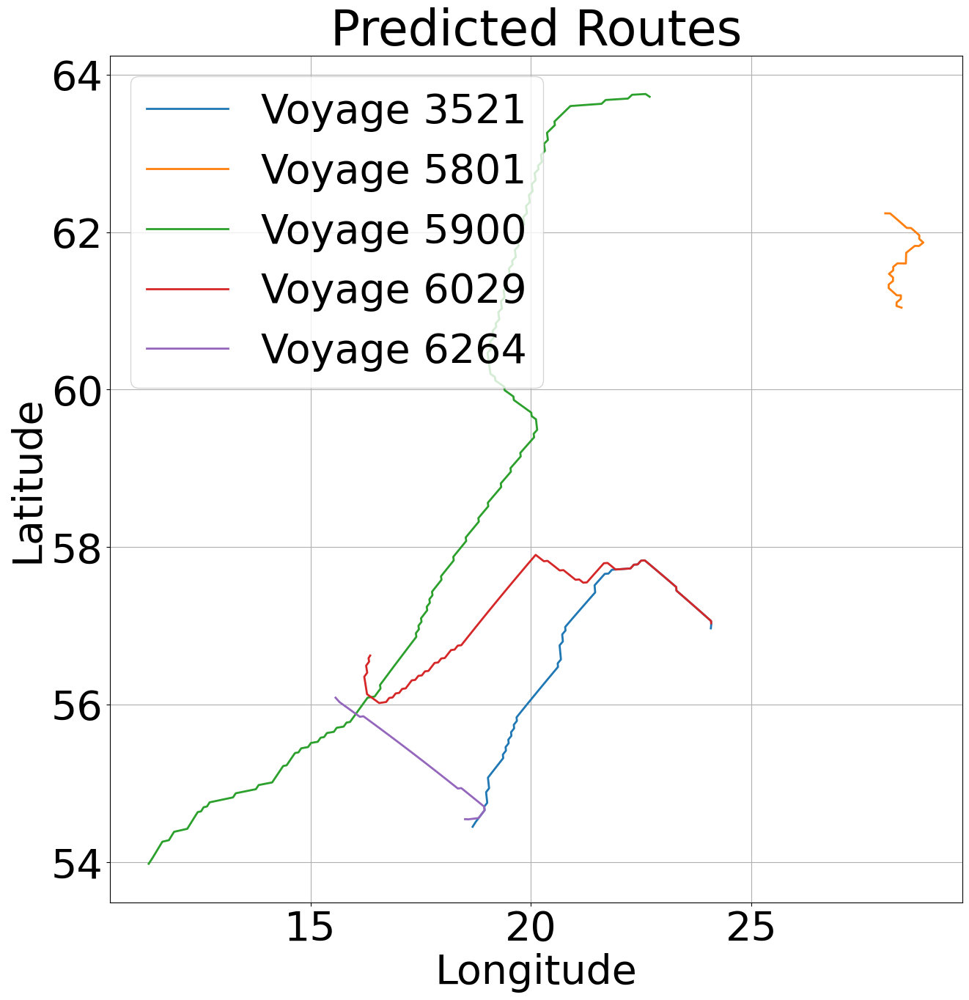

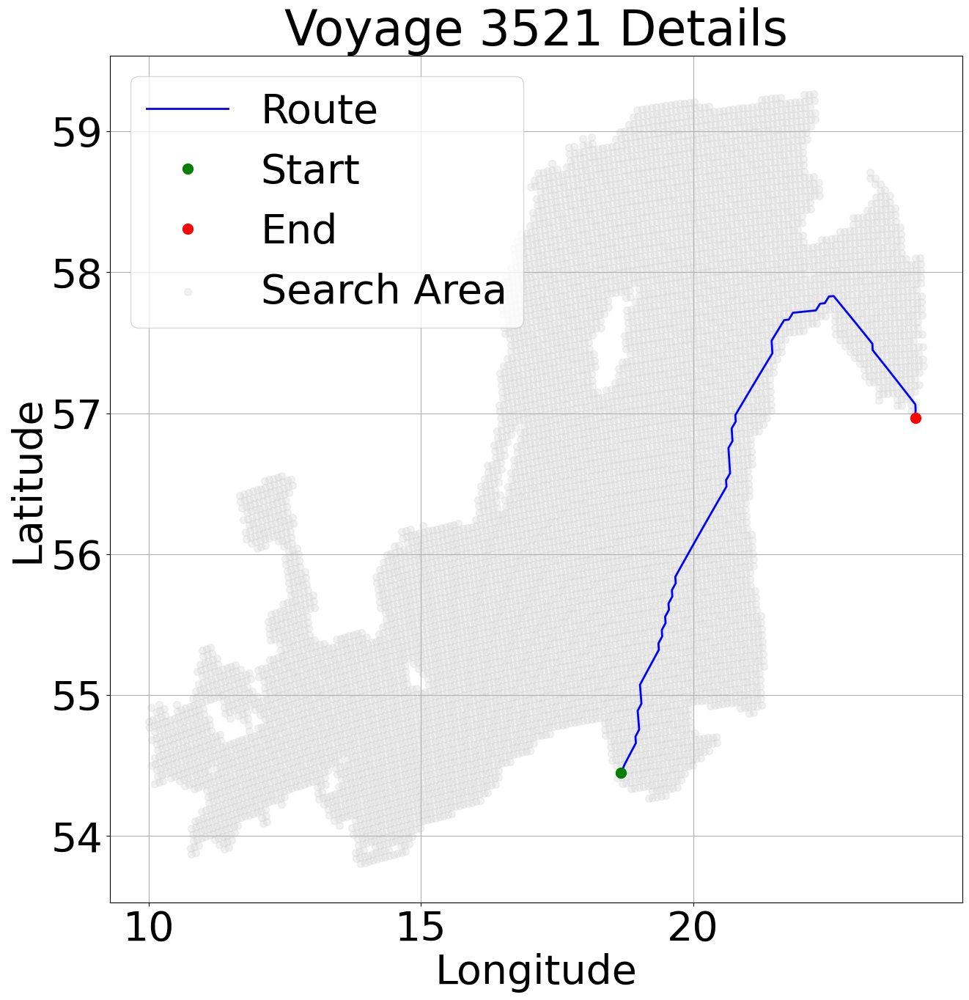

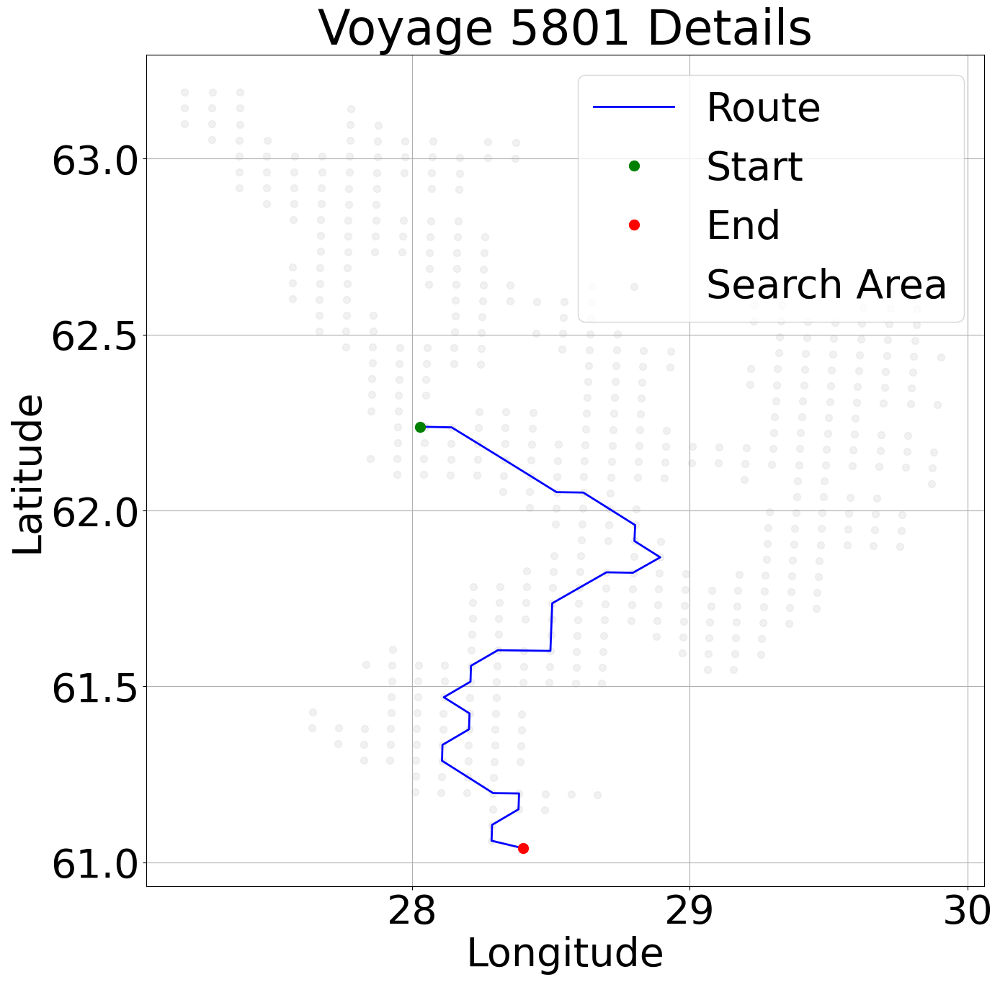

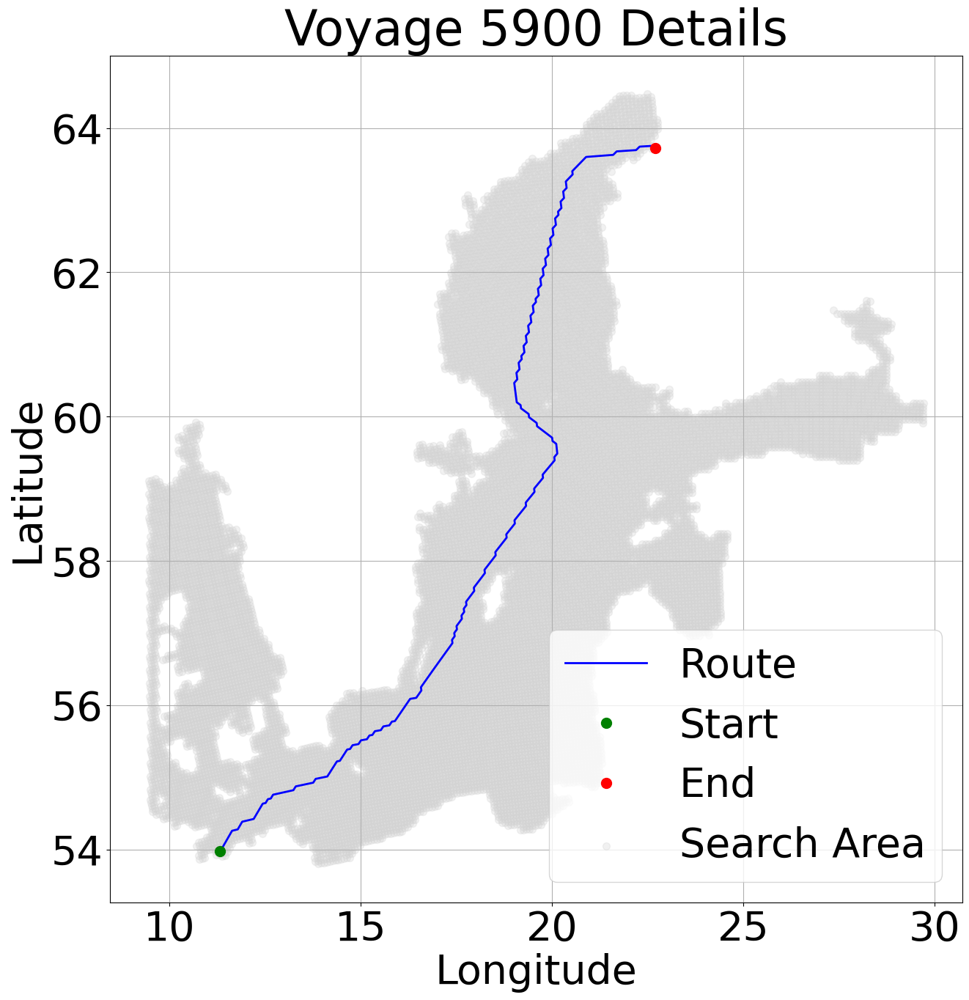

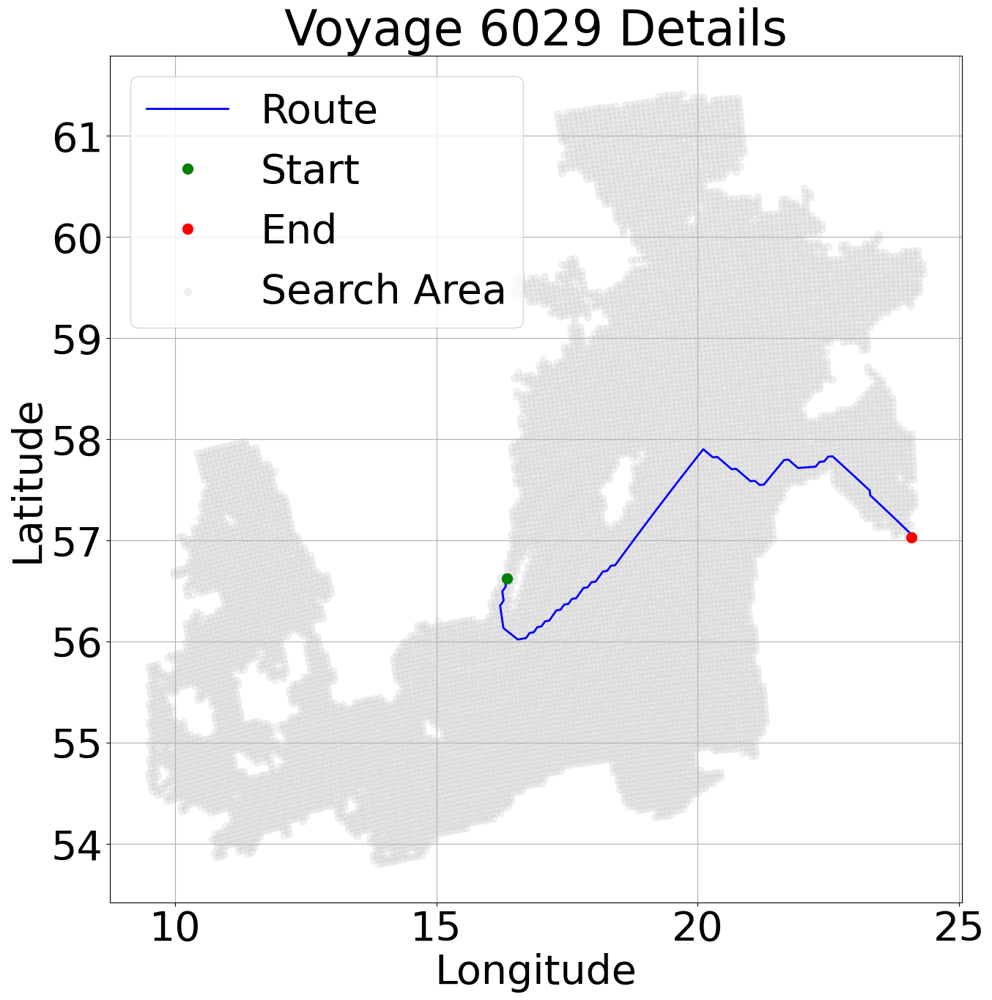

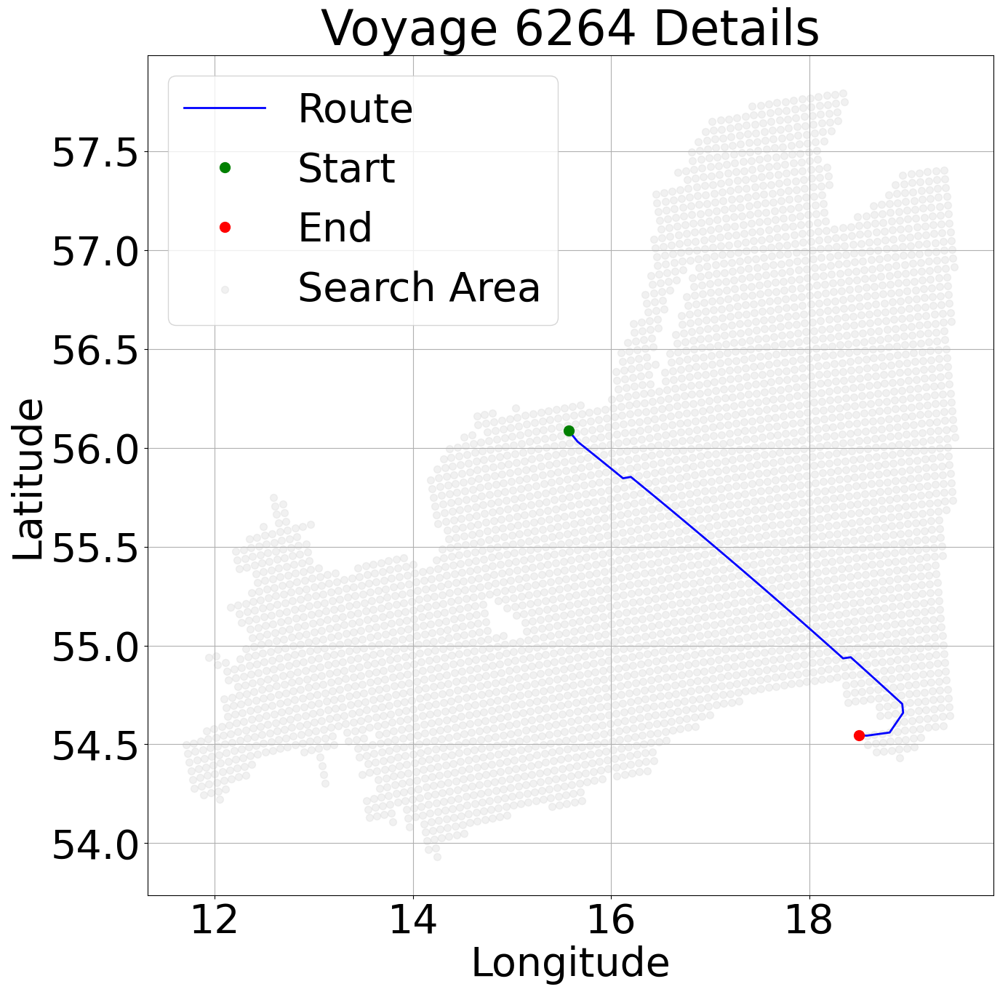


Route Statistics:

Voyage 3521:
Number of points: 99
Average speed: 5.40
Start coordinates: (54.45, 18.68)
End coordinates: (56.97, 24.08)

Voyage 5801:
Number of points: 34
Average speed: 4.91
Start coordinates: (62.24, 28.03)
End coordinates: (61.04, 28.40)

Voyage 5900:
Number of points: 251
Average speed: 5.83
Start coordinates: (53.98, 11.33)
End coordinates: (63.72, 22.69)

Voyage 6029:
Number of points: 111
Average speed: 5.61
Start coordinates: (56.62, 16.35)
End coordinates: (57.03, 24.08)

Voyage 6264:
Number of points: 46
Average speed: 8.54
Start coordinates: (56.09, 15.57)
End coordinates: (54.55, 18.51)


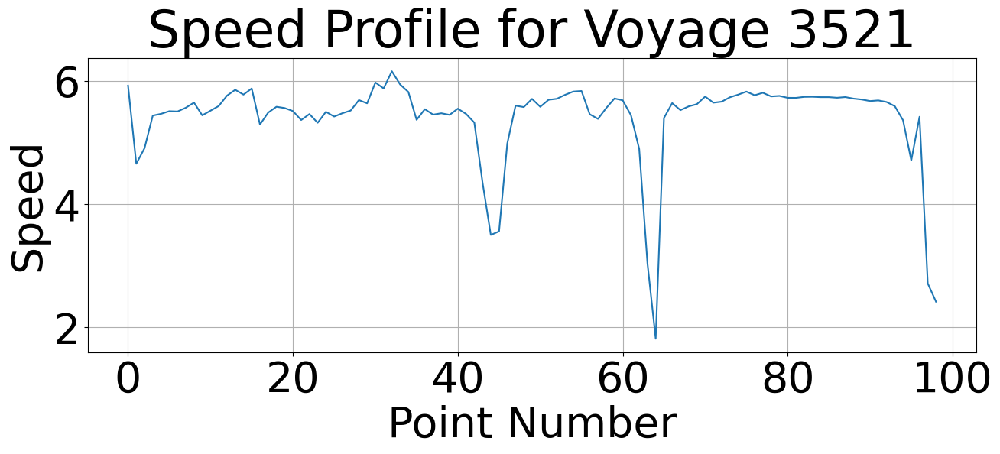

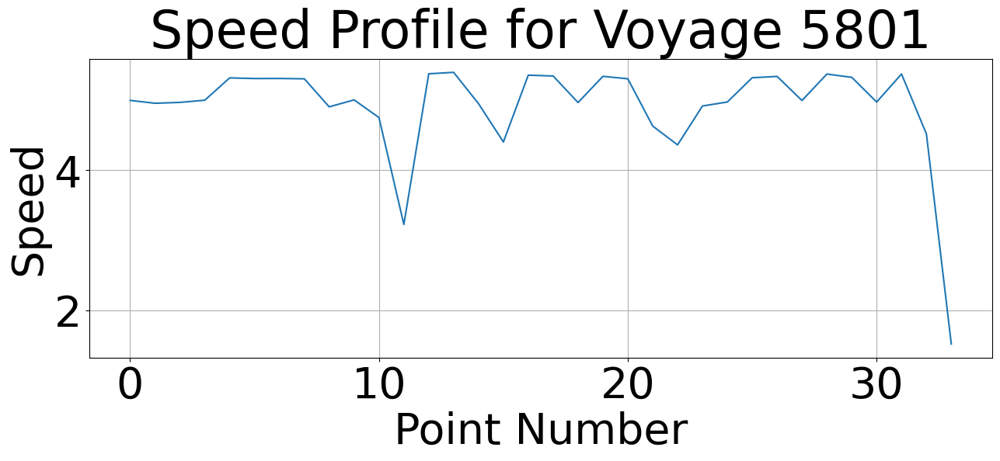

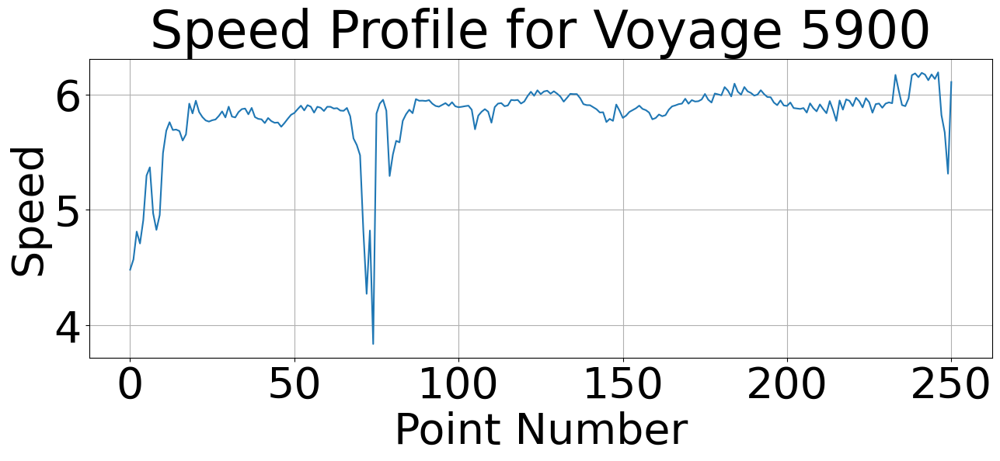

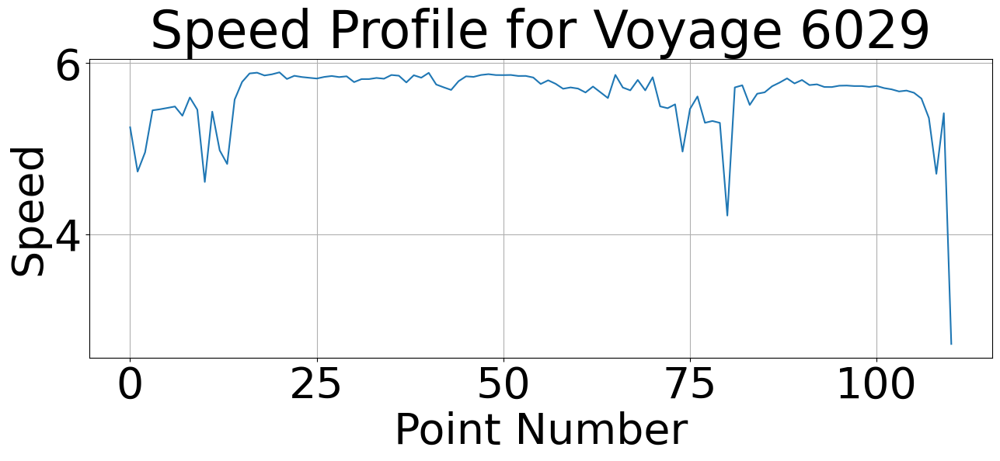

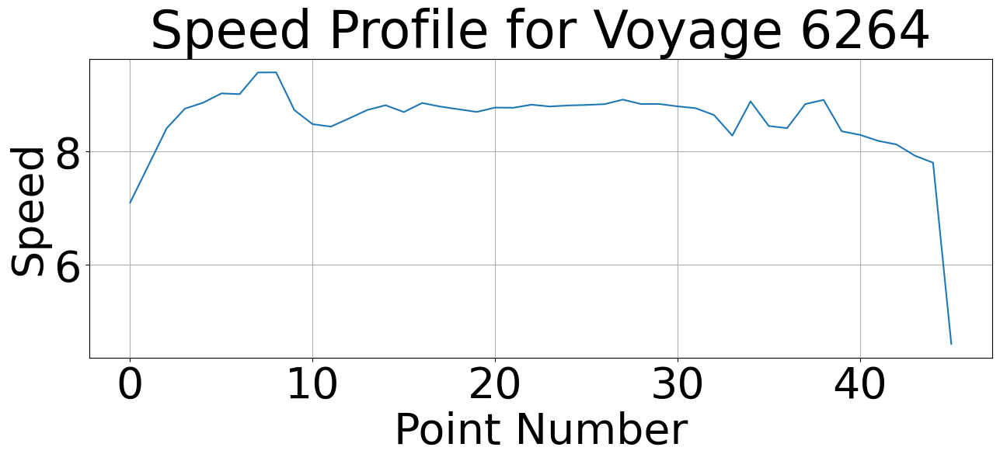

In [21]:
# 1. First, let's look at the data structure
print("Routes DataFrame head:")
print(routes_adjacent_5km.head())
print("\nUnique voyages:", routes_adjacent_5km['voyage'].unique())

# 2. Basic plot of all routes
import matplotlib.pyplot as plt
plt.figure(figsize=(15,15))

# Plot each voyage in a different color
for voyage_id in routes_adjacent_5km['voyage'].unique():
    voyage_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    plt.plot(voyage_data['lon'], voyage_data['lat'], 
             label=f'Voyage {voyage_id}',
             linewidth=2)

plt.grid(True)
plt.legend()
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Predicted Routes')
plt.show()

# 3. Detailed view of a single voyage
def plot_single_voyage(voyage_id):
    voyage_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    
    plt.figure(figsize=(15,15))
    
    # Plot route
    plt.plot(voyage_data['lon'], voyage_data['lat'], 
             'b-', linewidth=2, label='Route')
    
    # Plot start point
    plt.plot(voyage_data.iloc[0]['lon'], voyage_data.iloc[0]['lat'], 
             'go', markersize=10, label='Start')
    
    # Plot end point
    plt.plot(voyage_data.iloc[-1]['lon'], voyage_data.iloc[-1]['lat'], 
             'ro', markersize=10, label='End')
    
    # Plot search area if available
    search_area = areas_adjacent_5km[areas_adjacent_5km['voyage'] == voyage_id]
    if not search_area.empty:
        plt.scatter(search_area['lon'], search_area['lat'], 
                   c='lightgray', alpha=0.3, s=50, label='Search Area')
    
    plt.grid(True)
    plt.legend()
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(f'Voyage {voyage_id} Details')
    plt.show()

# Plot details for each voyage
for voyage_id in routes_adjacent_5km['voyage'].unique():
    plot_single_voyage(voyage_id)

# 4. Print route statistics
print("\nRoute Statistics:")
for voyage_id in routes_adjacent_5km['voyage'].unique():
    voyage_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    print(f"\nVoyage {voyage_id}:")
    print(f"Number of points: {len(voyage_data)}")
    print(f"Average speed: {voyage_data['speed'].mean():.2f}")
    print(f"Start coordinates: ({voyage_data.iloc[0]['lat']:.2f}, {voyage_data.iloc[0]['lon']:.2f})")
    print(f"End coordinates: ({voyage_data.iloc[-1]['lat']:.2f}, {voyage_data.iloc[-1]['lon']:.2f})")

# 5. Speed profile along route
def plot_speed_profile(voyage_id):
    voyage_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    
    plt.figure(figsize=(15,5))
    plt.plot(range(len(voyage_data)), voyage_data['speed'])
    plt.xlabel('Point Number')
    plt.ylabel('Speed')
    plt.title(f'Speed Profile for Voyage {voyage_id}')
    plt.grid(True)
    plt.show()

# Plot speed profiles
for voyage_id in routes_adjacent_5km['voyage'].unique():
    plot_speed_profile(voyage_id)

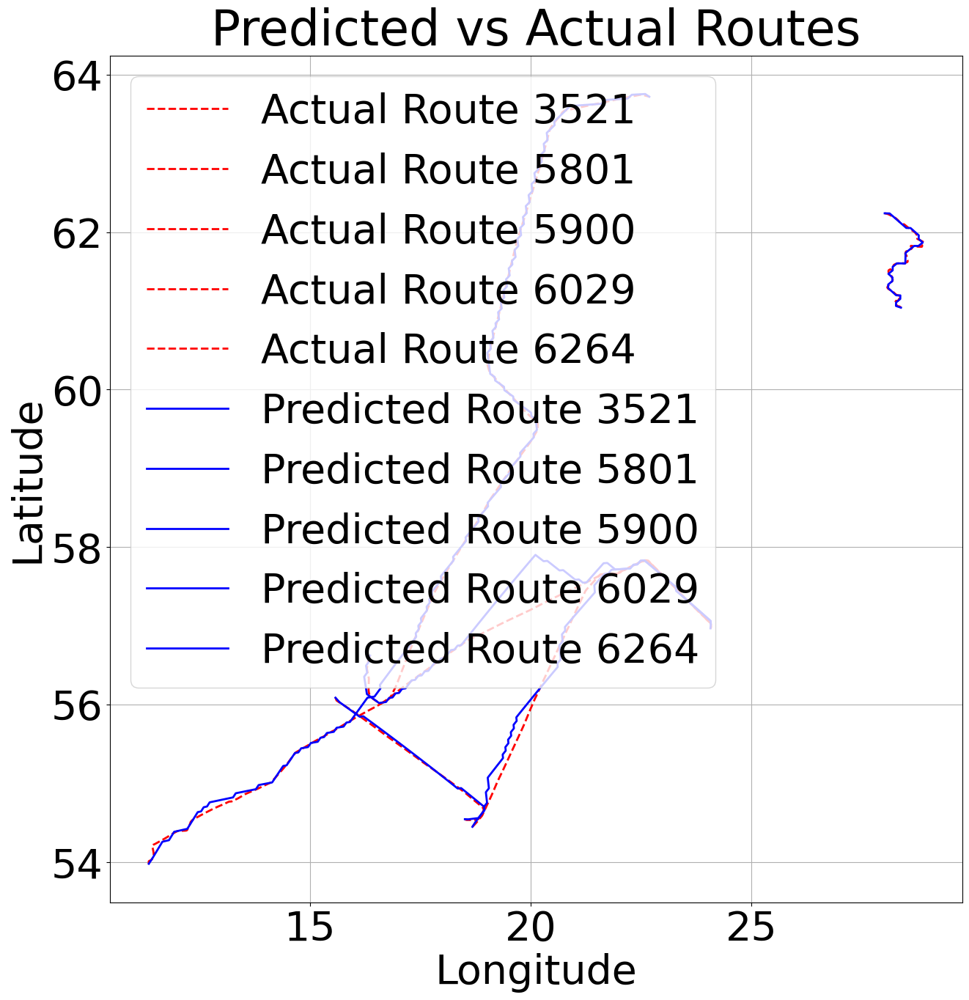

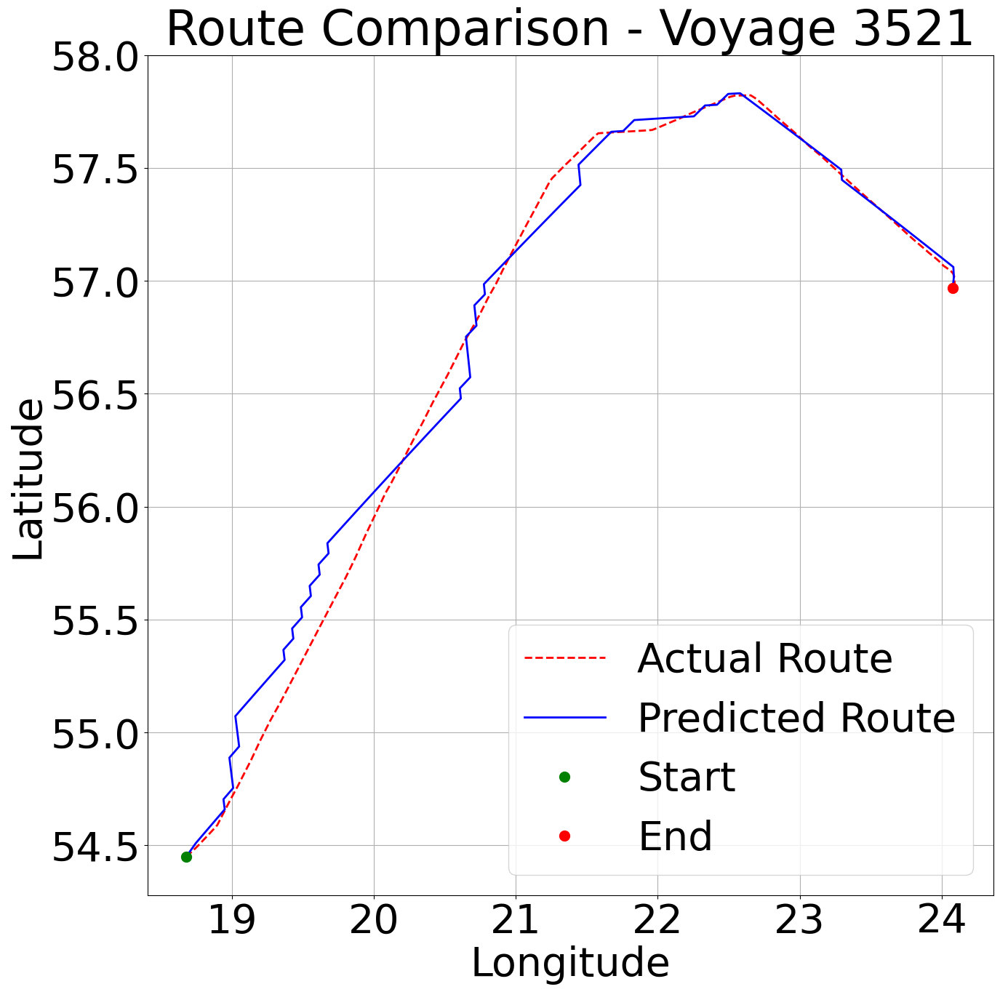

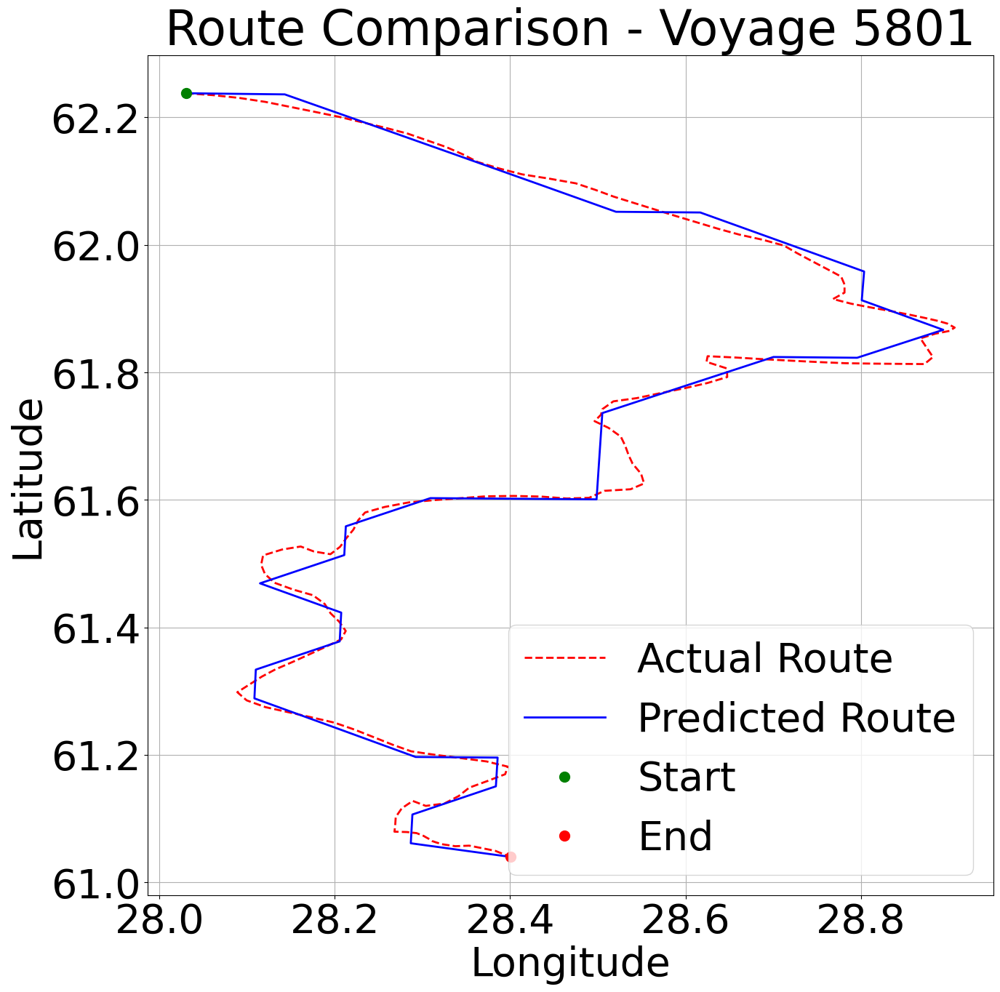

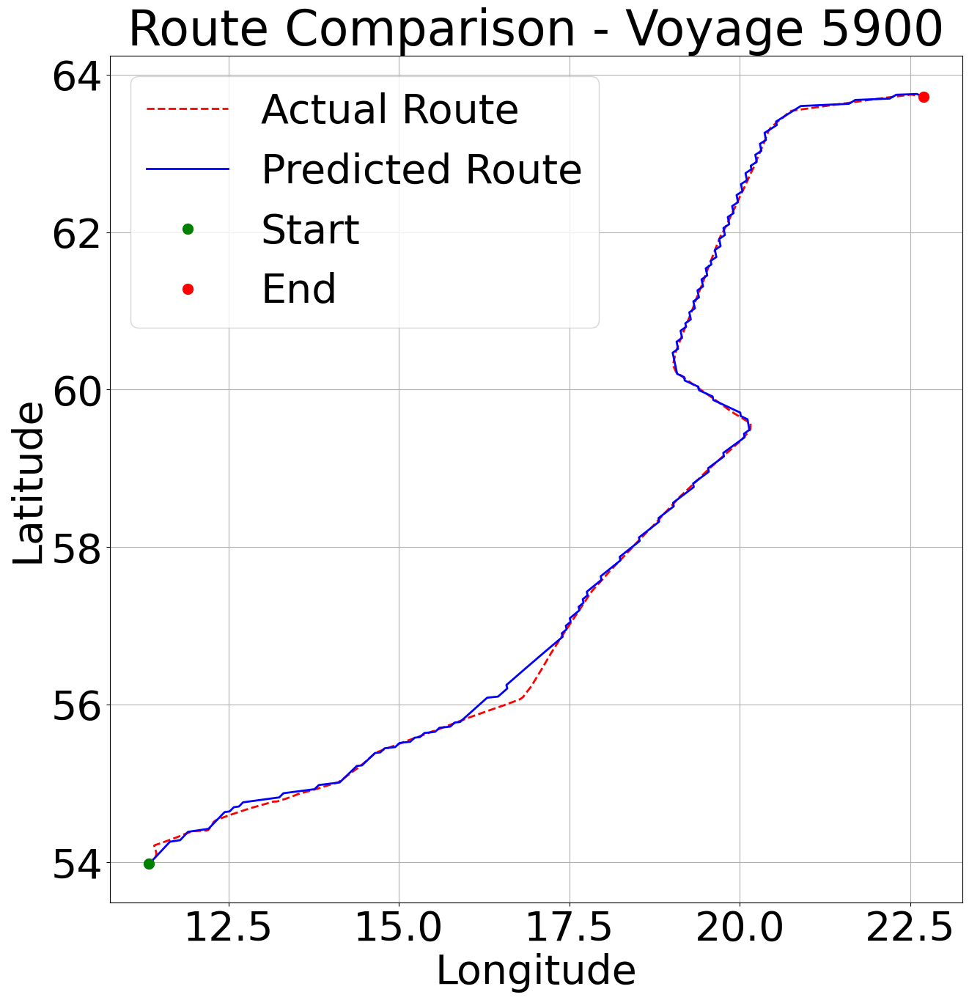

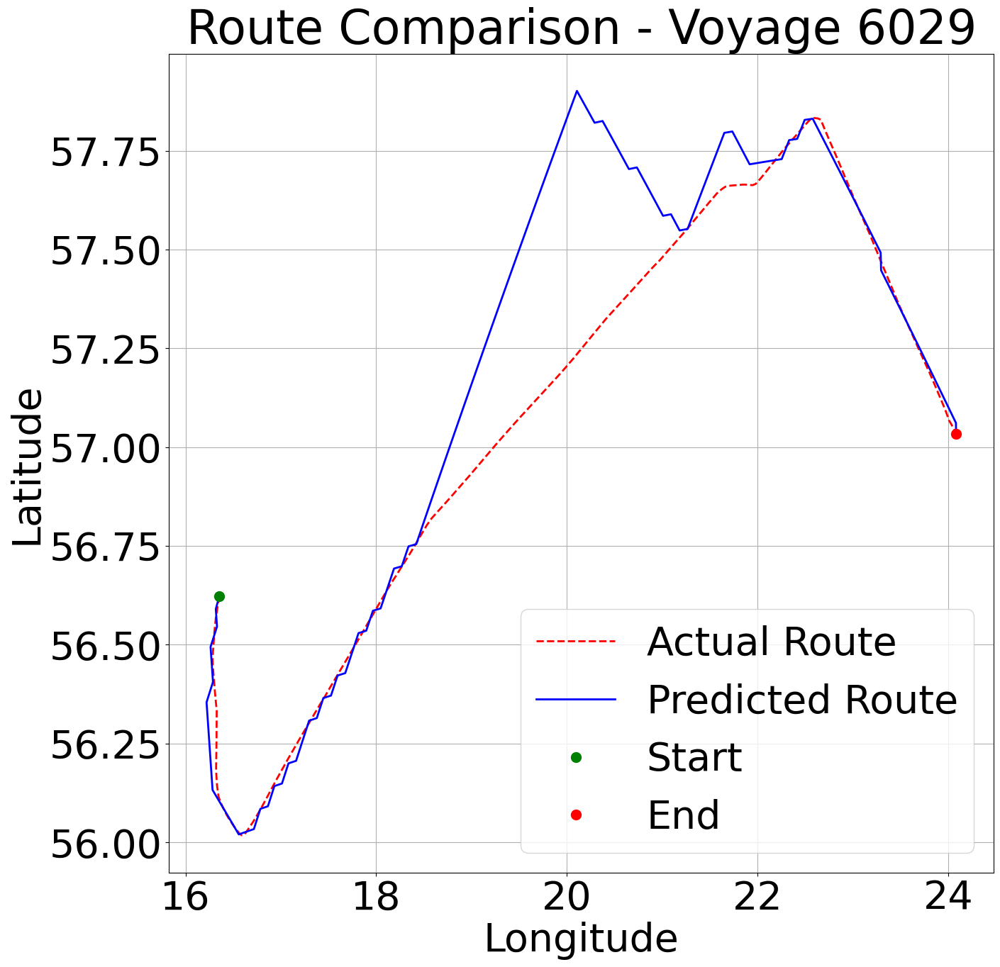

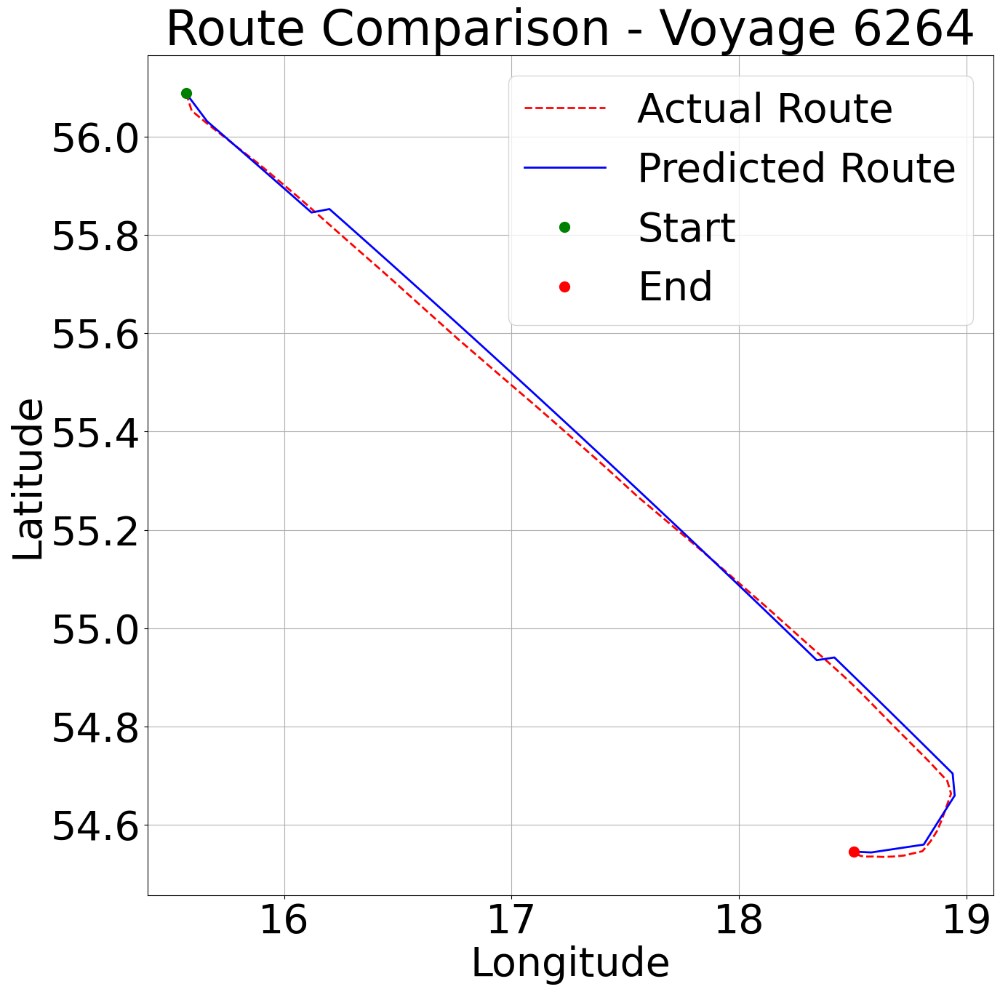

In [22]:
# Compare predicted vs actual routes
plt.figure(figsize=(15,15))

# Plot actual routes
for voyage_id in routes_adjacent_5km['voyage'].unique():
    actual_data = test_voyages[test_voyages['voyage'] == voyage_id]
    plt.plot(actual_data['lon'], actual_data['lat'], 
             '--', color='red', linewidth=2, 
             label=f'Actual Route {voyage_id}')

# Plot predicted routes
for voyage_id in routes_adjacent_5km['voyage'].unique():
    predicted_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    plt.plot(predicted_data['lon'], predicted_data['lat'], 
             '-', color='blue', linewidth=2, 
             label=f'Predicted Route {voyage_id}')

plt.grid(True)
plt.legend()
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Predicted vs Actual Routes')
plt.show()

# Detailed comparison for each voyage
def plot_route_comparison(voyage_id):
    plt.figure(figsize=(15,15))
    
    # Plot actual route
    actual_data = test_voyages[test_voyages['voyage'] == voyage_id]
    plt.plot(actual_data['lon'], actual_data['lat'], 
             '--r', linewidth=2, label='Actual Route')
    
    # Plot predicted route
    predicted_data = routes_adjacent_5km[routes_adjacent_5km['voyage'] == voyage_id]
    plt.plot(predicted_data['lon'], predicted_data['lat'], 
             '-b', linewidth=2, label='Predicted Route')
    
    # Plot start/end points
    plt.plot(actual_data.iloc[0]['lon'], actual_data.iloc[0]['lat'], 
             'go', markersize=10, label='Start')
    plt.plot(actual_data.iloc[-1]['lon'], actual_data.iloc[-1]['lat'], 
             'ro', markersize=10, label='End')
    
    plt.grid(True)
    plt.legend()
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(f'Route Comparison - Voyage {voyage_id}')
    plt.show()

# Show comparison for each voyage
for voyage_id in routes_adjacent_5km['voyage'].unique():
    plot_route_comparison(voyage_id)

### Now mark ports as closed --> Reroute Ships

In [70]:
def close_ports(graph_df, closed_port_coordinates, radius_km=50): # determines how large of a radius to block out around closed ports 
    '''
    Remove nodes from graph that are within radius_km of closed ports

    Parameters:
    graph_df: DataFrame with 'original', 'connected', 'cost' columns
    closed_port_coordinates: List of (lat, lon) tuples for closed ports
    radius_km: Radius around port to close (in kilometers)
    '''

    from geopy.distance import geodesic 
    from pygradu.shortest_path import Graph

    # Get all unique nodes
    nodes = set(graph_df['original'].unique()) | set(graph_df['connected'].unique())
    
    # Instead of grid_5km.head(), we should do:
    print("Grid properties:")
    print(f"type of grid_5km: {type(grid_5km)}")
    print(f"Side length: {grid_5km.side_length}")
    print(f"Number of columns: {len(grid_5km.cols)}")
    print(f"Number of rows: {len(grid_5km.rows)}")
    # Or use the built-in method:
    grid_5km.print_parameters()

    # Create dictionary mapping each node to its coordinates using correct method
    print(f"Extracting coords into node_coords dict:")
    node_coords = {node: grid_5km.extract_coords_lat_lon(node) for node in nodes}

    # Test if the method works as expected
    test_node = list(nodes)[0]  # Get first node
    try:
        coords = grid_5km.extract_coords_lat_lon(test_node)
        print(f"Test node {test_node} coordinates:", coords)
    except Exception as e:
        print(f"Error testing extract_coords_lat_lon: {e}")

    # Find nodes to remove (those within radius of closed ports)
    print(f"Finding nodes to remove:")
    nodes_to_remove = set()
    for port_lat, port_lon in closed_port_coordinates:
        port_coords = (port_lat, port_lon)
        for node, (node_lat, node_lon) in node_coords.items():
            distance = geodesic(port_coords, (node_lat, node_lon)).kilometers
            if distance <= radius_km:
                nodes_to_remove.add(node)

    # Remove edges that include closed nodes
    print(f"Removing edges that include closed nodes:")
    modified_graph_df = graph_df[ # remove all edges that involve closed ports
        ~(graph_df['original'].isin(nodes_to_remove) | graph_df['connected'].isin(nodes_to_remove)) # any node that should be removed | remove any edges connected to a removed node is removed
    ].copy()

    # # Create new Graph object with the modified edges
    # modified_graph = Graph()
    # # Set standard graph properties
    # modified_graph.use_turn_penalty = False
    # modified_graph.use_shallow_penalty = True
    # modified_graph.use_dirways = False
    # # Add the modified DataFrame
    # modified_graph.df = modified_graph_df

    # Instead of creating a new Graph object, modify the DataFrame to match expected format
    if 'print_parameters' not in modified_graph_df:
        modified_graph_df.print_parameters = lambda: None

    # Convert DataFrame to proper Graph object using existing function
    modified_graph = shortest_path.df_to_graph(modified_graph_df)

    # Explicitly set dirways to False
    modified_graph.use_dirways = False
    modified_graph.use_turn_penalty = False
    modified_graph.use_shallow_penalty = True

    return modified_graph

Top 10 most used points on routes:
Point 255: (57.276396, 23.648316) - Used by 2.0 voyages
Point 23: (54.559748, 18.812619) - Used by 2.0 voyages
Point 25: (54.609686, 18.880640) - Used by 2.0 voyages
Point 238: (57.061343, 24.082506) - Used by 2.0 voyages
Point 28: (54.659592, 18.948827) - Used by 2.0 voyages
Point 30: (54.704317, 18.939912) - Used by 2.0 voyages
Point 283: (57.577418, 23.115794) - Used by 2.0 voyages
Point 290: (57.619850, 23.027006) - Used by 2.0 voyages
Point 296: (57.662216, 22.938010) - Used by 2.0 voyages
Point 303: (57.704516, 22.848808) - Used by 2.0 voyages


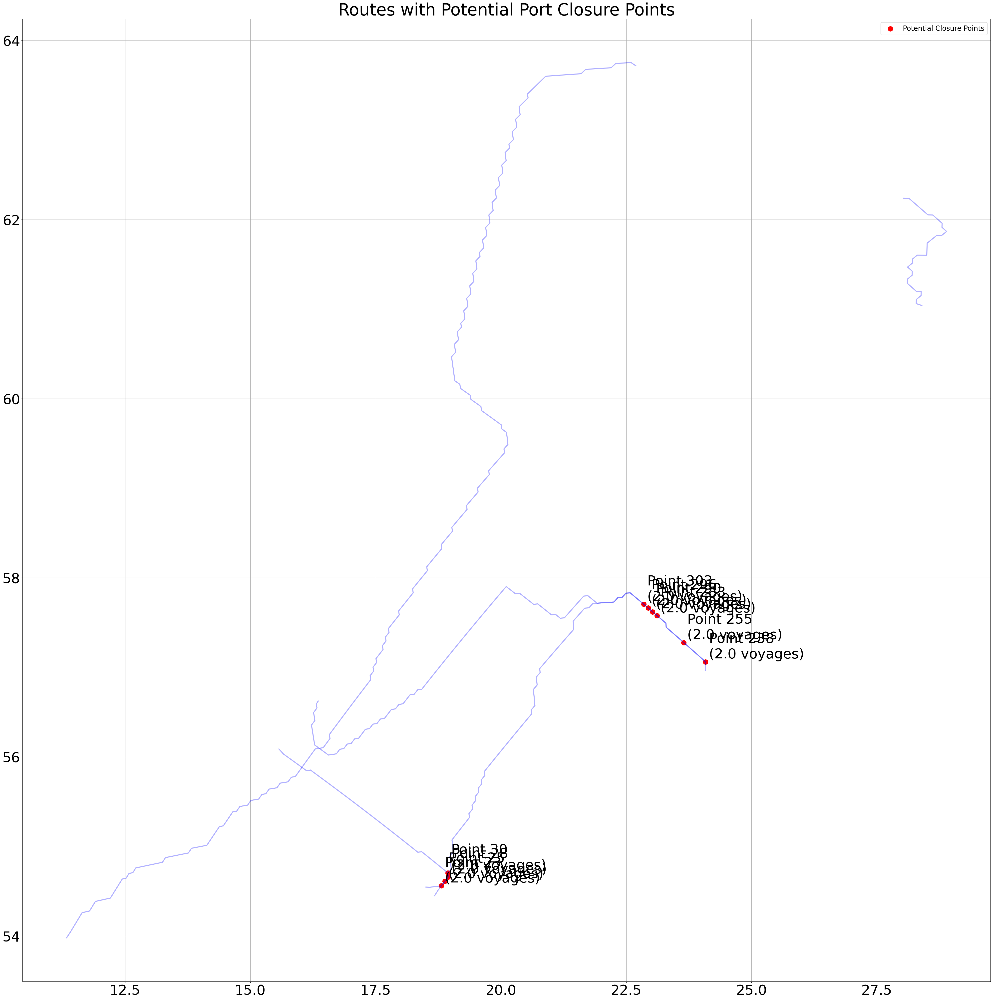

In [71]:
def find_ports_on_routes(routes_df, grid_size_km=5):
    """
    Find potential ports (points) along routes that would be good candidates for closure
    
    Parameters:
    routes_df: DataFrame with 'lat', 'lon', 'voyage' columns
    grid_size_km: Size of grid cell to consider as "same location" (default 5km)
    """
    from geopy.distance import geodesic
    
    # Get unique points along routes with count of voyages using them
    route_points = routes_df.groupby(['lat', 'lon']).agg({
        'voyage': 'nunique'  # Count unique voyages using this point
    }).reset_index()
    
    # Rename for clarity
    route_points.columns = ['lat', 'lon', 'num_voyages']
    
    # Sort by number of voyages (most used points first)
    route_points = route_points.sort_values('num_voyages', ascending=False)
    
    print("Top 10 most used points on routes:")
    for i, row in route_points.head(10).iterrows():
        print(f"Point {i+1}: ({row['lat']:.6f}, {row['lon']:.6f}) - Used by {row['num_voyages']} voyages")
    
    return route_points

# Use the function
busy_points = find_ports_on_routes(routes_adjacent_5km)

# Visualize these points on the route map
plt.figure(figsize=(50, 50))
plt.title("Routes with Potential Port Closure Points")

# Plot routes
for voyage, route in routes_adjacent_5km.groupby('voyage'):
    plt.plot(route['lon'], route['lat'], 'b-', alpha=0.3, linewidth=3)

# Plot top 10 busiest points
top_10_points = busy_points.head(10)
plt.scatter(top_10_points['lon'], top_10_points['lat'], 
           c='red', s=200, label='Potential Closure Points')

# Add point labels
for i, row in top_10_points.iterrows():
    plt.annotate(f"Point {i+1}\n({row['num_voyages']} voyages)", 
                (row['lon'], row['lat']),
                xytext=(10, 10), textcoords='offset points')

plt.grid(True)
plt.legend(fontsize=20)
plt.show()

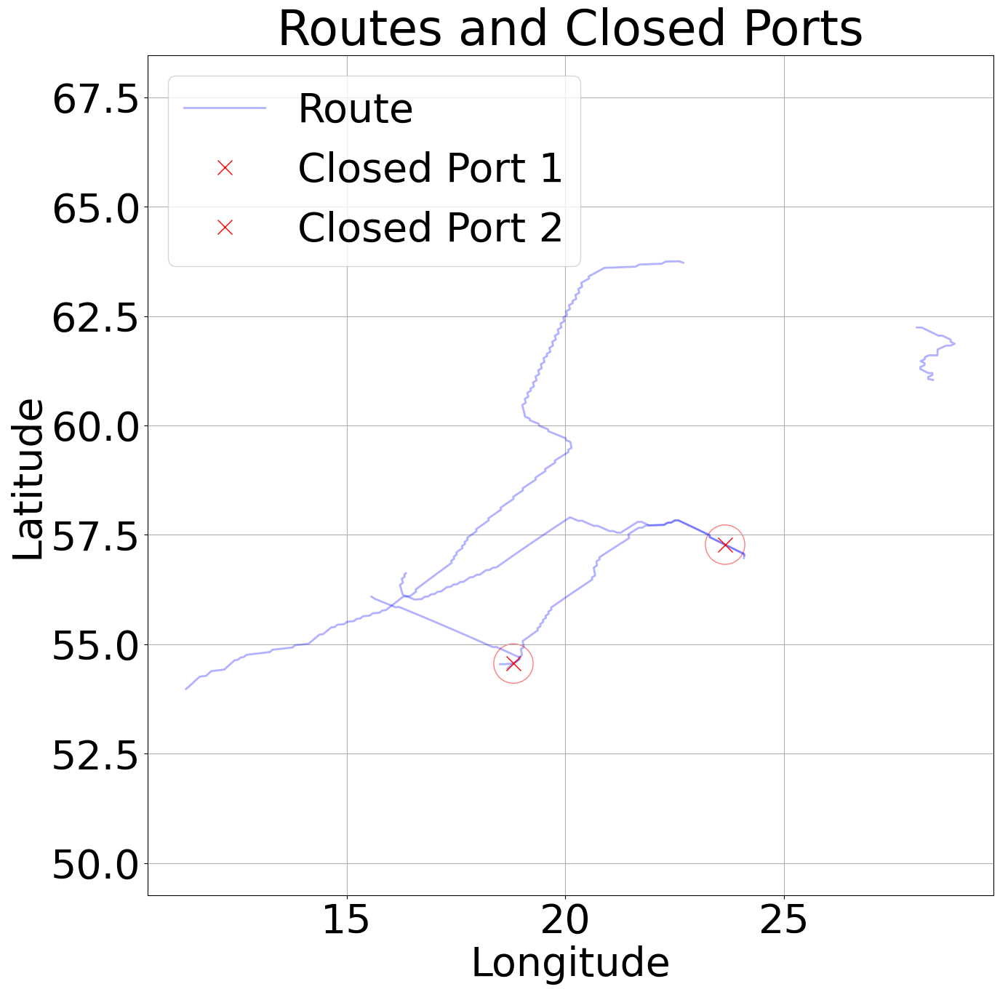


Visualization Guide:
- Blue lines: Ship routes
- Red X's: Closed ports
- Red circles: 5km radius around closed ports

If red circles intersect blue lines, those routes should be affected by port closures.

Closed Port Coordinates:
Port 1:
  Latitude:  57.276396°N
  Longitude: 23.648316°E
  Human readable: Approximately 57.3°N, 23.6°E

Port 2:
  Latitude:  54.559748°N
  Longitude: 18.812619°E
  Human readable: Approximately 54.6°N, 18.8°E

Type of graph_df_adj_5km: <class 'pandas.core.frame.DataFrame'>

Attributes and methods of graph_df_adj_5km:
['T', '_AXIS_LEN', '_AXIS_ORDERS', '_AXIS_TO_AXIS_NUMBER', '_HANDLED_TYPES', '__abs__', '__add__', '__and__', '__annotations__', '__array__', '__array_priority__', '__array_ufunc__', '__arrow_c_stream__', '__bool__', '__class__', '__contains__', '__copy__', '__dataframe__', '__dataframe_consortium_standard__', '__deepcopy__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__divmod__', '__doc__', '__eq__', '__finalize__', '__floordiv__',

/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Test node 350 coordinates: [53.80181320613664, 13.89611408033595]
Finding nodes to remove:
Removing edges that include closed nodes:
Grid properties:
type of grid_5km: <class 'pygradu.gridify.Grid'>
Side length: 5000
Number of columns: 286
Number of rows: 276
side_length: 5000
Extracting coords into node_coords dict:
Test node 350 coordinates: [53.80181320613664, 13.89611408033595]
Finding nodes to remove:
Removing edges that include closed nodes:
Running predictions with modified graphs:
Path does not exist!
Voyage= 3521


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:140: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return pyproj.transform(self.p_from, self.p_to, lon, lat)
/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Path does not exist!
Voyage= 6029
Path does not exist!
Voyage= 6264
finished prediction on modified graphs!
plotting comparison for Route Comparison: Original vs Modified (Closed Ports)


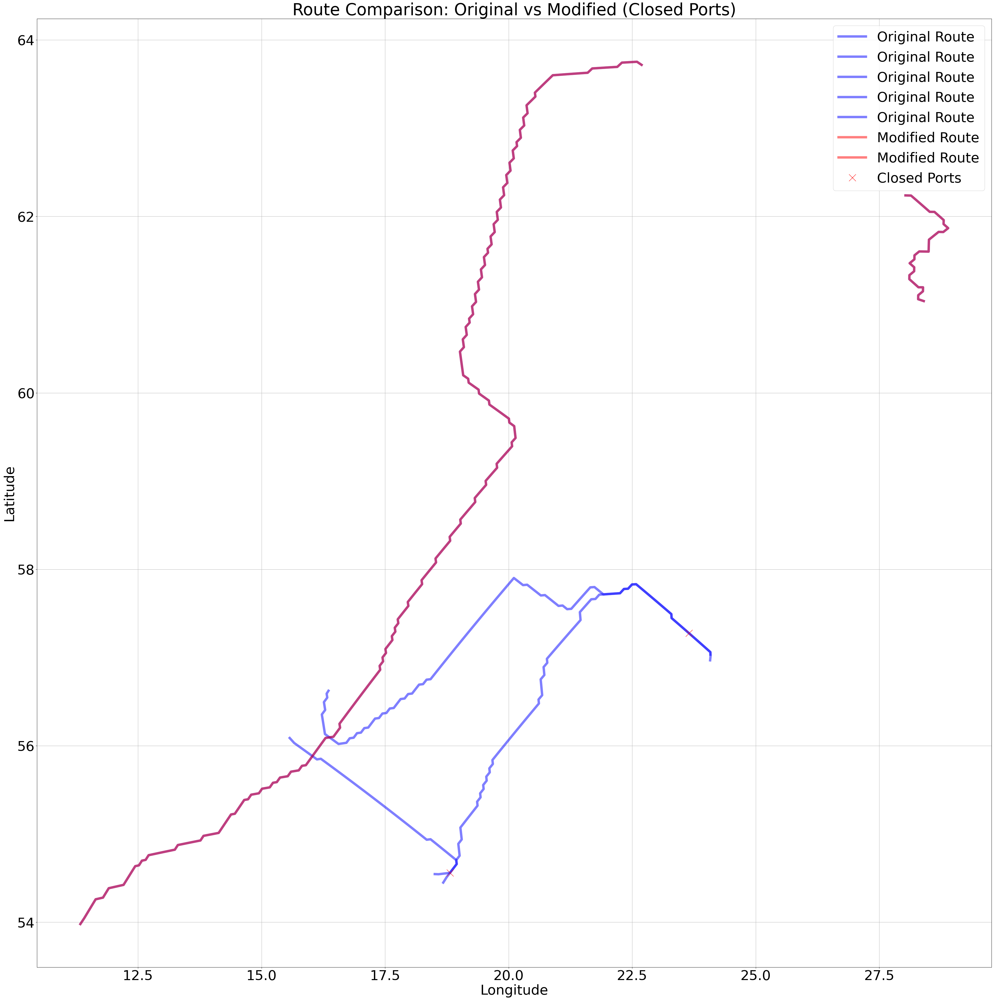

In [72]:
# Use the top 2 most-used points as closed ports
closed_ports = [
    (busy_points.iloc[0][['lat', 'lon']].values),
    (busy_points.iloc[1][['lat', 'lon']].values)
]

import matplotlib.pyplot as plt

def plot_route_area():
    plt.figure(figsize=(15, 15))
    
    # Plot all routes in blue
    for voyage, route in routes_adjacent_5km.groupby('voyage'):
        plt.plot(route['lon'], route['lat'], 'b-', alpha=0.3, linewidth=2, label='Route' if voyage == routes_adjacent_5km['voyage'].iloc[0] else "")
    
    # Plot closed ports as red X's
    radius_km = 50 # determines how large of a radius to block out around closed ports --> only for visualization purposes, actual rerouting logic radius is in close_ports() function
    for i, (lat, lon) in enumerate(closed_ports):
        plt.plot(lon, lat, 'rx', markersize=15, label=f'Closed Port {i+1}')
        # Add a circle to show 5km radius around port
        circle = plt.Circle((lon, lat), radius=radius_km/111, color='r', fill=False, alpha=0.5)  # 1 degree ≈ 111km
        plt.gca().add_artist(circle)
    
    # Add grid for better reference
    plt.grid(True)
    
    # Add title and labels
    plt.title('Routes and Closed Ports')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    
    # Add legend
    plt.legend()
    
    # Make sure the aspect ratio is equal
    plt.axis('equal')
    
    plt.show()

    # Print some helpful context
    print("\nVisualization Guide:")
    print("- Blue lines: Ship routes")
    print("- Red X's: Closed ports")
    print("- Red circles: 5km radius around closed ports")
    print("\nIf red circles intersect blue lines, those routes should be affected by port closures.")

# First show the visualization
plot_route_area()

# Then print the closed port coordinates in a readable format
print("\nClosed Port Coordinates:")
for i, (lat, lon) in enumerate(closed_ports):
    print(f"Port {i+1}:")
    print(f"  Latitude:  {lat:.6f}°N")
    print(f"  Longitude: {lon:.6f}°E")
    print(f"  Human readable: Approximately {lat:.1f}°N, {lon:.1f}°E")
    print()

print("Type of graph_df_adj_5km:", type(graph_df_adj_5km))
print("\nAttributes and methods of graph_df_adj_5km:")
print(dir(graph_df_adj_5km))

# Create modified graphs
graph_adj_5km_modified = close_ports(graph_df_adj_5km, closed_ports)
graph_ship_5km_modified = close_ports(graph_df_ship_5km, closed_ports)

# Run predictions with modified graphs
print(f"Running predictions with modified graphs:")
routes_and_areas = shortest_path.predict_routes(
    summer_test_voyages.tail(5), 
    grid_5km, 
    graph_adj_5km_modified,  # Use modified graph
    speed_model_5km, 
    None, 
    shallow_graph_5km,
    print_params=False  # Skip the parameter printing
)

print(f"finished prediction on modified graphs!")

# Compare original vs modified routes
routes_modified = pd.DataFrame(
    data=routes_and_areas[0],
    columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number']
)
areas_modified = pd.DataFrame(
    data=routes_and_areas[0],
    columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number']
)
areas_modified = pd.DataFrame(
    data=routes_and_areas[1],
    columns=['lat', 'lon', 'voyage', 'g', 'h', 'f']
)

# Plot both original and modified routes
def plot_comparison(original_routes, modified_routes, test_voyages, title):
    print(f"plotting comparison for {title}")
    plt.figure(figsize=(50, 50))
    plt.title(title)

    # Plot original routes
    for voyage, route in original_routes.groupby('voyage'):
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')],
                 'b-', alpha=0.5, linewidth=7, label='Original Route')
        
    # Plot modified routes
    for voyage, route in modified_routes.groupby('voyage'):
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')],
                 'r-', alpha=0.5, linewidth=7, label='Modified Route')
        
    # Plot closed ports
    closed_lats, closed_lons = zip(*closed_ports)
    plt.plot(closed_lons, closed_lats, 'rx', markersize=20, label='Closed Ports')

    plt.grid(True)
    plt.legend()
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

# Plot Comparison
plot_comparison(
    routes_adjacent_5km,
    routes_modified,
    test_voyages,
    'Route Comparison: Original vs Modified (Closed Ports)'
)

/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


KeyboardInterrupt: 

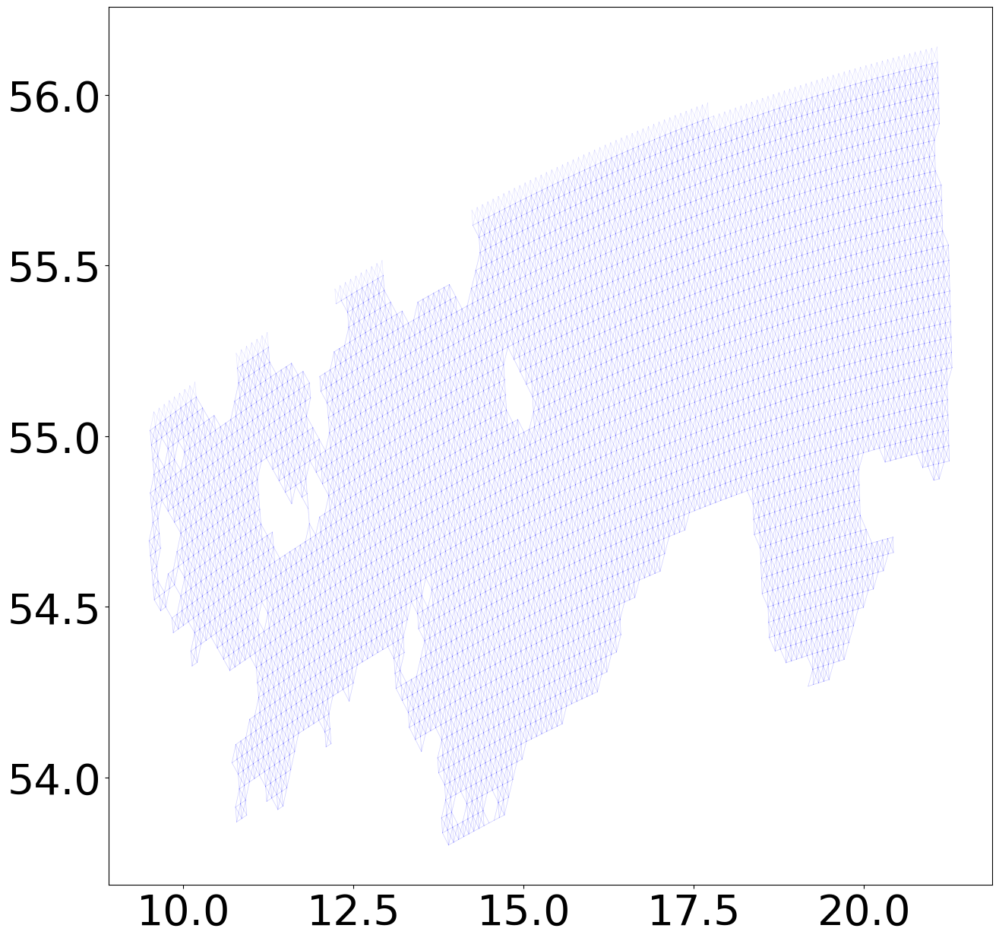

In [74]:
def visualize_graph_connectivity():
    plt.figure(figsize=(15, 15))
    
    # Plot all edges in the original graph
    for _, row in graph_df_adj_5km.iterrows():
        start_coords = grid_5km.extract_coords_lat_lon(row['original'])
        end_coords = grid_5km.extract_coords_lat_lon(row['connected'])
        plt.plot([start_coords[1], end_coords[1]], 
                [start_coords[0], end_coords[0]], 
                'b-', alpha=0.1, linewidth=0.5)
    
    # Plot all edges in the modified graph in a different color
    modified_graph_df = graph_adj_5km_modified.df  # Get the DataFrame from the modified graph
    for _, row in modified_graph_df.iterrows():
        start_coords = grid_5km.extract_coords_lat_lon(row['original'])
        end_coords = grid_5km.extract_coords_lat_lon(row['connected'])
        plt.plot([start_coords[1], end_coords[1]], 
                [start_coords[0], end_coords[0]], 
                'g-', alpha=0.1, linewidth=0.5)
    
    # Plot closed ports and their radius
    radius_km = 50
    for i, (lat, lon) in enumerate(closed_ports):
        plt.plot(lon, lat, 'rx', markersize=15, label=f'Closed Port {i+1}')
        circle = plt.Circle((lon, lat), radius=radius_km/111, color='r', fill=True, alpha=0.2)
        plt.gca().add_artist(circle)
    
    # Plot start/end points of voyages
    for _, voyage in summer_test_voyages.tail(5).iterrows():
        plt.plot(voyage['start_lon'], voyage['start_lat'], 'go', markersize=10, label='Start Point')
        plt.plot(voyage['end_lon'], voyage['end_lat'], 'ro', markersize=10, label='End Point')
    
    plt.grid(True)
    plt.title('Graph Connectivity Visualization')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.legend()
    plt.axis('equal')
    plt.show()

    # Print voyage information
    print("\nVoyage Start/End Points:")
    for _, voyage in summer_test_voyages.tail(5).iterrows():
        print(f"\nVoyage {voyage['mmsi']}:")
        print(f"Start: ({voyage['start_lat']:.2f}°N, {voyage['start_lon']:.2f}°E)")
        print(f"End: ({voyage['end_lat']:.2f}°N, {voyage['end_lon']:.2f}°E)")

visualize_graph_connectivity()

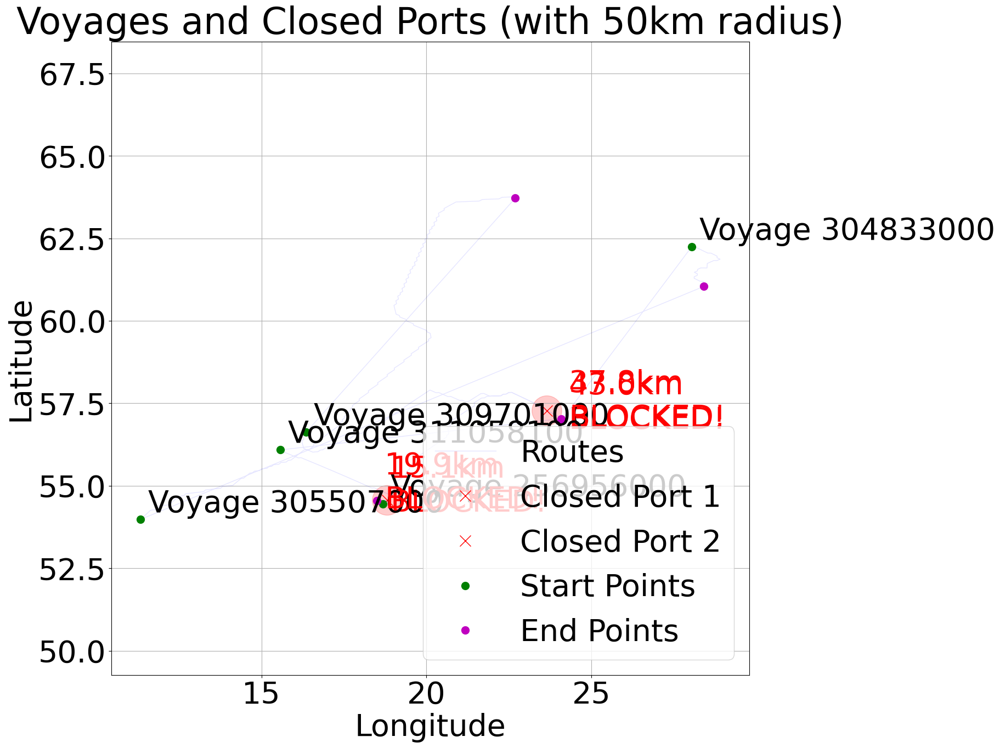


Detailed Distance Information:

Voyage 256956000:
Start: (54.45°N, 18.68°E)
End: (56.97°N, 24.08°E)
Closed Port 1:
  Start point distance: 442.5km 
  End point distance: 43.0km (BLOCKED!)
Closed Port 2:
  Start point distance: 15.1km (BLOCKED!)
  End point distance: 425.4km 

Voyage 304833000:
Start: (62.24°N, 28.03°E)
End: (61.04°N, 28.40°E)
Closed Port 1:
  Start point distance: 604.8km 
  End point distance: 499.4km 
Closed Port 2:
  Start point distance: 1008.8km 
  End point distance: 917.8km 

Voyage 305507000:
Start: (53.98°N, 11.33°E)
End: (63.72°N, 22.69°E)
Closed Port 1:
  Start point distance: 856.6km 
  End point distance: 719.6km 
Closed Port 2:
  Start point distance: 491.3km 
  End point distance: 1043.5km 

Voyage 309701000:
Start: (56.62°N, 16.35°E)
End: (57.03°N, 24.08°E)
Closed Port 1:
  Start point distance: 449.5km 
  End point distance: 37.8km (BLOCKED!)
Closed Port 2:
  Start point distance: 277.1km 
  End point distance: 430.1km 

Voyage 311058100:
Start: (56.0

In [77]:
def visualize_port_distances_fast():
    plt.figure(figsize=(15, 15))
    
    # Plot routes more efficiently
    routes_data = routes_adjacent_5km[['lon', 'lat', 'voyage']]
    plt.plot(routes_data['lon'], routes_data['lat'], 'b-', alpha=0.1, linewidth=1, label='Routes')
    
    # Plot closed ports and their radius
    radius_km = 50
    for i, (lat, lon) in enumerate(closed_ports):
        plt.plot(lon, lat, 'rx', markersize=15, label=f'Closed Port {i+1}')
        circle = plt.Circle((lon, lat), radius=radius_km/111, color='r', fill=True, alpha=0.2)
        plt.gca().add_artist(circle)
    
    # Plot only the test voyages we're analyzing
    test_voyages = summer_test_voyages.tail(5)
    
    # Plot all start points at once (using 'lat' and 'lon' for start)
    plt.plot(test_voyages['lon'], test_voyages['lat'], 'go', markersize=10, label='Start Points')
    
    # Plot all end points at once (using 'end_lat' and 'end_lon' for end)
    plt.plot(test_voyages['end_lon'], test_voyages['end_lat'], 'mo', markersize=10, label='End Points')
    
    # Calculate distances once
    for _, voyage in test_voyages.iterrows():
        # Add voyage ID label
        plt.annotate(f"Voyage {voyage['mmsi']}", 
                    (voyage['lon'], voyage['lat']),
                    xytext=(10, 10), textcoords='offset points')
        
        # Calculate distances for this voyage
        for i, (closed_lat, closed_lon) in enumerate(closed_ports):
            # Check start point distance
            start_distance = geodesic(
                (voyage['lat'], voyage['lon']), 
                (closed_lat, closed_lon)
            ).kilometers
            
            if start_distance <= radius_km:
                plt.annotate(f'{start_distance:.1f}km\nBLOCKED!', 
                            (voyage['lon'], voyage['lat']),
                            xytext=(10, -10), textcoords='offset points',
                            color='red')
            
            # Check end point distance
            end_distance = geodesic(
                (voyage['end_lat'], voyage['end_lon']), 
                (closed_lat, closed_lon)
            ).kilometers
            
            if end_distance <= radius_km:
                plt.annotate(f'{end_distance:.1f}km\nBLOCKED!', 
                            (voyage['end_lon'], voyage['end_lat']),
                            xytext=(10, -10), textcoords='offset points',
                            color='red')
    
    plt.grid(True)
    plt.title(f'Voyages and Closed Ports (with {radius_km}km radius)')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.legend()
    plt.axis('equal')
    plt.show()

    # Print detailed information
    print("\nDetailed Distance Information:")
    for _, voyage in test_voyages.iterrows():
        print(f"\nVoyage {voyage['mmsi']}:")
        print(f"Start: ({voyage['lat']:.2f}°N, {voyage['lon']:.2f}°E)")
        print(f"End: ({voyage['end_lat']:.2f}°N, {voyage['end_lon']:.2f}°E)")
        
        for i, (closed_lat, closed_lon) in enumerate(closed_ports):
            start_distance = geodesic((voyage['lat'], voyage['lon']), (closed_lat, closed_lon)).kilometers
            end_distance = geodesic((voyage['end_lat'], voyage['end_lon']), (closed_lat, closed_lon)).kilometers
            
            print(f"Closed Port {i+1}:")
            print(f"  Start point distance: {start_distance:.1f}km {'(BLOCKED!)' if start_distance <= radius_km else ''}")
            print(f"  End point distance: {end_distance:.1f}km {'(BLOCKED!)' if end_distance <= radius_km else ''}")

# Run the visualization
visualize_port_distances_fast()

In [78]:
def close_ports(graph_df, closed_port_coordinates, voyages, radius_km=50): 
    '''
    Remove nodes from graph that are within radius_km of closed ports, 
    but preserve destination ports
    
    Parameters:
    graph_df: DataFrame with 'original', 'connected', 'cost' columns
    closed_port_coordinates: List of (lat, lon) tuples for closed ports
    voyages: DataFrame containing voyage information with end_lat, end_lon
    radius_km: Radius around port to close (in kilometers)
    '''
    from geopy.distance import geodesic 
    from pygradu.shortest_path import Graph

    # Get all unique nodes
    nodes = set(graph_df['original'].unique()) | set(graph_df['connected'].unique())
    
    # Create dictionary mapping each node to its coordinates
    print(f"Extracting coords into node_coords dict:")
    node_coords = {node: grid_5km.extract_coords_lat_lon(node) for node in nodes}

    # Get destination coordinates
    destination_points = list(zip(voyages['end_lat'], voyages['end_lon']))
    
    # Find nodes to remove
    print(f"Finding nodes to remove (using {radius_km}km radius):")
    nodes_to_remove = set()
    for port_lat, port_lon in closed_port_coordinates:
        port_coords = (port_lat, port_lon)
        
        for node, (node_lat, node_lon) in node_coords.items():
            node_coords_tuple = (node_lat, node_lon)
            
            # Check if node is within radius of closed port
            if geodesic(port_coords, node_coords_tuple).kilometers <= radius_km:
                # Check if this node is needed for any destination
                is_destination_node = False
                for dest_lat, dest_lon in destination_points:
                    dest_coords = (dest_lat, dest_lon)
                    if geodesic(node_coords_tuple, dest_coords).kilometers <= 5:  # within 5km of destination
                        is_destination_node = True
                        break
                
                if not is_destination_node:
                    nodes_to_remove.add(node)

    # Print statistics
    print(f"Total nodes: {len(nodes)}")
    print(f"Nodes to remove: {len(nodes_to_remove)}")
    print(f"Preserved destination nodes: {len(nodes) - len(nodes_to_remove)}")

    # Remove edges that include closed nodes
    print(f"Removing edges that include closed nodes:")
    modified_graph_df = graph_df[
        ~(graph_df['original'].isin(nodes_to_remove) | 
          graph_df['connected'].isin(nodes_to_remove))
    ].copy()

    # Convert DataFrame to proper Graph object
    modified_graph = shortest_path.df_to_graph(modified_graph_df)
    modified_graph.use_dirways = False
    modified_graph.use_turn_penalty = False
    modified_graph.use_shallow_penalty = True
    
    return modified_graph

# Let's also pick a different closed port that's not near any destinations
def find_better_closed_ports(routes_df, voyages, min_distance_km=100):
    """
    Find ports to close that are far enough from all destinations
    """
    from geopy.distance import geodesic
    
    # Get all destination points
    destinations = list(zip(voyages['end_lat'], voyages['end_lon']))
    
    # Find busy points along routes
    route_points = routes_df.groupby(['lat', 'lon']).agg({
        'voyage': 'nunique'
    }).reset_index()
    
    # Sort by number of voyages
    route_points = route_points.sort_values('voyage', ascending=False)
    
    # Find points that are far enough from all destinations
    good_closure_points = []
    for _, point in route_points.iterrows():
        point_coords = (point['lat'], point['lon'])
        
        # Check distance to all destinations
        min_dest_distance = float('inf')
        for dest in destinations:
            dist = geodesic(point_coords, dest).kilometers
            min_dest_distance = min(min_dest_distance, dist)
        
        if min_dest_distance >= min_distance_km:
            good_closure_points.append((point['lat'], point['lon']))
            if len(good_closure_points) >= 2:  # We only need 2 points
                break
    
    return good_closure_points

# Find better ports to close
better_closed_ports = find_better_closed_ports(routes_adjacent_5km, summer_test_voyages.tail(5))
print("\nBetter ports to close (far from destinations):")
for i, (lat, lon) in enumerate(better_closed_ports):
    print(f"Port {i+1}: ({lat:.2f}°N, {lon:.2f}°E)")

# Create modified graphs with better closed ports
graph_adj_5km_modified = close_ports(graph_df_adj_5km, better_closed_ports, summer_test_voyages.tail(5))


Better ports to close (far from destinations):
Port 1: (57.70°N, 22.85°E)
Port 2: (57.72°N, 21.92°E)
Extracting coords into node_coords dict:


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Finding nodes to remove (using 50km radius):
Total nodes: 20345
Nodes to remove: 409
Preserved destination nodes: 19936
Removing edges that include closed nodes:


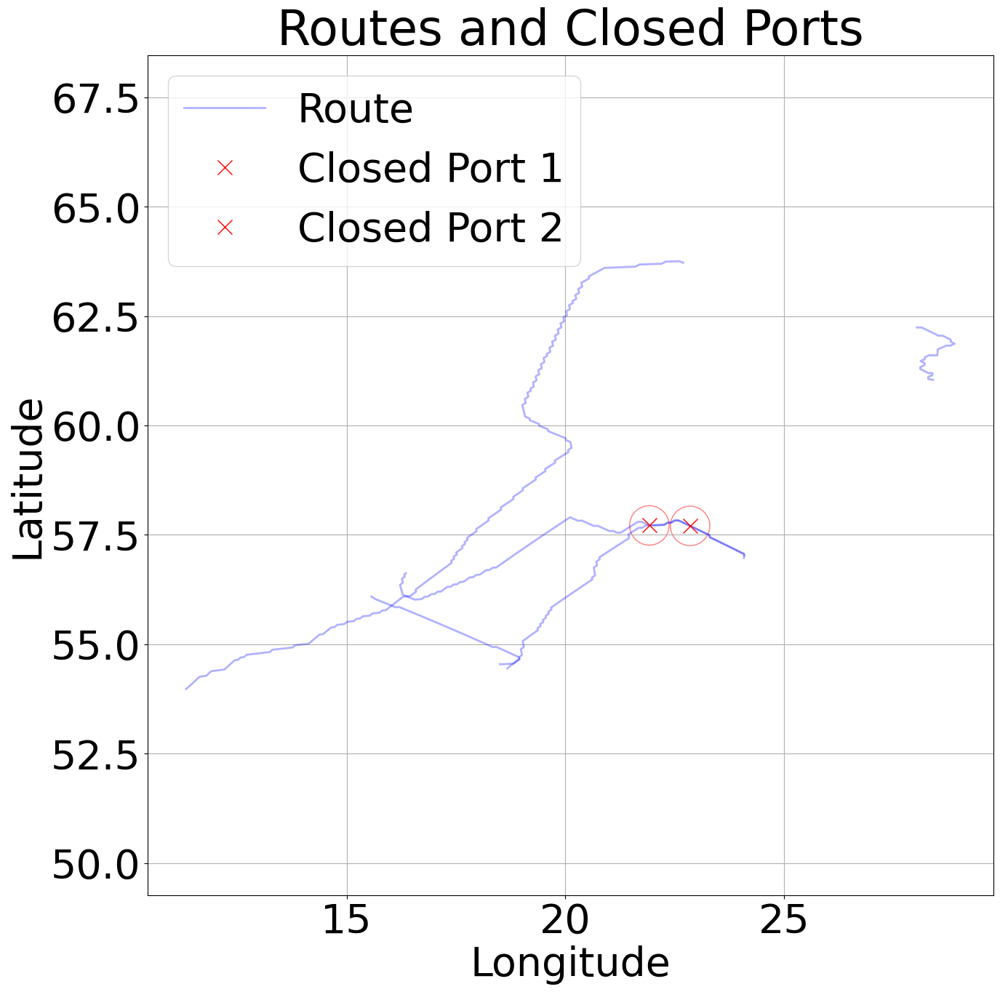


Visualization Guide:
- Blue lines: Ship routes
- Red X's: Closed ports
- Red circles: 5km radius around closed ports

If red circles intersect blue lines, those routes should be affected by port closures.

Closed Port Coordinates:
Port 1:
  Latitude:  57.704516°N
  Longitude: 22.848808°E
  Human readable: Approximately 57.7°N, 22.8°E

Port 2:
  Latitude:  57.715716°N
  Longitude: 21.917899°E
  Human readable: Approximately 57.7°N, 21.9°E

Type of graph_df_adj_5km: <class 'pandas.core.frame.DataFrame'>

Attributes and methods of graph_df_adj_5km:
['T', '_AXIS_LEN', '_AXIS_ORDERS', '_AXIS_TO_AXIS_NUMBER', '_HANDLED_TYPES', '__abs__', '__add__', '__and__', '__annotations__', '__array__', '__array_priority__', '__array_ufunc__', '__arrow_c_stream__', '__bool__', '__class__', '__contains__', '__copy__', '__dataframe__', '__dataframe_consortium_standard__', '__deepcopy__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__divmod__', '__doc__', '__eq__', '__finalize__', '__floordiv__',

/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Finding nodes to remove (using 50km radius):
Total nodes: 20345
Nodes to remove: 409
Preserved destination nodes: 19936
Removing edges that include closed nodes:
Extracting coords into node_coords dict:
Finding nodes to remove (using 50km radius):
Total nodes: 20345
Nodes to remove: 409
Preserved destination nodes: 19936
Removing edges that include closed nodes:
Running predictions with modified graphs:


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:140: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return pyproj.transform(self.p_from, self.p_to, lon, lat)
/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


finished prediction on modified graphs!
plotting comparison for Route Comparison: Original vs Modified (Closed Ports)


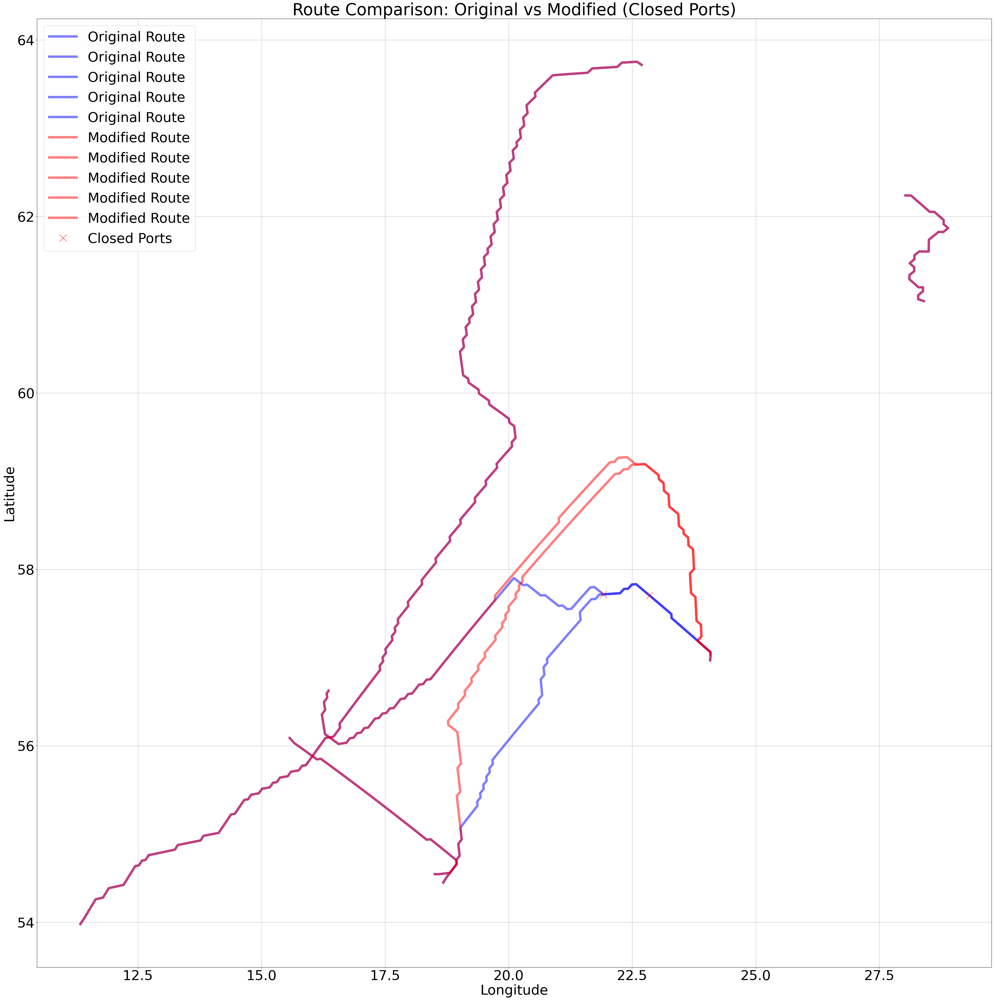

In [80]:
# Use the top 2 most-used points as closed ports
# closed_ports = [
#     (busy_points.iloc[0][['lat', 'lon']].values),
#     (busy_points.iloc[1][['lat', 'lon']].values)
# ]

closed_ports = better_closed_ports

import matplotlib.pyplot as plt

def plot_route_area():
    plt.figure(figsize=(15, 15))
    
    # Plot all routes in blue
    for voyage, route in routes_adjacent_5km.groupby('voyage'):
        plt.plot(route['lon'], route['lat'], 'b-', alpha=0.3, linewidth=2, label='Route' if voyage == routes_adjacent_5km['voyage'].iloc[0] else "")
    
    # Plot closed ports as red X's
    radius_km = 50 # determines how large of a radius to block out around closed ports --> only for visualization purposes, actual rerouting logic radius is in close_ports() function
    for i, (lat, lon) in enumerate(closed_ports):
        plt.plot(lon, lat, 'rx', markersize=15, label=f'Closed Port {i+1}')
        # Add a circle to show 5km radius around port
        circle = plt.Circle((lon, lat), radius=radius_km/111, color='r', fill=False, alpha=0.5)  # 1 degree ≈ 111km
        plt.gca().add_artist(circle)
    
    # Add grid for better reference
    plt.grid(True)
    
    # Add title and labels
    plt.title('Routes and Closed Ports')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    
    # Add legend
    plt.legend()
    
    # Make sure the aspect ratio is equal
    plt.axis('equal')
    
    plt.show()

    # Print some helpful context
    print("\nVisualization Guide:")
    print("- Blue lines: Ship routes")
    print("- Red X's: Closed ports")
    print("- Red circles: 5km radius around closed ports")
    print("\nIf red circles intersect blue lines, those routes should be affected by port closures.")

# First show the visualization
plot_route_area()

# Then print the closed port coordinates in a readable format
print("\nClosed Port Coordinates:")
for i, (lat, lon) in enumerate(closed_ports):
    print(f"Port {i+1}:")
    print(f"  Latitude:  {lat:.6f}°N")
    print(f"  Longitude: {lon:.6f}°E")
    print(f"  Human readable: Approximately {lat:.1f}°N, {lon:.1f}°E")
    print()

print("Type of graph_df_adj_5km:", type(graph_df_adj_5km))
print("\nAttributes and methods of graph_df_adj_5km:")
print(dir(graph_df_adj_5km))

# Create modified graphs
graph_adj_5km_modified = close_ports(graph_df_adj_5km, closed_ports, summer_test_voyages.tail(5))
graph_ship_5km_modified = close_ports(graph_df_ship_5km, closed_ports, summer_test_voyages.tail(5))

# Run predictions with modified graphs
print(f"Running predictions with modified graphs:")
routes_and_areas = shortest_path.predict_routes(
    summer_test_voyages.tail(5), 
    grid_5km, 
    graph_adj_5km_modified,  # Use modified graph
    speed_model_5km, 
    None, 
    shallow_graph_5km,
    print_params=False  # Skip the parameter printing
)

print(f"finished prediction on modified graphs!")

# Compare original vs modified routes
routes_modified = pd.DataFrame(
    data=routes_and_areas[0],
    columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number']
)
areas_modified = pd.DataFrame(
    data=routes_and_areas[0],
    columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number']
)
areas_modified = pd.DataFrame(
    data=routes_and_areas[1],
    columns=['lat', 'lon', 'voyage', 'g', 'h', 'f']
)

# Plot both original and modified routes
def plot_comparison(original_routes, modified_routes, test_voyages, title):
    print(f"plotting comparison for {title}")
    plt.figure(figsize=(50, 50))
    plt.title(title)

    # Plot original routes
    for voyage, route in original_routes.groupby('voyage'):
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')],
                 'b-', alpha=0.5, linewidth=7, label='Original Route')
        
    # Plot modified routes
    for voyage, route in modified_routes.groupby('voyage'):
        xy = route.loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')],
                 'r-', alpha=0.5, linewidth=7, label='Modified Route')
        
    # Plot closed ports
    closed_lats, closed_lons = zip(*closed_ports)
    plt.plot(closed_lons, closed_lats, 'rx', markersize=20, label='Closed Ports')

    plt.grid(True)
    plt.legend()
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

# Plot Comparison
plot_comparison(
    routes_adjacent_5km,
    routes_modified,
    test_voyages,
    'Route Comparison: Original vs Modified (Closed Ports)'
)

### Create API Endpoint

In [83]:
# In a Jupyter notebook cell
from fastapi import FastAPI, HTTPException
from fastapi.responses import JSONResponse
from pydantic import BaseModel
from typing import List
import nest_asyncio
import uvicorn
from threading import Thread

# Enable nested asyncio for Jupyter
nest_asyncio.apply()

app = FastAPI()

class Port(BaseModel):
    latitude: float
    longitude: float

class RouteRequest(BaseModel):
    ports_to_close: List[Port]

def format_routes_for_export(routes_df):
    """Format routes DataFrame for API export"""
    routes_by_voyage = []
    for voyage_id, voyage_route in routes_df.groupby('voyage'):
        route_points = []
        for _, point in voyage_route.iterrows():
            route_points.append({
                'latitude': float(point['lat']),
                'longitude': float(point['lon']),
                'speed': float(point['speed']) if 'speed' in point else None,
                'node': int(point['node']) if 'node' in point else None,
                'mmsi': int(point['mmsi']) if 'mmsi' in point else None,
                'voyage': int(point['voyage']) if 'voyage' in point else None
            })
        routes_by_voyage.append({
            'voyage_id': int(voyage_id),
            'route_points': route_points
        })
    return routes_by_voyage

@app.post("/reroute")
async def reroute_around_ports(request: RouteRequest):
    """Generate new routes avoiding specified closed ports"""
    try:
        # Convert ports to the format needed by close_ports
        ports_to_close = [(port.latitude, port.longitude) for port in request.ports_to_close]
        
        # Create modified graph with the specified closed ports
        graph_adj_5km_modified = close_ports(
            graph_df_adj_5km, 
            ports_to_close,
            summer_test_voyages.tail(5)
        )
        
        # Generate new routes
        routes_and_areas = shortest_path.predict_routes(
            summer_test_voyages.tail(5), 
            grid_5km, 
            graph_adj_5km_modified,
            speed_model_5km, 
            None, 
            shallow_graph_5km,
            print_params=False
        )
        
        # Convert to DataFrame
        new_routes = pd.DataFrame(
            data=routes_and_areas[0],
            columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number']
        )
        
        # Format for response
        response_data = {
            'routes': format_routes_for_export(new_routes),
            'closed_ports': [
                {'latitude': float(lat), 'longitude': float(lon)} 
                for lat, lon in ports_to_close
            ]
        }
        
        return JSONResponse(content=response_data)
        
    except Exception as e:
        raise HTTPException(
            status_code=500,
            detail=f"Failed to generate routes: {str(e)}"
        )

# Function to run the server in a separate thread
def run_server():
    uvicorn.run(app, host="127.0.0.1", port=8000)

# Start the server in a separate thread
server_thread = Thread(target=run_server, daemon=True)
server_thread.start()

print("API server is running at http://127.0.0.1:8000")

API server is running at http://127.0.0.1:8000


INFO:     Started server process [24998]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
INFO:     Uvicorn running on http://127.0.0.1:8000 (Press CTRL+C to quit)


INFO:     127.0.0.1:58776 - "GET / HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:58776 - "GET /favicon.ico HTTP/1.1" 404 Not Found
Extracting coords into node_coords dict:


In [85]:
import requests

# Test the API
test_request = {
    "ports_to_close": [
        {"latitude": 57.704516, "longitude": 22.848808},
        {"latitude": 57.715716, "longitude": 21.917899}
    ]
}

response = requests.post("http://127.0.0.1:8000/reroute", json=test_request)
new_routes = response.json()

# Print or process the results
print("New routes generated:", len(new_routes['routes']))

/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


Finding nodes to remove (using 50km radius):
Total nodes: 20345
Nodes to remove: 409
Preserved destination nodes: 19936
Removing edges that include closed nodes:


/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:140: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return pyproj.transform(self.p_from, self.p_to, lon, lat)
/Users/howardhuang/Documents/GitHub/marine-traffic-modelling/pygradu/gridify.py:90: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  p = pyproj.transform(self.p_to, self.p_from, self.cols[col] + self.side_length/2, self.rows[row] + self.side_length/2)


INFO:     127.0.0.1:58796 - "POST /reroute HTTP/1.1" 200 OK
INFO:     127.0.0.1:60367 - "GET /news/api/news?limit=5 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60368 - "GET /langchain_agent/api/langchain_agent?lat=27&lon=45 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60371 - "GET /weather/api/weather?lat=27&lon=45 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60372 - "GET /api/ship-routes HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60384 - "GET /news/api/news?limit=5 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60386 - "GET /langchain_agent/api/langchain_agent?lat=27&lon=45 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60367 - "GET /weather/api/weather?lat=27&lon=45 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60368 - "GET /api/ship-routes HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60386 - "GET /weather/api/weather?lat=27&lon=45 HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60367 - "GET /api/ship-routes HTTP/1.1" 404 Not Found
INFO:     127.0.0.1:60367 - "GET /langchain_agent/api/langchain_ag

New routes generated: 5



Route Coordinates:

Voyage 3521:
           lat        lon
0    54.449152  18.676552
1    54.509777  18.744763
2    54.559748  18.812619
3    54.609686  18.880640
4    54.659592  18.948827
5    54.704317  18.939912
6    54.754197  19.008324
7    54.798928  18.999444
8    54.843658  18.990540
9    54.888387  18.981611
10   54.938255  19.050368
11   54.982989  19.041474
12   55.027723  19.032556
13   55.072455  19.023612
14   55.117186  19.014644
15   55.161915  19.005651
16   55.206644  18.996633
17   55.251371  18.987589
18   55.296096  18.978520
19   55.340820  18.969426
20   55.385543  18.960307
21   55.430265  18.951162
22   55.480178  19.020760
23   55.524905  19.011651
24   55.569631  19.002517
25   55.614356  18.993357
26   55.659080  18.984171
27   55.703802  18.974959
28   55.748523  18.965721
29   55.798445  19.035870
30   55.843172  19.026669
31   55.887897  19.017443
32   55.932622  19.008190
33   55.977344  18.998911
34   56.022066  18.989605
35   56.066786  18.980274
36  

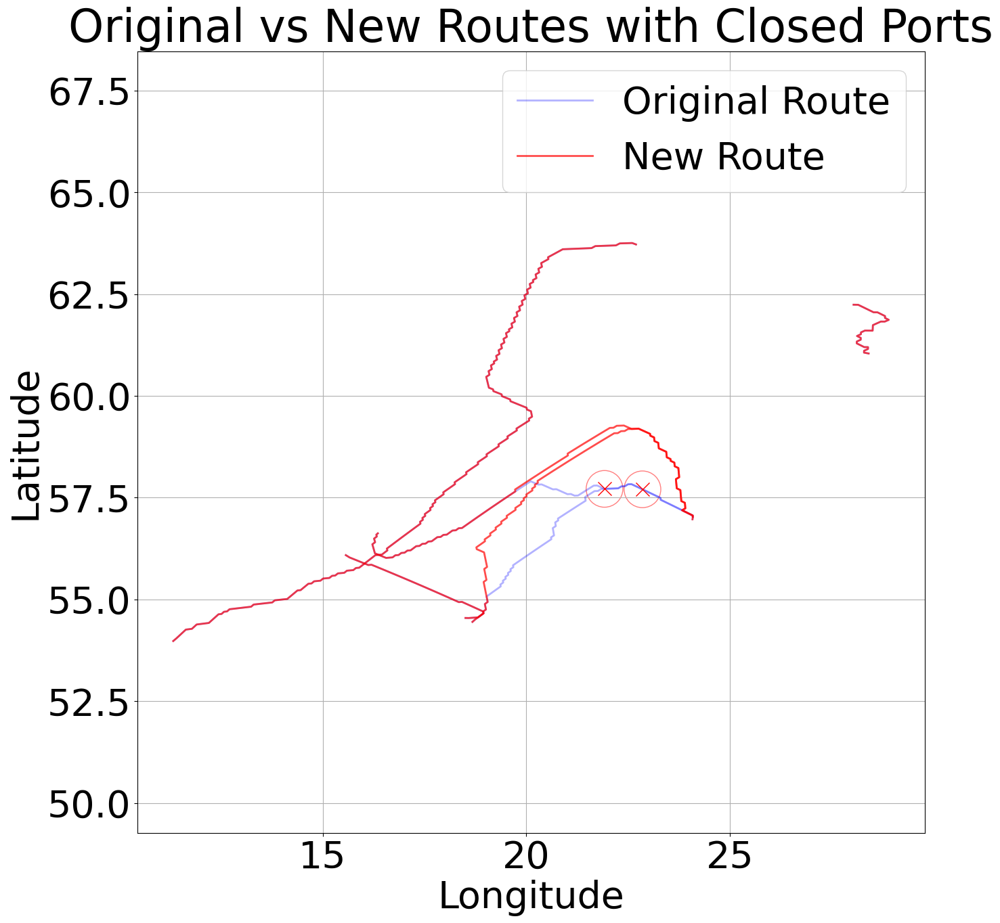


Route Statistics:

Voyage 3521:
Number of points: 156
Total distance: 935.3 km
Start: (54.4492°N, 18.6766°E)
End: (56.9684°N, 24.0773°E)

Voyage 5801:
Number of points: 34
Total distance: 203.7 km
Start: (62.2379°N, 28.0305°E)
End: (61.0401°N, 28.4004°E)

Voyage 5900:
Number of points: 251
Total distance: 1516.5 km
Start: (53.9792°N, 11.3333°E)
End: (63.7174°N, 22.6907°E)

Voyage 6029:
Number of points: 147
Total distance: 908.9 km
Start: (56.6236°N, 16.3547°E)
End: (57.0333°N, 24.0839°E)

Voyage 6264:
Number of points: 46
Total distance: 305.6 km
Start: (56.0881°N, 15.5691°E)
End: (54.5456°N, 18.5053°E)


In [86]:
# Convert API response back to DataFrame
def api_response_to_dataframe(routes_json):
    """Convert API response back to DataFrame format"""
    rows = []
    for voyage in routes_json['routes']:
        for point in voyage['route_points']:
            rows.append({
                'lat': point['latitude'],
                'lon': point['longitude'],
                'speed': point['speed'],
                'node': point['node'],
                'mmsi': point['mmsi'],
                'voyage': point['voyage']
            })
    return pd.DataFrame(rows)

# Convert response to DataFrame
new_routes_df = api_response_to_dataframe(new_routes)

# Print the coordinates
print("\nRoute Coordinates:")
for voyage_id, voyage_route in new_routes_df.groupby('voyage'):
    print(f"\nVoyage {voyage_id}:")
    print(voyage_route[['lat', 'lon']].to_string())

# Plot the routes on a map
def plot_new_routes():
    plt.figure(figsize=(15, 15))
    
    # Plot original routes in blue (if you want to compare)
    for voyage, route in routes_adjacent_5km.groupby('voyage'):
        plt.plot(route['lon'], route['lat'], 'b-', alpha=0.3, linewidth=2, 
                label='Original Route' if voyage == routes_adjacent_5km['voyage'].iloc[0] else "")
    
    # Plot new routes in red
    for voyage, route in new_routes_df.groupby('voyage'):
        plt.plot(route['lon'], route['lat'], 'r-', alpha=0.7, linewidth=2,
                label='New Route' if voyage == new_routes_df['voyage'].iloc[0] else "")
    
    # Plot closed ports
    for port in new_routes['closed_ports']:
        plt.plot(port['longitude'], port['latitude'], 'rx', markersize=15)
        # Add radius circle (50km)
        circle = plt.Circle((port['longitude'], port['latitude']), 
                          radius=50/111, color='r', fill=False, alpha=0.5)
        plt.gca().add_artist(circle)
    
    # Add labels and grid
    plt.grid(True)
    plt.title('Original vs New Routes with Closed Ports')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.legend()
    plt.axis('equal')
    plt.show()

# Plot the routes
plot_new_routes()

# Print route statistics
print("\nRoute Statistics:")
for voyage_id, voyage_route in new_routes_df.groupby('voyage'):
    # Calculate total distance
    points = list(zip(voyage_route['lat'], voyage_route['lon']))
    total_distance = sum(
        geodesic(points[i], points[i+1]).kilometers 
        for i in range(len(points)-1)
    )
    
    print(f"\nVoyage {voyage_id}:")
    print(f"Number of points: {len(voyage_route)}")
    print(f"Total distance: {total_distance:.1f} km")
    print(f"Start: ({voyage_route['lat'].iloc[0]:.4f}°N, {voyage_route['lon'].iloc[0]:.4f}°E)")
    print(f"End: ({voyage_route['lat'].iloc[-1]:.4f}°N, {voyage_route['lon'].iloc[-1]:.4f}°E)")

In [88]:
import folium

def plot_routes_on_folium():
    # Create map centered on the area
    center_lat = new_routes_df['lat'].mean()
    center_lon = new_routes_df['lon'].mean()
    m = folium.Map(location=[center_lat, center_lon], zoom_start=7)
    
    # Plot original routes
    for voyage, route in routes_adjacent_5km.groupby('voyage'):
        points = list(zip(route['lat'], route['lon']))
        folium.PolyLine(points, color='blue', weight=2, opacity=0.3).add_to(m)
    
    # Plot new routes
    for voyage, route in new_routes_df.groupby('voyage'):
        points = list(zip(route['lat'], route['lon']))
        folium.PolyLine(points, color='red', weight=2, opacity=0.7).add_to(m)
    
    # Plot closed ports
    for port in new_routes['closed_ports']:
        folium.CircleMarker(
            location=[port['latitude'], port['longitude']],
            radius=5,
            color='red',
            fill=True
        ).add_to(m)
        
        # Add radius circle
        folium.Circle(
            location=[port['latitude'], port['longitude']],
            radius=50000,  # 50km in meters
            color='red',
            fill=False,
            opacity=0.5
        ).add_to(m)
    
    return m

# Create and display the interactive map
interactive_map = plot_routes_on_folium()
interactive_map

#### Show Impact on Time, Fuel Prices, and Operating Costs

Route Impact Analysis:
                       Metric     Value
         Direct Distance (nm)      8.33
       Diverted Distance (nm)   3876.53
     Additional Distance (nm)   3868.19
          Direct Time (hours)      0.56
        Diverted Time (hours)    258.44
      Additional Time (hours)    257.88
       Additional Fuel (tons)    644.70
   Additional Fuel Cost (USD) 515758.77
Additional Cost per TEU (USD)     51.58
             Price Impact (%)      0.13

Commodity Price Impact:
    Commodity  Baseline Price (USD)  Impact Multiplier  Estimated Price Increase (%)  New Price (USD)
  Electronics                  1000                1.2                      0.154728      1001.547276
     Clothing                    50                0.8                      0.103152        50.051576
Food Products                   200                1.5                      0.193410       200.386819


/var/folders/tj/wdc1wrd91sd06xhdd07m6z6c0000gn/T/ipykernel_24998/3727112491.py:114: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


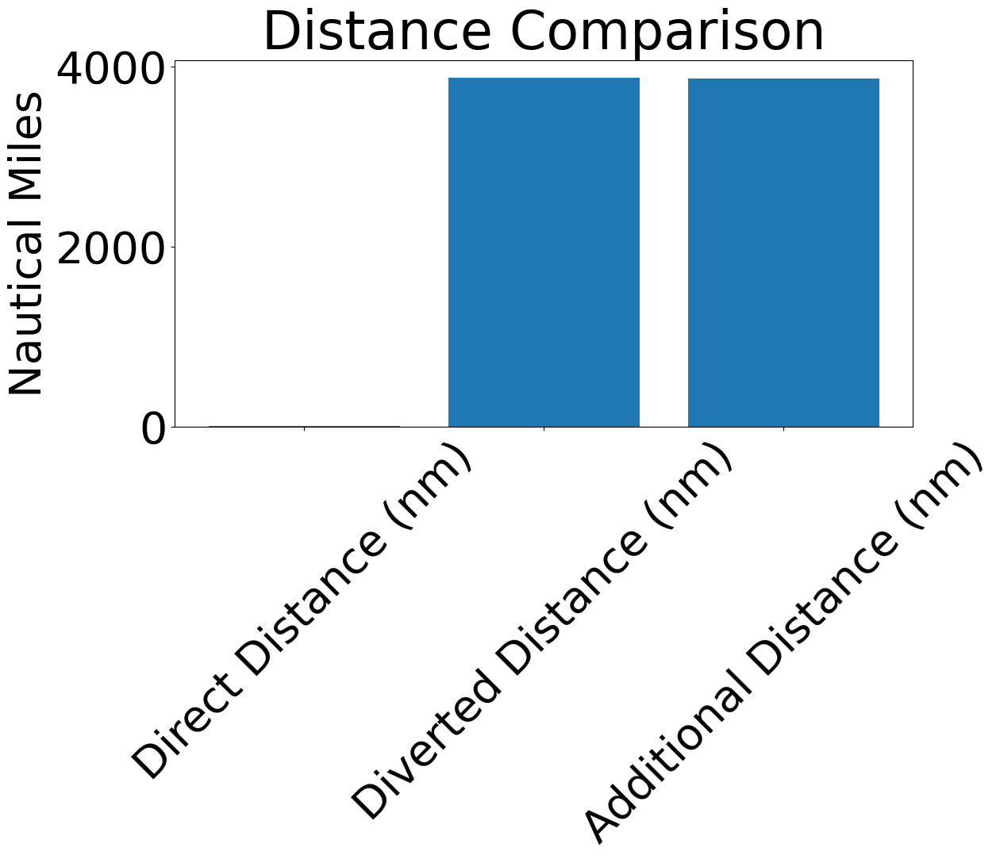

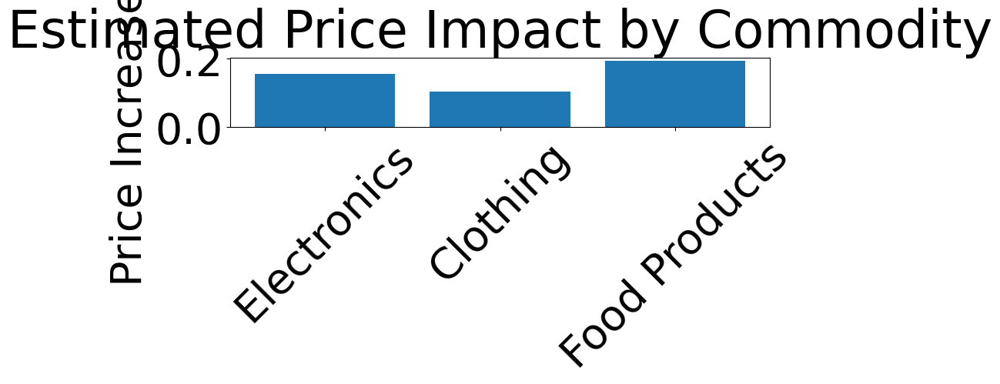

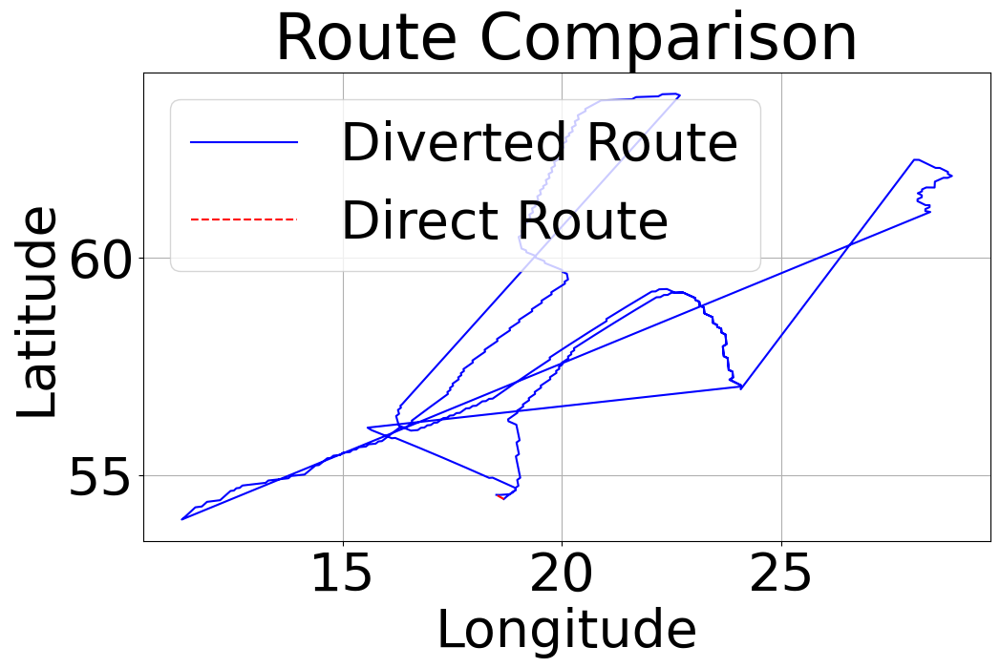

In [92]:
# Add this new cell after your route prediction
from geopy.distance import geodesic
import pandas as pd
from datetime import timedelta

# Convert the routes data to a DataFrame
route_df = api_response_to_dataframe(new_routes)  # Use the function we created earlier

def analyze_route_impact(route_df):
    """
    Analyze the impact of a diverted route compared to direct route
    """
    # Extract start and end points
    start_point = [route_df.iloc[0]['lat'], route_df.iloc[0]['lon']]
    end_point = [route_df.iloc[-1]['lat'], route_df.iloc[-1]['lon']]
    
    # Calculate direct distance
    direct_distance = geodesic(start_point, end_point).nautical
    
    # Calculate diverted distance
    diverted_distance = 0
    for i in range(len(route_df)-1):
        point1 = [route_df.iloc[i]['lat'], route_df.iloc[i]['lon']]
        point2 = [route_df.iloc[i+1]['lat'], route_df.iloc[i+1]['lon']]
        diverted_distance += geodesic(point1, point2).nautical
    
    # Calculate time differences
    avg_speed = 15  # nautical miles per hour
    direct_time = direct_distance / avg_speed
    diverted_time = diverted_distance / avg_speed
    additional_time = diverted_time - direct_time
    
    # Calculate fuel consumption and costs
    fuel_consumption_rate = 60  # tons per day
    fuel_price = 800  # USD per ton
    
    direct_fuel = (direct_time / 24) * fuel_consumption_rate
    diverted_fuel = (diverted_time / 24) * fuel_consumption_rate
    additional_fuel = diverted_fuel - direct_fuel
    
    additional_fuel_cost = additional_fuel * fuel_price
    
    # Calculate impact on container costs
    teu_capacity = 10000  # Twenty-foot Equivalent Units
    avg_value_per_teu = 40000  # USD
    total_cargo_value = teu_capacity * avg_value_per_teu
    
    additional_cost_per_teu = additional_fuel_cost / teu_capacity
    price_impact_percentage = (additional_cost_per_teu / avg_value_per_teu) * 100
    
    # Create summary DataFrame
    summary = pd.DataFrame({
        'Metric': [
            'Direct Distance (nm)',
            'Diverted Distance (nm)',
            'Additional Distance (nm)',
            'Direct Time (hours)',
            'Diverted Time (hours)',
            'Additional Time (hours)',
            'Additional Fuel (tons)',
            'Additional Fuel Cost (USD)',
            'Additional Cost per TEU (USD)',
            'Price Impact (%)'
        ],
        'Value': [
            round(direct_distance, 2),
            round(diverted_distance, 2),
            round(diverted_distance - direct_distance, 2),
            round(direct_time, 2),
            round(diverted_time, 2),
            round(additional_time, 2),
            round(additional_fuel, 2),
            round(additional_fuel_cost, 2),
            round(additional_cost_per_teu, 2),
            round(price_impact_percentage, 2)
        ]
    })
    
    # Calculate commodity-specific impacts
    commodities = pd.DataFrame({
        'Commodity': ['Electronics', 'Clothing', 'Food Products'],
        'Baseline Price (USD)': [1000, 50, 200],
        'Impact Multiplier': [1.2, 0.8, 1.5]  # Higher impact on electronics and food
    })
    
    commodities['Estimated Price Increase (%)'] = commodities['Impact Multiplier'] * price_impact_percentage
    commodities['New Price (USD)'] = commodities['Baseline Price (USD)'] * (1 + commodities['Estimated Price Increase (%)'] / 100)
    
    return summary, commodities

# Analyze the predicted route
# Assuming route_df is your DataFrame with the predicted route
summary, commodities = analyze_route_impact(route_df)

# Display results
print("Route Impact Analysis:")
print("=====================")
print(summary.to_string(index=False))
print("\nCommodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

# Optional: Visualize the results
import matplotlib.pyplot as plt
import seaborn as sns

# Plot distance comparison
plt.figure(figsize=(12, 6))
distances = summary[summary['Metric'].str.contains('Distance')].copy()
plt.bar(distances['Metric'], distances['Value'])
plt.title('Distance Comparison')
plt.xticks(rotation=45)
plt.ylabel('Nautical Miles')
plt.tight_layout()
plt.show()

# Plot commodity price impact
plt.figure(figsize=(10, 6))
plt.bar(commodities['Commodity'], 
        commodities['Estimated Price Increase (%)'])
plt.title('Estimated Price Impact by Commodity')
plt.ylabel('Price Increase (%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot route comparison
plt.figure(figsize=(12, 8))
# Plot diverted route
plt.plot(route_df['lon'], route_df['lat'], 
         'b-', label='Diverted Route')
# Plot direct route
plt.plot([route_df.iloc[0]['lon'], route_df.iloc[-1]['lon']], 
         [route_df.iloc[0]['lat'], route_df.iloc[-1]['lat']], 
         'r--', label='Direct Route')
plt.title('Route Comparison')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [96]:
def analyze_route_impact(route_df, original_voyage):
    """
    Analyze the impact of a diverted route compared to direct route
    
    Parameters:
    route_df: DataFrame containing the diverted route points
    original_voyage: Series or dict containing original start/end points 
                    with 'lat', 'lon', 'end_lat', 'end_lon'
    """
    # Extract true start and end points from original voyage
    start_point = [original_voyage['lat'], original_voyage['lon']]
    end_point = [original_voyage['end_lat'], original_voyage['end_lon']]
    
    print(f"Analyzing route from ({start_point[0]:.4f}, {start_point[1]:.4f}) to ({end_point[0]:.4f}, {end_point[1]:.4f})")
    
    # Calculate direct distance using true start/end points
    direct_distance = geodesic(start_point, end_point).nautical
    
    # Calculate diverted distance
    diverted_distance = 0
    for i in range(len(route_df)-1):
        point1 = [route_df.iloc[i]['lat'], route_df.iloc[i]['lon']]
        point2 = [route_df.iloc[i+1]['lat'], route_df.iloc[i+1]['lon']]
        diverted_distance += geodesic(point1, point2).nautical
    
    # Calculate time differences
    avg_speed = 15  # nautical miles per hour
    direct_time = direct_distance / avg_speed
    diverted_time = diverted_distance / avg_speed
    additional_time = diverted_time - direct_time
    
    # Calculate fuel consumption and costs
    fuel_consumption_rate = 60  # tons per day
    fuel_price = 800  # USD per ton
    
    direct_fuel = (direct_time / 24) * fuel_consumption_rate
    diverted_fuel = (diverted_time / 24) * fuel_consumption_rate
    additional_fuel = diverted_fuel - direct_fuel
    
    additional_fuel_cost = additional_fuel * fuel_price
    
    # Calculate impact on container costs
    teu_capacity = 10000  # Twenty-foot Equivalent Units
    avg_value_per_teu = 40000  # USD
    total_cargo_value = teu_capacity * avg_value_per_teu
    
    additional_cost_per_teu = additional_fuel_cost / teu_capacity
    price_impact_percentage = (additional_cost_per_teu / avg_value_per_teu) * 100
    
    # Create summary DataFrame
    summary = pd.DataFrame({
        'Metric': [
            'Direct Distance (nm)',
            'Diverted Distance (nm)',
            'Additional Distance (nm)',
            'Direct Time (hours)',
            'Diverted Time (hours)',
            'Additional Time (hours)',
            'Additional Fuel (tons)',
            'Additional Fuel Cost (USD)',
            'Additional Cost per TEU (USD)',
            'Price Impact (%)'
        ],
        'Value': [
            round(direct_distance, 2),
            round(diverted_distance, 2),
            round(diverted_distance - direct_distance, 2),
            round(direct_time, 2),
            round(diverted_time, 2),
            round(additional_time, 2),
            round(additional_fuel, 2),
            round(additional_fuel_cost, 2),
            round(additional_cost_per_teu, 2),
            round(price_impact_percentage, 2)
        ]
    })
    
    # Calculate commodity-specific impacts
    commodities = pd.DataFrame({
        'Commodity': ['Electronics', 'Clothing', 'Food Products'],
        'Baseline Price (USD)': [1000, 50, 200],
        'Impact Multiplier': [1.2, 0.8, 1.5]  # Higher impact on electronics and food
    })
    
    commodities['Estimated Price Increase (%)'] = commodities['Impact Multiplier'] * price_impact_percentage
    commodities['New Price (USD)'] = commodities['Baseline Price (USD)'] * (1 + commodities['Estimated Price Increase (%)'] / 100)
    
    return summary, commodities  # Added the return statement

# Get the original voyage data
original_voyage = summer_test_voyages.tail(5).iloc[0]

# Analyze the route with the correct start/end points
summary, commodities = analyze_route_impact(route_df, original_voyage)

# Display results
print("\nRoute Impact Analysis:")
print("=====================")
print(summary.to_string(index=False))
print("\nCommodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

Analyzing route from (54.4492, 18.6766) to (56.9684, 24.0773)

Route Impact Analysis:
                       Metric     Value
         Direct Distance (nm)    237.66
       Diverted Distance (nm)   3876.53
     Additional Distance (nm)   3638.86
          Direct Time (hours)     15.84
        Diverted Time (hours)    258.44
      Additional Time (hours)    242.59
       Additional Fuel (tons)    606.48
   Additional Fuel Cost (USD) 485181.51
Additional Cost per TEU (USD)     48.52
             Price Impact (%)      0.12

Commodity Price Impact:
    Commodity  Baseline Price (USD)  Impact Multiplier  Estimated Price Increase (%)  New Price (USD)
  Electronics                  1000                1.2                      0.145554      1001.455545
     Clothing                    50                0.8                      0.097036        50.048518
Food Products                   200                1.5                      0.181943       200.363886


In [97]:
# First get the routes from your API response
new_routes = response.json()

# Convert API response back to DataFrame
new_routes_df = api_response_to_dataframe(new_routes)

# Get the voyage ID from the new routes
voyage_id = new_routes_df['voyage'].iloc[0]

# Get the corresponding original voyage data
original_voyage = summer_test_voyages.tail(5)[
    summer_test_voyages.tail(5)['voyage'] == voyage_id
].iloc[0]

print("Original Voyage Details:")
print(f"Start: ({original_voyage['lat']:.4f}°N, {original_voyage['lon']:.4f}°E)")
print(f"End: ({original_voyage['end_lat']:.4f}°N, {original_voyage['end_lon']:.4f}°E)")

# Now analyze the route impact with the original voyage data
summary, commodities = analyze_route_impact(new_routes_df, original_voyage)

# Display results
print("\nRoute Impact Analysis:")
print("=====================")
print(summary.to_string(index=False))
print("\nCommodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

Original Voyage Details:
Start: (54.4492°N, 18.6766°E)
End: (56.9684°N, 24.0773°E)
Analyzing route from (54.4492, 18.6766) to (56.9684, 24.0773)

Route Impact Analysis:
                       Metric     Value
         Direct Distance (nm)    237.66
       Diverted Distance (nm)   3876.53
     Additional Distance (nm)   3638.86
          Direct Time (hours)     15.84
        Diverted Time (hours)    258.44
      Additional Time (hours)    242.59
       Additional Fuel (tons)    606.48
   Additional Fuel Cost (USD) 485181.51
Additional Cost per TEU (USD)     48.52
             Price Impact (%)      0.12

Commodity Price Impact:
    Commodity  Baseline Price (USD)  Impact Multiplier  Estimated Price Increase (%)  New Price (USD)
  Electronics                  1000                1.2                      0.145554      1001.455545
     Clothing                    50                0.8                      0.097036        50.048518
Food Products                   200                1.5      

Analyzing route from (54.4492, 18.6766) to (56.9684, 24.0773)

Route Impact Analysis:
                       Metric     Value
         Direct Distance (nm)    237.66
       Diverted Distance (nm)   3876.53
     Additional Distance (nm)   3638.86
          Direct Time (hours)     15.84
        Diverted Time (hours)    258.44
      Additional Time (hours)    242.59
       Additional Fuel (tons)    606.48
   Additional Fuel Cost (USD) 485181.51
Additional Cost per TEU (USD)     48.52
             Price Impact (%)      0.12

Commodity Price Impact:
    Commodity  Baseline Price (USD)  Impact Multiplier  Estimated Price Increase (%)  New Price (USD)
  Electronics                  1000                1.2                      0.145554      1001.455545
     Clothing                    50                0.8                      0.097036        50.048518
Food Products                   200                1.5                      0.181943       200.363886


/var/folders/tj/wdc1wrd91sd06xhdd07m6z6c0000gn/T/ipykernel_24998/412463753.py:26: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


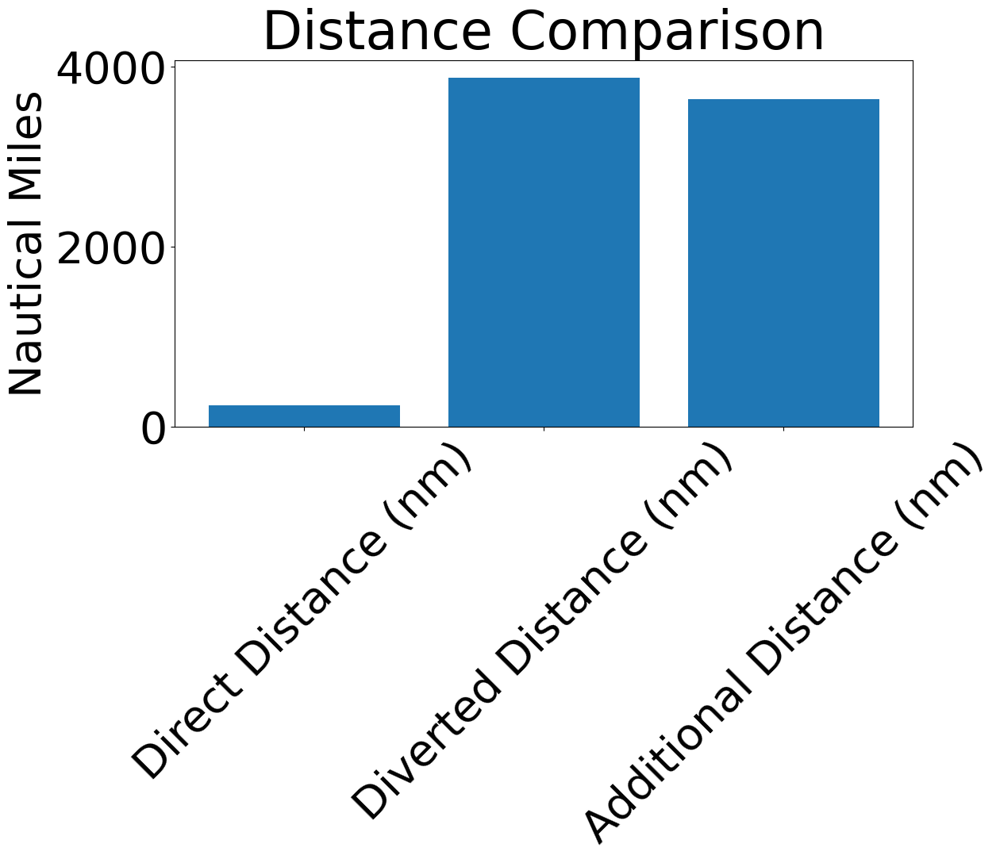

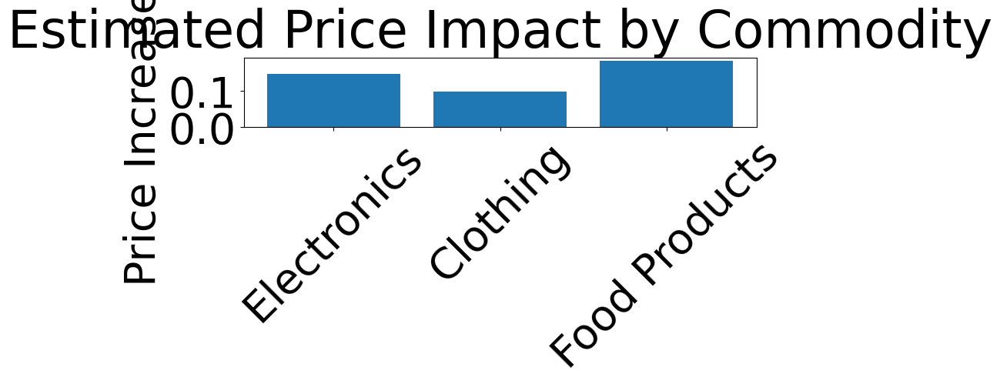

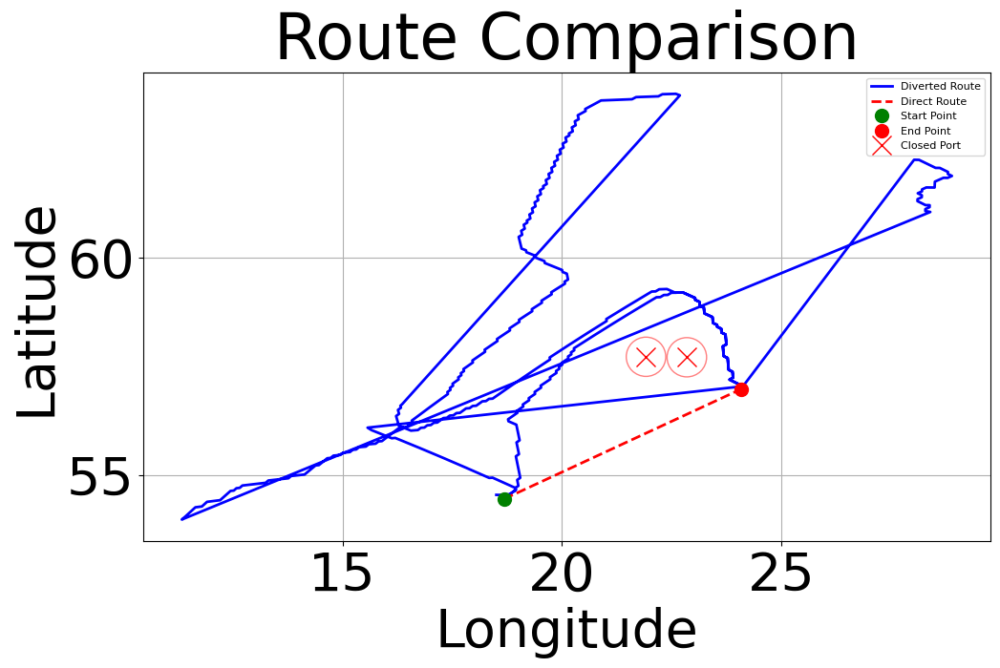


Detailed Analysis:
A ship taking the diverted route will:
- Travel an additional 3638.9 nautical miles
- Take an extra 242.6 hours
- Consume 606.5 more tons of fuel
- Incur $485,181.51 in additional fuel costs

This results in:
- $48.52 additional cost per container (TEU)
- 0.1% average price impact on goods

Impact on specific commodities:
- Electronics: 0.1% increase ($1000.00 → $1001.46)
- Clothing: 0.1% increase ($50.00 → $50.05)
- Food Products: 0.2% increase ($200.00 → $200.36)


In [99]:
# Get the original voyage data
original_voyage = summer_test_voyages.tail(5).iloc[0]

# Analyze the route with the correct start/end points
summary, commodities = analyze_route_impact(route_df, original_voyage)

# Display results
print("\nRoute Impact Analysis:")
print("=====================")
print(summary.to_string(index=False))
print("\nCommodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

# Visualizations
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Plot distance comparison
plt.figure(figsize=(12, 6))
distances = summary[summary['Metric'].str.contains('Distance')].copy()
plt.bar(distances['Metric'], distances['Value'])
plt.title('Distance Comparison')
plt.xticks(rotation=45)
plt.ylabel('Nautical Miles')
plt.tight_layout()
plt.show()

# 2. Plot commodity price impact
plt.figure(figsize=(10, 6))
plt.bar(commodities['Commodity'], 
        commodities['Estimated Price Increase (%)'])
plt.title('Estimated Price Impact by Commodity')
plt.ylabel('Price Increase (%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 3. Plot route comparison on map
plt.figure(figsize=(12, 8))
# Plot diverted route
plt.plot(route_df['lon'], route_df['lat'], 
         'b-', label='Diverted Route', linewidth=2)
# Plot direct route
plt.plot([original_voyage['lon'], original_voyage['end_lon']], 
         [original_voyage['lat'], original_voyage['end_lat']], 
         'r--', label='Direct Route', linewidth=2)
# Plot start and end points
plt.plot(original_voyage['lon'], original_voyage['lat'], 
         'go', markersize=10, label='Start Point')
plt.plot(original_voyage['end_lon'], original_voyage['end_lat'], 
         'ro', markersize=10, label='End Point')

# Plot closed ports
closed_port_plotted = False  # Flag to avoid duplicate legend entries
for port in new_routes['closed_ports']:
    plt.plot(port['longitude'], port['latitude'], 
             'rx', markersize=15, 
             label='Closed Port' if not closed_port_plotted else "")
    closed_port_plotted = True
    # Add radius circle (50km)
    circle = plt.Circle((port['longitude'], port['latitude']), 
                       radius=50/111, color='r', fill=False, alpha=0.5)
    plt.gca().add_artist(circle)

plt.title('Route Comparison')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
# Create smaller legend with better positioning
plt.legend(prop={'size': 8}, loc='upper right', bbox_to_anchor=(1.0, 1.0))
plt.grid(True)
plt.tight_layout()
plt.show()

# Print detailed analysis
print("\nDetailed Analysis:")
print(f"A ship taking the diverted route will:")
print(f"- Travel an additional {summary.iloc[2]['Value']:.1f} nautical miles")
print(f"- Take an extra {summary.iloc[5]['Value']:.1f} hours")
print(f"- Consume {summary.iloc[6]['Value']:.1f} more tons of fuel")
print(f"- Incur ${summary.iloc[7]['Value']:,.2f} in additional fuel costs")
print(f"\nThis results in:")
print(f"- ${summary.iloc[8]['Value']:.2f} additional cost per container (TEU)")
print(f"- {summary.iloc[9]['Value']:.1f}% average price impact on goods")

print("\nImpact on specific commodities:")
for _, row in commodities.iterrows():
    print(f"- {row['Commodity']}: {row['Estimated Price Increase (%)']:.1f}% increase " +
          f"(${row['Baseline Price (USD)']:.2f} → ${row['New Price (USD)']:.2f})")

#### Analyze impact on 5 routes separately


Analyzing voyage 3521 from (54.4492, 18.6766) to (56.9684, 24.0773)

Analyzing voyage 5801 from (62.2379, 28.0305) to (61.0401, 28.4004)

Analyzing voyage 5900 from (53.9792, 11.3333) to (63.7174, 22.6907)

Analyzing voyage 6029 from (56.6236, 16.3547) to (57.0333, 24.0839)

Analyzing voyage 6264 from (56.0881, 15.5691) to (54.5456, 18.5053)

Route Impact Analysis - Voyage 3521:
                       Metric    Value
         Direct Distance (nm)   237.66
       Diverted Distance (nm)   505.05
     Additional Distance (nm)   267.38
          Direct Time (hours)    15.84
        Diverted Time (hours)    33.67
      Additional Time (hours)    17.83
       Additional Fuel (tons)    44.56
   Additional Fuel Cost (USD) 35650.90
Additional Cost per TEU (USD)     3.57
             Price Impact (%)     0.01

Route Impact Analysis - Voyage 5801:
                       Metric   Value
         Direct Distance (nm)   72.84
       Diverted Distance (nm)  110.01
     Additional Distance (nm)   37.1

/var/folders/tj/wdc1wrd91sd06xhdd07m6z6c0000gn/T/ipykernel_24998/2758538400.py:134: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


<Figure size 1500x600 with 0 Axes>

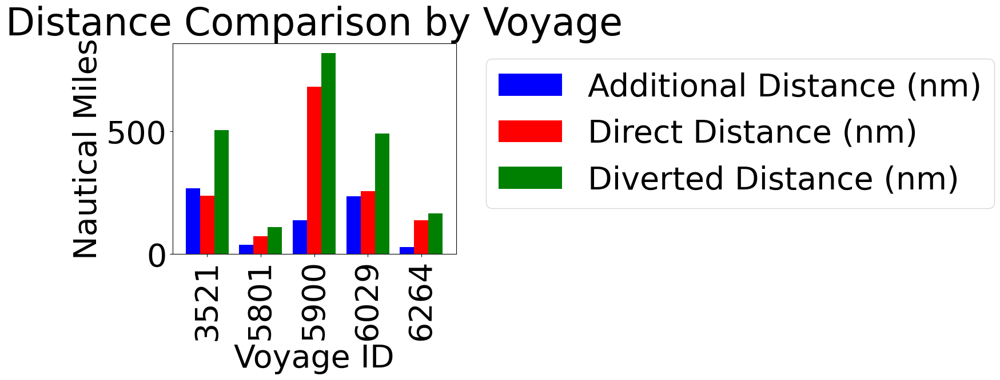

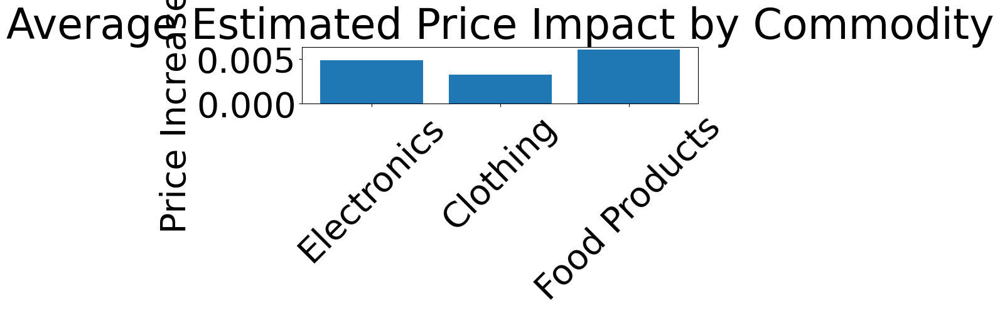

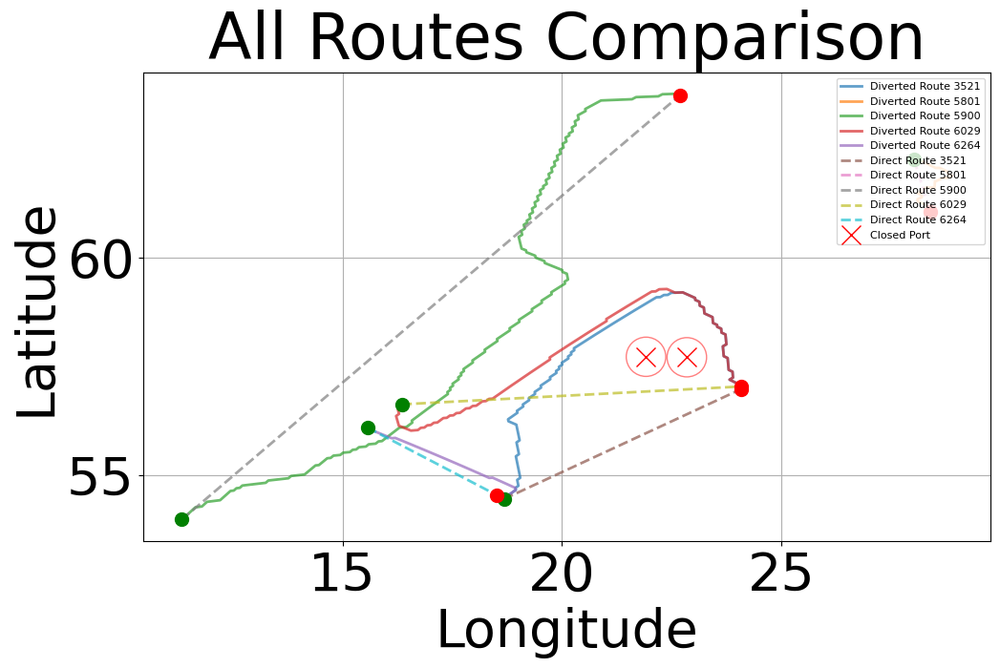


Overall Analysis:
Average impacts across all voyages:
- Average Additional Distance (nm): 140.86
- Average Additional Time (hours): 9.39
- Average Additional Fuel (tons): 23.47
- Average Additional Fuel Cost (USD): 18781.22
- Average Additional Cost per TEU (USD): 1.88
- Average Price Impact (%): 0.00


In [104]:
def analyze_route_impact(route_df, original_voyages):
    """
    Analyze the impact of diverted routes compared to direct routes
    
    Parameters:
    route_df: DataFrame containing all diverted routes
    original_voyages: DataFrame containing original voyage information
    """
    all_summaries = []
    
    # Analyze each voyage separately
    for voyage_id, voyage_route in route_df.groupby('voyage'):
        # Get corresponding original voyage
        original_voyage = original_voyages[original_voyages['voyage'] == voyage_id].iloc[0]
        
        # Extract true start and end points
        start_point = [original_voyage['lat'], original_voyage['lon']]
        end_point = [original_voyage['end_lat'], original_voyage['end_lon']]
        
        print(f"\nAnalyzing voyage {voyage_id} from ({start_point[0]:.4f}, {start_point[1]:.4f}) to ({end_point[0]:.4f}, {end_point[1]:.4f})")
        
        # Calculate direct distance
        direct_distance = geodesic(start_point, end_point).nautical
        
        # Calculate diverted distance
        diverted_distance = 0
        for i in range(len(voyage_route)-1):
            point1 = [voyage_route.iloc[i]['lat'], voyage_route.iloc[i]['lon']]
            point2 = [voyage_route.iloc[i+1]['lat'], voyage_route.iloc[i+1]['lon']]
            diverted_distance += geodesic(point1, point2).nautical
        
        # Calculate time differences
        avg_speed = 15  # nautical miles per hour
        direct_time = direct_distance / avg_speed
        diverted_time = diverted_distance / avg_speed
        additional_time = diverted_time - direct_time
        
        # Calculate fuel consumption and costs
        fuel_consumption_rate = 60  # tons per day
        fuel_price = 800  # USD per ton
        
        direct_fuel = (direct_time / 24) * fuel_consumption_rate
        diverted_fuel = (diverted_time / 24) * fuel_consumption_rate
        additional_fuel = diverted_fuel - direct_fuel
        
        additional_fuel_cost = additional_fuel * fuel_price
        
        # Calculate impact on container costs
        teu_capacity = 10000  # Twenty-foot Equivalent Units
        avg_value_per_teu = 40000  # USD
        
        additional_cost_per_teu = additional_fuel_cost / teu_capacity
        price_impact_percentage = (additional_cost_per_teu / avg_value_per_teu) * 100
        
        # Create summary for this voyage
        summary = pd.DataFrame({
            'Voyage': voyage_id,
            'Metric': [
                'Direct Distance (nm)',
                'Diverted Distance (nm)',
                'Additional Distance (nm)',
                'Direct Time (hours)',
                'Diverted Time (hours)',
                'Additional Time (hours)',
                'Additional Fuel (tons)',
                'Additional Fuel Cost (USD)',
                'Additional Cost per TEU (USD)',
                'Price Impact (%)'
            ],
            'Value': [
                round(direct_distance, 2),
                round(diverted_distance, 2),
                round(diverted_distance - direct_distance, 2),
                round(direct_time, 2),
                round(diverted_time, 2),
                round(additional_time, 2),
                round(additional_fuel, 2),
                round(additional_fuel_cost, 2),
                round(additional_cost_per_teu, 2),
                round(price_impact_percentage, 2)
            ]
        })
        
        all_summaries.append(summary)
    
    # Combine all summaries
    combined_summary = pd.concat(all_summaries)
    
    # Calculate average impacts for commodities
    avg_price_impact = combined_summary[combined_summary['Metric'] == 'Price Impact (%)']['Value'].mean()
    
    commodities = pd.DataFrame({
        'Commodity': ['Electronics', 'Clothing', 'Food Products'],
        'Baseline Price (USD)': [1000, 50, 200],
        'Impact Multiplier': [1.2, 0.8, 1.5]  # Higher impact on electronics and food
    })
    
    commodities['Estimated Price Increase (%)'] = commodities['Impact Multiplier'] * avg_price_impact
    commodities['New Price (USD)'] = commodities['Baseline Price (USD)'] * (1 + commodities['Estimated Price Increase (%)'] / 100)
    
    return combined_summary, commodities

# Get all original voyages
original_voyages = summer_test_voyages.tail(5)

# Analyze all routes
summary, commodities = analyze_route_impact(route_df, original_voyages)

# Display results for each voyage
for voyage_id in summary['Voyage'].unique():
    voyage_summary = summary[summary['Voyage'] == voyage_id]
    print(f"\nRoute Impact Analysis - Voyage {voyage_id}:")
    print("=====================")
    print(voyage_summary[['Metric', 'Value']].to_string(index=False))

print("\nAverage Commodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

# Visualizations
# 1. # Plot distance comparison by voyage
plt.figure(figsize=(15, 6))
# Reshape the data for better visualization
distances = summary[summary['Metric'].str.contains('Distance')].copy()
distances_pivot = distances.pivot(columns='Metric', values='Value', index='Voyage')

# Plot grouped bar chart with specific colors
distances_pivot.plot(kind='bar', width=0.8, 
                    color=['blue', 'red', 'green'])  # Original route blue, diverted red
plt.title('Distance Comparison by Voyage')
plt.xlabel('Voyage ID')
plt.ylabel('Nautical Miles')
plt.legend(title='', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 2. Plot commodity price impact
plt.figure(figsize=(10, 6))
plt.bar(commodities['Commodity'], 
        commodities['Estimated Price Increase (%)'])
plt.title('Average Estimated Price Impact by Commodity')
plt.ylabel('Price Increase (%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 3. Plot all routes comparison on map
plt.figure(figsize=(12, 8))

# Plot all diverted routes
for voyage_id, voyage_route in route_df.groupby('voyage'):
    plt.plot(voyage_route['lon'], voyage_route['lat'], 
             '-', label=f'Diverted Route {voyage_id}', linewidth=2, alpha=0.7)

# Plot all direct routes
for _, voyage in original_voyages.iterrows():
    plt.plot([voyage['lon'], voyage['end_lon']], 
             [voyage['lat'], voyage['end_lat']], 
             '--', label=f'Direct Route {voyage["voyage"]}', linewidth=2, alpha=0.7)
    # Plot start and end points
    plt.plot(voyage['lon'], voyage['lat'], 
             'go', markersize=10)
    plt.plot(voyage['end_lon'], voyage['end_lat'], 
             'ro', markersize=10)

# Plot closed ports
closed_port_plotted = False
for port in new_routes['closed_ports']:
    plt.plot(port['longitude'], port['latitude'], 
             'rx', markersize=15, 
             label='Closed Port' if not closed_port_plotted else "")
    closed_port_plotted = True
    circle = plt.Circle((port['longitude'], port['latitude']), 
                       radius=50/111, color='r', fill=False, alpha=0.5)
    plt.gca().add_artist(circle)

plt.title('All Routes Comparison')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(prop={'size': 8}, loc='upper right', bbox_to_anchor=(1.0, 1.0))
plt.grid(True)
plt.tight_layout()
plt.show()

# Print overall analysis
print("\nOverall Analysis:")
print("Average impacts across all voyages:")
for metric in ['Additional Distance (nm)', 'Additional Time (hours)', 
               'Additional Fuel (tons)', 'Additional Fuel Cost (USD)',
               'Additional Cost per TEU (USD)', 'Price Impact (%)']:
    avg_value = summary[summary['Metric'] == metric]['Value'].mean()
    print(f"- Average {metric}: {avg_value:.2f}")

/var/folders/tj/wdc1wrd91sd06xhdd07m6z6c0000gn/T/ipykernel_24998/3233903003.py:24: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


<Figure size 1500x600 with 0 Axes>

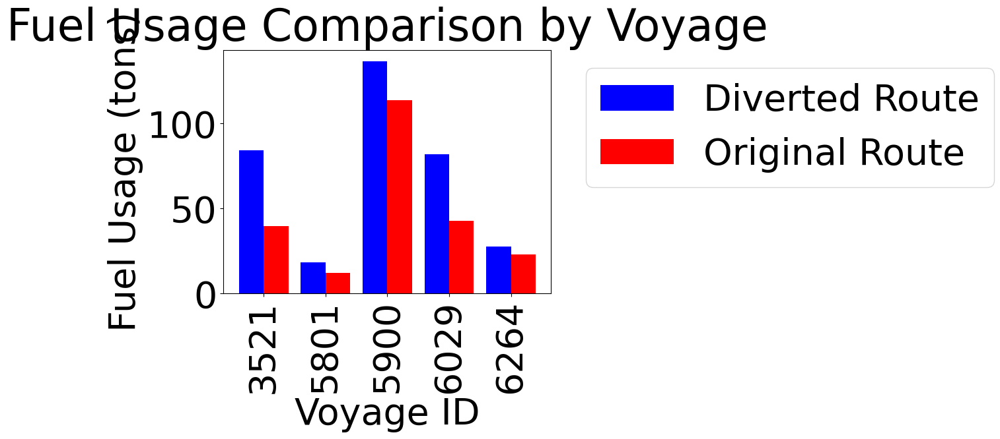


Fuel Usage Analysis by Voyage:

Voyage 3521:
- Original Route Fuel Usage: 39.60 tons
- Diverted Route Fuel Usage: 84.18 tons
- Additional Fuel: 44.58 tons
- Additional Fuel Cost: $35,660.00

Voyage 5801:
- Original Route Fuel Usage: 12.15 tons
- Diverted Route Fuel Usage: 18.32 tons
- Additional Fuel: 6.17 tons
- Additional Fuel Cost: $4,940.00

Voyage 5900:
- Original Route Fuel Usage: 113.70 tons
- Diverted Route Fuel Usage: 136.48 tons
- Additional Fuel: 22.78 tons
- Additional Fuel Cost: $18,220.00

Voyage 6029:
- Original Route Fuel Usage: 42.65 tons
- Diverted Route Fuel Usage: 81.80 tons
- Additional Fuel: 39.15 tons
- Additional Fuel Cost: $31,320.00

Voyage 6264:
- Original Route Fuel Usage: 22.80 tons
- Diverted Route Fuel Usage: 27.50 tons
- Additional Fuel: 4.70 tons
- Additional Fuel Cost: $3,760.00

Average Fuel Usage Across All Voyages:
Average Original Route Fuel Usage: 46.18 tons
Average Diverted Route Fuel Usage: 69.66 tons
Average Additional Fuel: 23.48 tons


In [107]:
# Plot fuel-related metrics including before/after comparison
plt.figure(figsize=(15, 6))
fuel_data = summary[summary['Metric'].isin([
    'Direct Time (hours)',
    'Diverted Time (hours)'
])].copy()

# Calculate fuel consumption for both routes
fuel_data['Fuel Usage'] = (fuel_data['Value'] / 24) * 60  # 60 tons per day
fuel_data['Route Type'] = fuel_data['Metric'].map({
    'Direct Time (hours)': 'Original Route',
    'Diverted Time (hours)': 'Diverted Route'
})

# Reshape data for grouped bar plot
fuel_pivot = fuel_data.pivot(columns='Route Type', values='Fuel Usage', index='Voyage')

# Plot grouped bar chart
fuel_pivot.plot(kind='bar', width=0.8, color=['blue', 'red'])
plt.title('Fuel Usage Comparison by Voyage')
plt.xlabel('Voyage ID')
plt.ylabel('Fuel Usage (tons)')
plt.legend(title='', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Print detailed fuel analysis
print("\nFuel Usage Analysis by Voyage:")
print("============================")
for voyage_id in summary['Voyage'].unique():
    voyage_data = summary[summary['Voyage'] == voyage_id]
    direct_time = voyage_data[voyage_data['Metric'] == 'Direct Time (hours)']['Value'].iloc[0]
    diverted_time = voyage_data[voyage_data['Metric'] == 'Diverted Time (hours)']['Value'].iloc[0]
    
    direct_fuel = (direct_time / 24) * 60
    diverted_fuel = (diverted_time / 24) * 60
    additional_fuel = diverted_fuel - direct_fuel
    
    print(f"\nVoyage {voyage_id}:")
    print(f"- Original Route Fuel Usage: {direct_fuel:.2f} tons")
    print(f"- Diverted Route Fuel Usage: {diverted_fuel:.2f} tons")
    print(f"- Additional Fuel: {additional_fuel:.2f} tons")
    print(f"- Additional Fuel Cost: ${additional_fuel * 800:,.2f}")

# Calculate and print averages
print("\nAverage Fuel Usage Across All Voyages:")
print("===================================")
avg_direct_fuel = (summary[summary['Metric'] == 'Direct Time (hours)']['Value'] / 24 * 60).mean()
avg_diverted_fuel = (summary[summary['Metric'] == 'Diverted Time (hours)']['Value'] / 24 * 60).mean()
print(f"Average Original Route Fuel Usage: {avg_direct_fuel:.2f} tons")
print(f"Average Diverted Route Fuel Usage: {avg_diverted_fuel:.2f} tons")
print(f"Average Additional Fuel: {avg_diverted_fuel - avg_direct_fuel:.2f} tons")

#### Export data to frontend

In [108]:
import json

def prepare_route_analysis_data(summary, commodities):
    """
    Prepare analysis data in a frontend-friendly JSON format
    """
    # Get data by voyage
    voyage_data = {}
    for voyage_id in summary['Voyage'].unique():
        voyage_summary = summary[summary['Voyage'] == voyage_id]
        
        # Create dictionary for this voyage
        voyage_data[str(voyage_id)] = {
            'distances': {
                'direct': float(voyage_summary[voyage_summary['Metric'] == 'Direct Distance (nm)']['Value'].iloc[0]),
                'diverted': float(voyage_summary[voyage_summary['Metric'] == 'Diverted Distance (nm)']['Value'].iloc[0]),
                'additional': float(voyage_summary[voyage_summary['Metric'] == 'Additional Distance (nm)']['Value'].iloc[0])
            },
            'time': {
                'direct': float(voyage_summary[voyage_summary['Metric'] == 'Direct Time (hours)']['Value'].iloc[0]),
                'diverted': float(voyage_summary[voyage_summary['Metric'] == 'Diverted Time (hours)']['Value'].iloc[0]),
                'additional': float(voyage_summary[voyage_summary['Metric'] == 'Additional Time (hours)']['Value'].iloc[0])
            },
            'fuel': {
                'additional_tons': float(voyage_summary[voyage_summary['Metric'] == 'Additional Fuel (tons)']['Value'].iloc[0]),
                'additional_cost': float(voyage_summary[voyage_summary['Metric'] == 'Additional Fuel Cost (USD)']['Value'].iloc[0])
            },
            'cost_impact': {
                'per_teu': float(voyage_summary[voyage_summary['Metric'] == 'Additional Cost per TEU (USD)']['Value'].iloc[0]),
                'percentage': float(voyage_summary[voyage_summary['Metric'] == 'Price Impact (%)']['Value'].iloc[0])
            }
        }
    
    # Prepare commodity impact data
    commodity_data = commodities.to_dict(orient='records')
    
    # Calculate averages
    averages = {
        'additional_distance': float(summary[summary['Metric'] == 'Additional Distance (nm)']['Value'].mean()),
        'additional_time': float(summary[summary['Metric'] == 'Additional Time (hours)']['Value'].mean()),
        'additional_fuel': float(summary[summary['Metric'] == 'Additional Fuel (tons)']['Value'].mean()),
        'additional_cost': float(summary[summary['Metric'] == 'Additional Fuel Cost (USD)']['Value'].mean()),
        'price_impact': float(summary[summary['Metric'] == 'Price Impact (%)']['Value'].mean())
    }
    
    # Combine all data
    analysis_data = {
        'voyages': voyage_data,
        'commodities': commodity_data,
        'averages': averages,
        'metadata': {
            'fuel_price_per_ton': 800,
            'vessel_capacity_teu': 10000,
            'avg_speed_knots': 15
        }
    }
    
    return analysis_data

# Export the data
analysis_data = prepare_route_analysis_data(summary, commodities)

# Save to JSON file
with open('route_analysis.json', 'w') as f:
    json.dump(analysis_data, f, indent=2)

# Print example of the structure
print("Data structure for frontend:")
print(json.dumps(analysis_data, indent=2))

Data structure for frontend:
{
  "voyages": {
    "3521": {
      "distances": {
        "direct": 237.66,
        "diverted": 505.05,
        "additional": 267.38
      },
      "time": {
        "direct": 15.84,
        "diverted": 33.67,
        "additional": 17.83
      },
      "fuel": {
        "additional_tons": 44.56,
        "additional_cost": 35650.9
      },
      "cost_impact": {
        "per_teu": 3.57,
        "percentage": 0.01
      }
    },
    "5801": {
      "distances": {
        "direct": 72.84,
        "diverted": 110.01,
        "additional": 37.17
      },
      "time": {
        "direct": 4.86,
        "diverted": 7.33,
        "additional": 2.48
      },
      "fuel": {
        "additional_tons": 6.19,
        "additional_cost": 4955.56
      },
      "cost_impact": {
        "per_teu": 0.5,
        "percentage": 0.0
      }
    },
    "5900": {
      "distances": {
        "direct": 682.13,
        "diverted": 818.83,
        "additional": 136.7
      },
    

FileNotFoundError: [Errno 2] No such file or directory: 'pictures/Summer voyage, Grid 5km x 5km, Adjacent model, Voyage 3521.png'

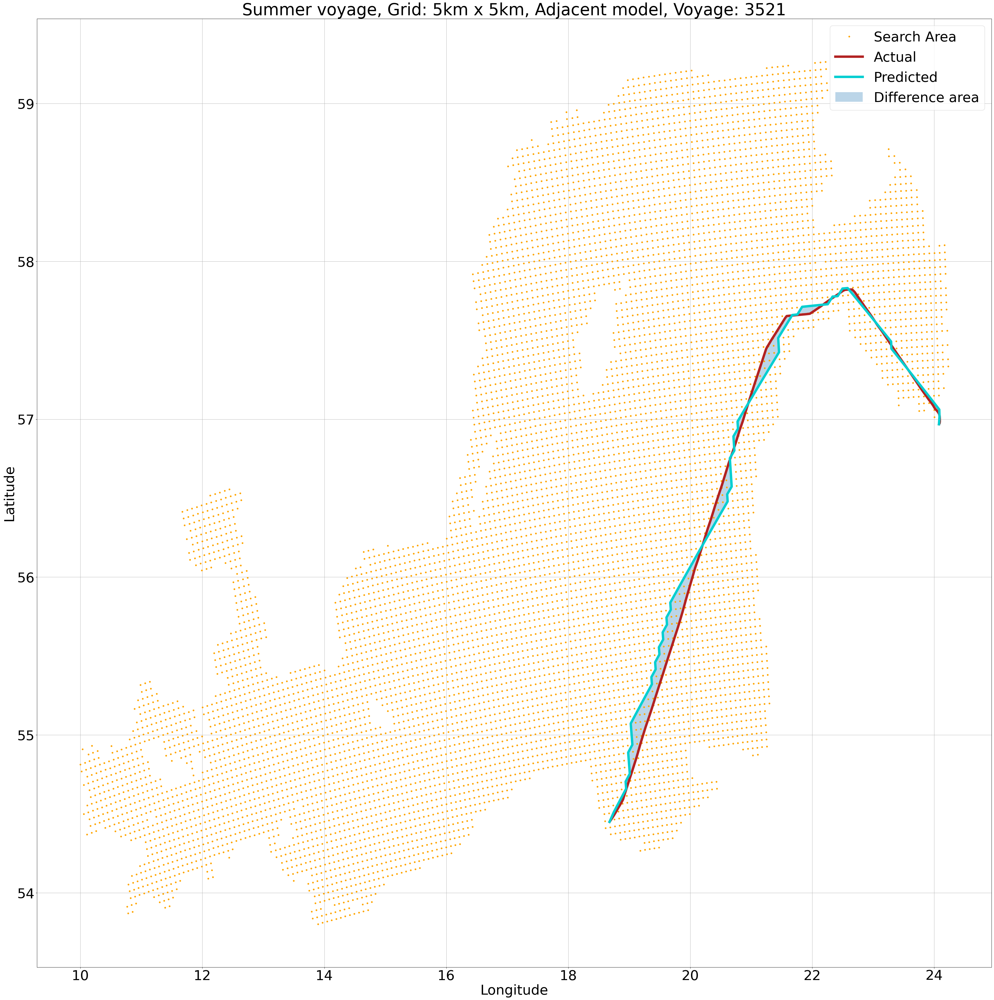

In [ ]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, 'Summer voyage, Grid: 5km x 5km, Adjacent model, Voyage: ', 4, False)

FileNotFoundError: [Errno 2] No such file or directory: 'pictures/Summer voyage, Grid 5km x 5km, Adjacent model, Voyage 3521.png'

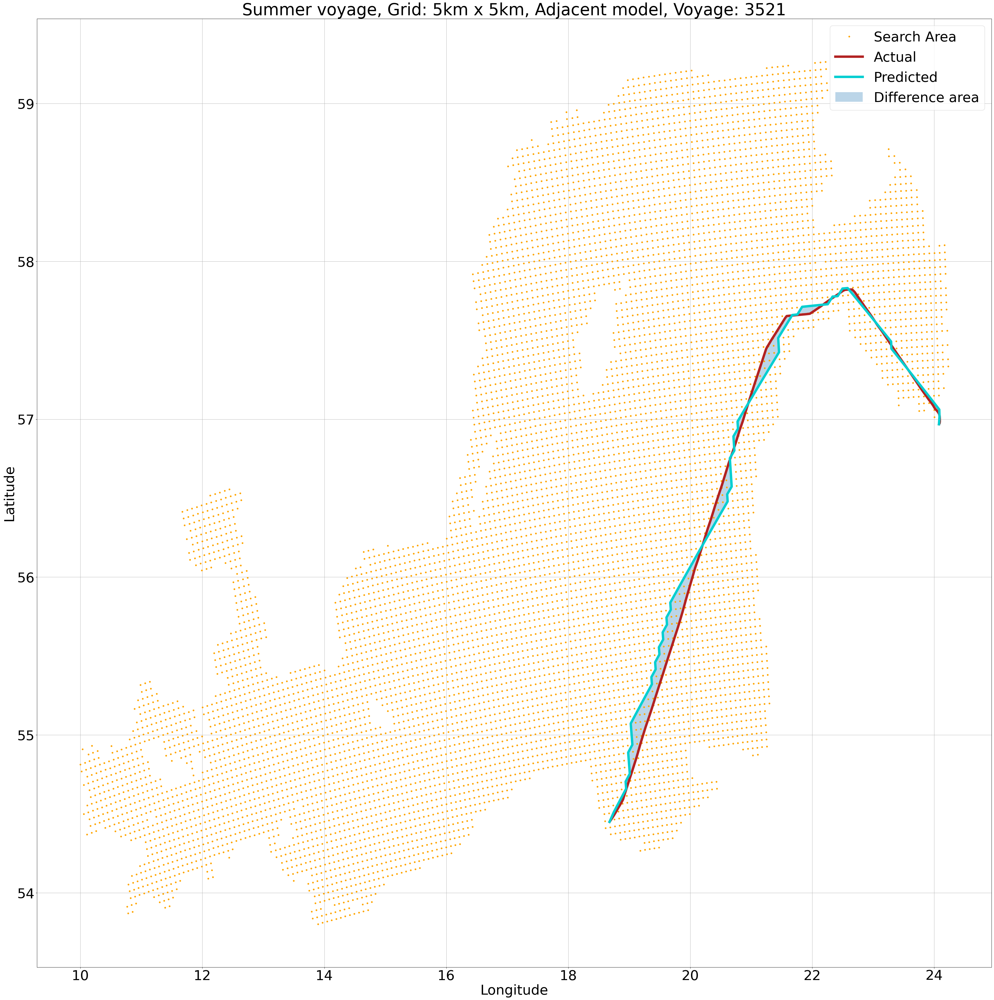

In [ ]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, 'Summer voyage, Grid: 5km x 5km, Adjacent model, Voyage: ', 4, False)

FileNotFoundError: [Errno 2] No such file or directory: 'pictures/Summer voyage, Grid 5km x 5km, Adjacent model, Voyage 3521.png'

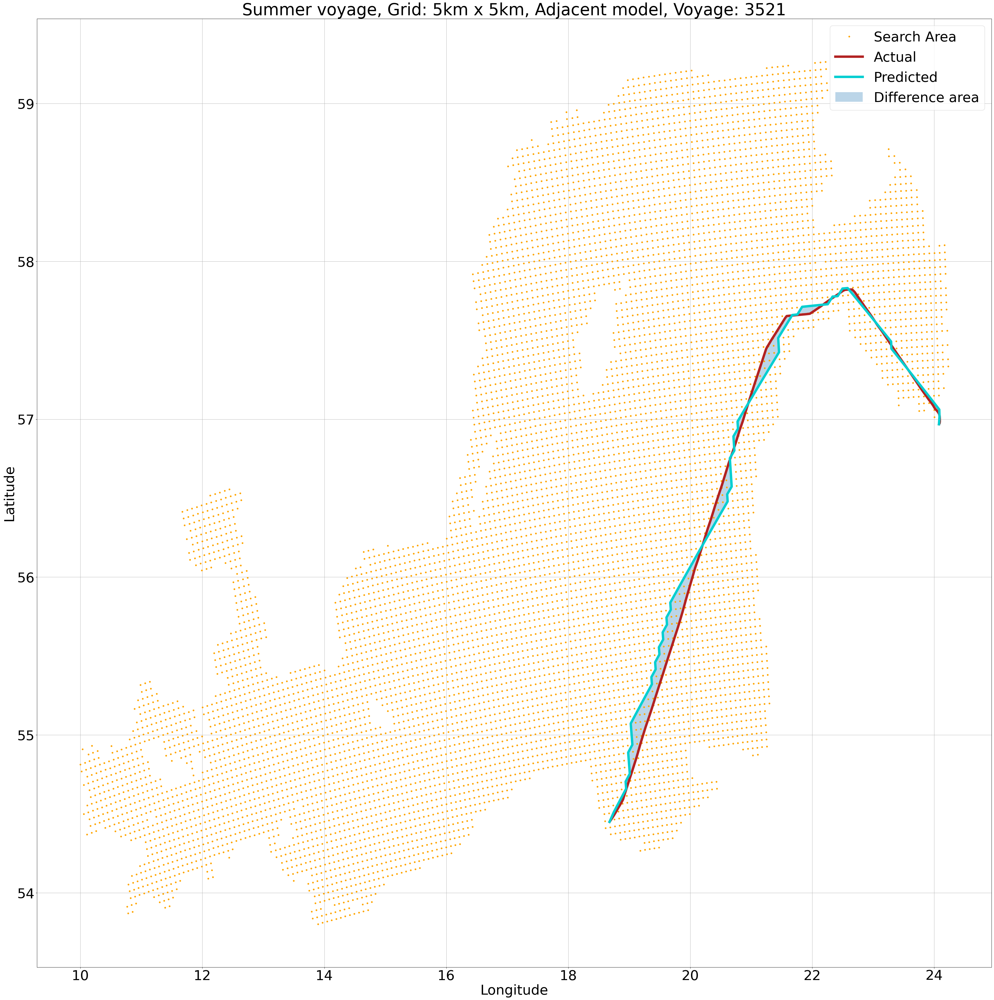

In [ ]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, 'Summer voyage, Grid: 5km x 5km, Adjacent model, Voyage: ', 4, False)

In [89]:
# Add this new cell after your route prediction
from geopy.distance import geodesic
import pandas as pd
from datetime import timedelta

# Convert the routes data to a DataFrame
route_coordinates = new_routes['routes'][0]['coordinates']  # Get the first route's coordinates
route_df = pd.DataFrame(route_coordinates, columns=['lat', 'lon'])

def analyze_route_impact(route_df):
    """
    Analyze the impact of a diverted route compared to direct route
    """
    # Extract start and end points
    start_point = [route_df.iloc[0]['lat'], route_df.iloc[0]['lon']]
    end_point = [route_df.iloc[-1]['lat'], route_df.iloc[-1]['lon']]
    
    # Calculate direct distance
    direct_distance = geodesic(start_point, end_point).nautical
    
    # Calculate diverted distance
    diverted_distance = 0
    for i in range(len(route_df)-1):
        point1 = [route_df.iloc[i]['lat'], route_df.iloc[i]['lon']]
        point2 = [route_df.iloc[i+1]['lat'], route_df.iloc[i+1]['lon']]
        diverted_distance += geodesic(point1, point2).nautical
    
    # Calculate time differences
    avg_speed = 15  # nautical miles per hour
    direct_time = direct_distance / avg_speed
    diverted_time = diverted_distance / avg_speed
    additional_time = diverted_time - direct_time
    
    # Calculate fuel consumption and costs
    fuel_consumption_rate = 60  # tons per day
    fuel_price = 800  # USD per ton
    
    direct_fuel = (direct_time / 24) * fuel_consumption_rate
    diverted_fuel = (diverted_time / 24) * fuel_consumption_rate
    additional_fuel = diverted_fuel - direct_fuel
    
    additional_fuel_cost = additional_fuel * fuel_price
    
    # Calculate impact on container costs
    teu_capacity = 10000  # Twenty-foot Equivalent Units
    avg_value_per_teu = 40000  # USD
    total_cargo_value = teu_capacity * avg_value_per_teu
    
    additional_cost_per_teu = additional_fuel_cost / teu_capacity
    price_impact_percentage = (additional_cost_per_teu / avg_value_per_teu) * 100
    
    # Create summary DataFrame
    summary = pd.DataFrame({
        'Metric': [
            'Direct Distance (nm)',
            'Diverted Distance (nm)',
            'Additional Distance (nm)',
            'Direct Time (hours)',
            'Diverted Time (hours)',
            'Additional Time (hours)',
            'Additional Fuel (tons)',
            'Additional Fuel Cost (USD)',
            'Additional Cost per TEU (USD)',
            'Price Impact (%)'
        ],
        'Value': [
            round(direct_distance, 2),
            round(diverted_distance, 2),
            round(diverted_distance - direct_distance, 2),
            round(direct_time, 2),
            round(diverted_time, 2),
            round(additional_time, 2),
            round(additional_fuel, 2),
            round(additional_fuel_cost, 2),
            round(additional_cost_per_teu, 2),
            round(price_impact_percentage, 2)
        ]
    })
    
    # Calculate commodity-specific impacts
    commodities = pd.DataFrame({
        'Commodity': ['Electronics', 'Clothing', 'Food Products'],
        'Baseline Price (USD)': [1000, 50, 200],
        'Impact Multiplier': [1.2, 0.8, 1.5]  # Higher impact on electronics and food
    })
    
    commodities['Estimated Price Increase (%)'] = commodities['Impact Multiplier'] * price_impact_percentage
    commodities['New Price (USD)'] = commodities['Baseline Price (USD)'] * (1 + commodities['Estimated Price Increase (%)'] / 100)
    
    return summary, commodities

# Analyze the predicted route
# Assuming route_df is your DataFrame with the predicted route
summary, commodities = analyze_route_impact(route_df)

# Display results
print("Route Impact Analysis:")
print("=====================")
print(summary.to_string(index=False))
print("\nCommodity Price Impact:")
print("=====================")
print(commodities.to_string(index=False))

# Optional: Visualize the results
import matplotlib.pyplot as plt
import seaborn as sns

# Plot distance comparison
plt.figure(figsize=(12, 6))
distances = summary[summary['Metric'].str.contains('Distance')].copy()
plt.bar(distances['Metric'], distances['Value'])
plt.title('Distance Comparison')
plt.xticks(rotation=45)
plt.ylabel('Nautical Miles')
plt.tight_layout()
plt.show()

# Plot commodity price impact
plt.figure(figsize=(10, 6))
plt.bar(commodities['Commodity'], 
        commodities['Estimated Price Increase (%)'])
plt.title('Estimated Price Impact by Commodity')
plt.ylabel('Price Increase (%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot route comparison
plt.figure(figsize=(12, 8))
# Plot diverted route
plt.plot(route_df['lon'], route_df['lat'], 
         'b-', label='Diverted Route')
# Plot direct route
plt.plot([route_df.iloc[0]['lon'], route_df.iloc[-1]['lon']], 
         [route_df.iloc[0]['lat'], route_df.iloc[-1]['lat']], 
         'r--', label='Direct Route')
plt.title('Route Comparison')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

KeyError: 'coordinates'

FileNotFoundError: [Errno 2] No such file or directory: 'pictures/Summer voyage, Grid 5km x 5km, Adjacent model, Voyage 3521.png'

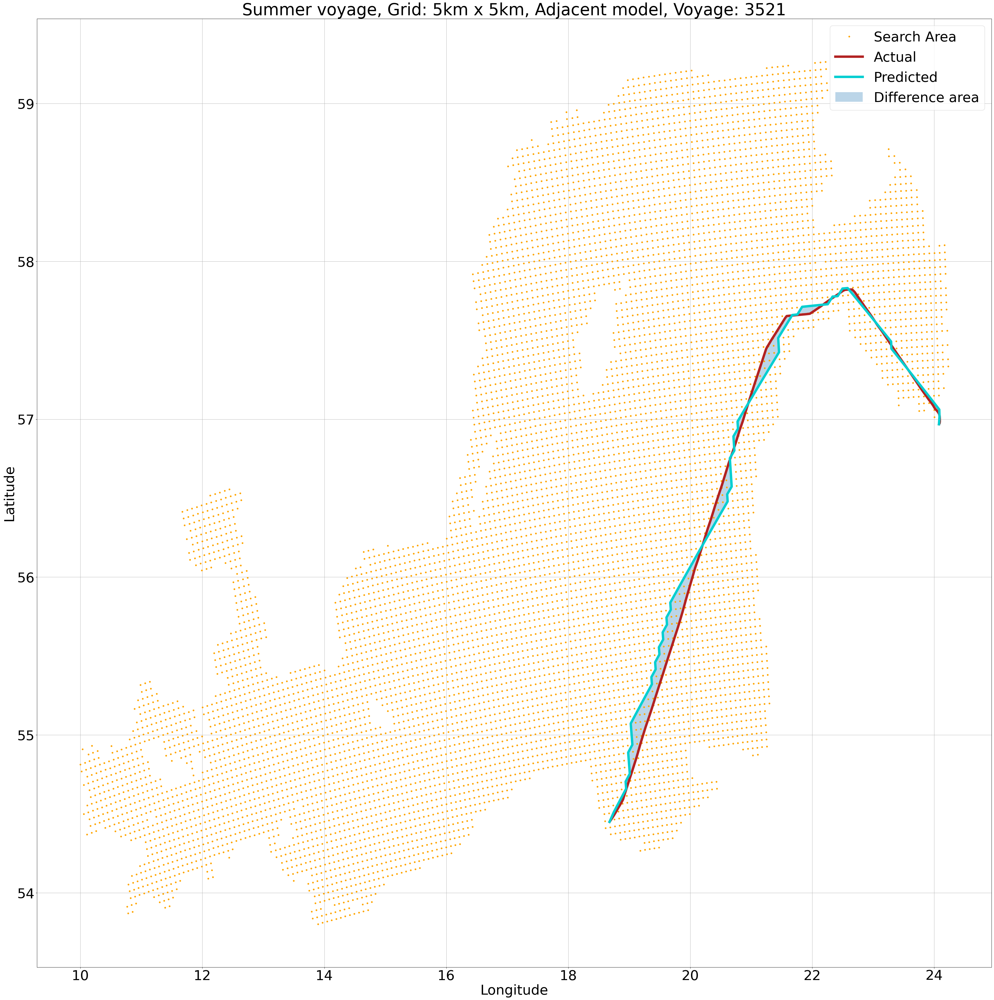

In [73]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, 'Summer voyage, Grid: 5km x 5km, Adjacent model, Voyage: ', 4, False)

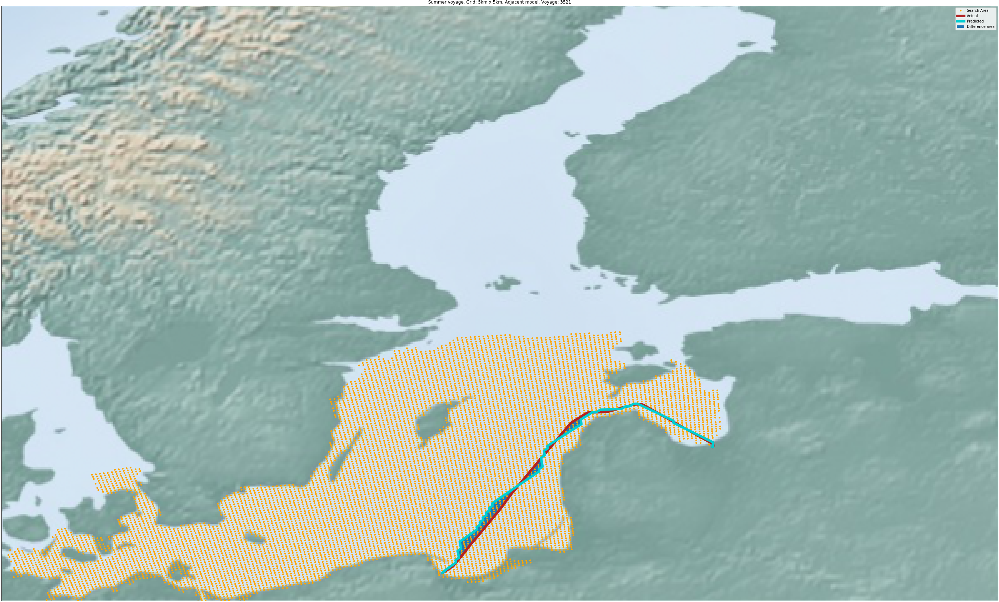

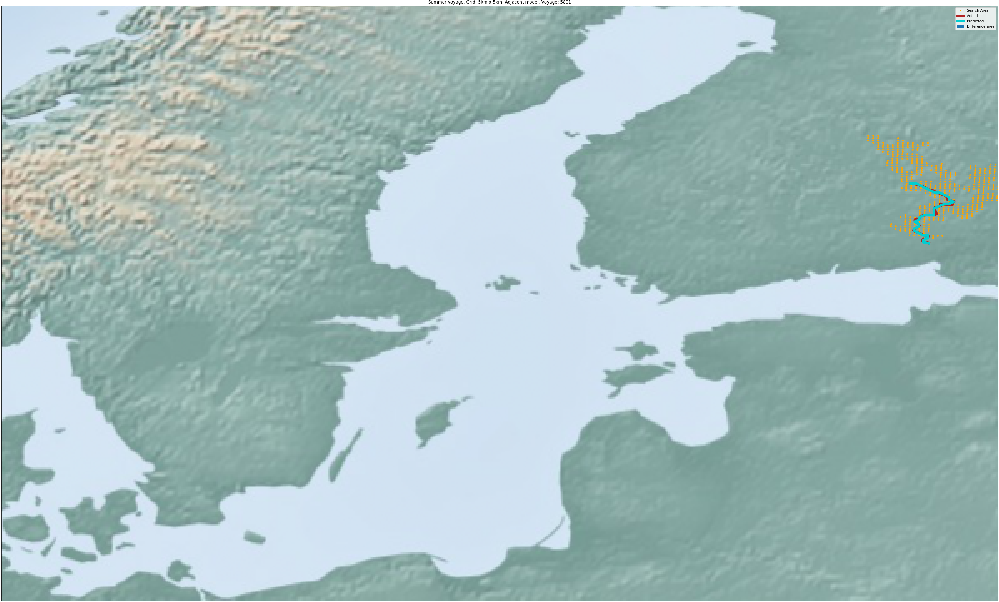

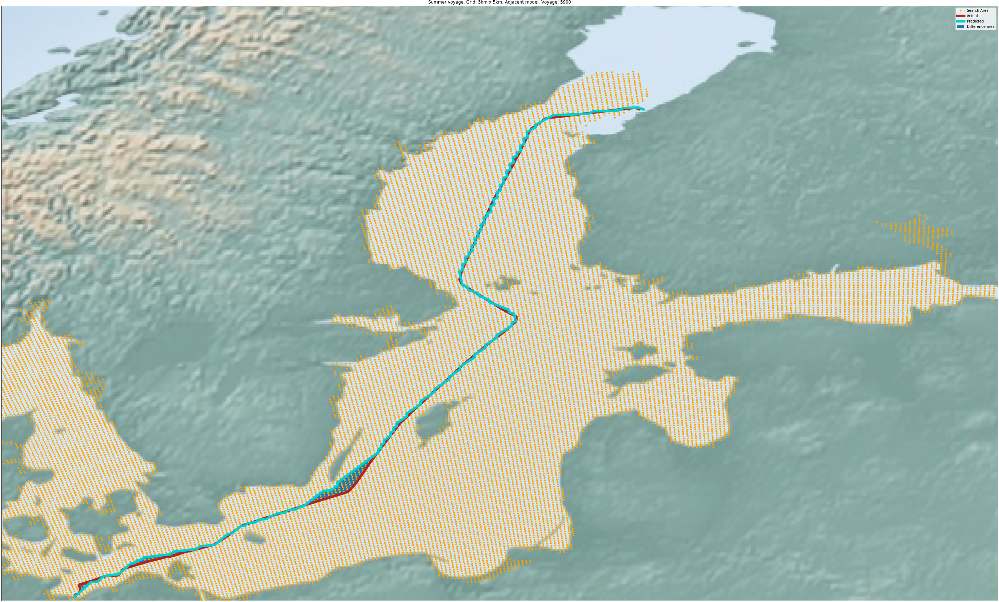

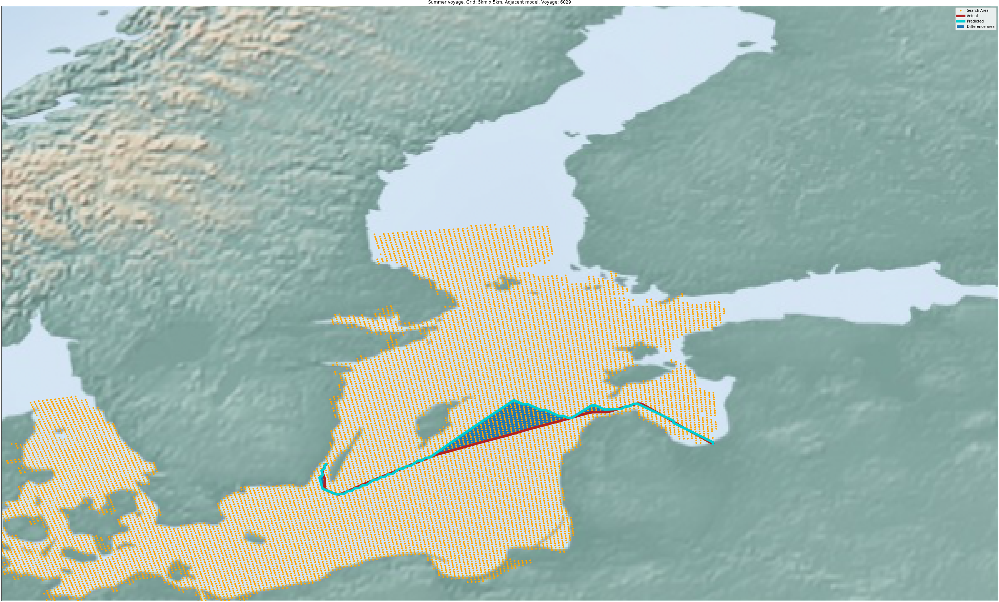

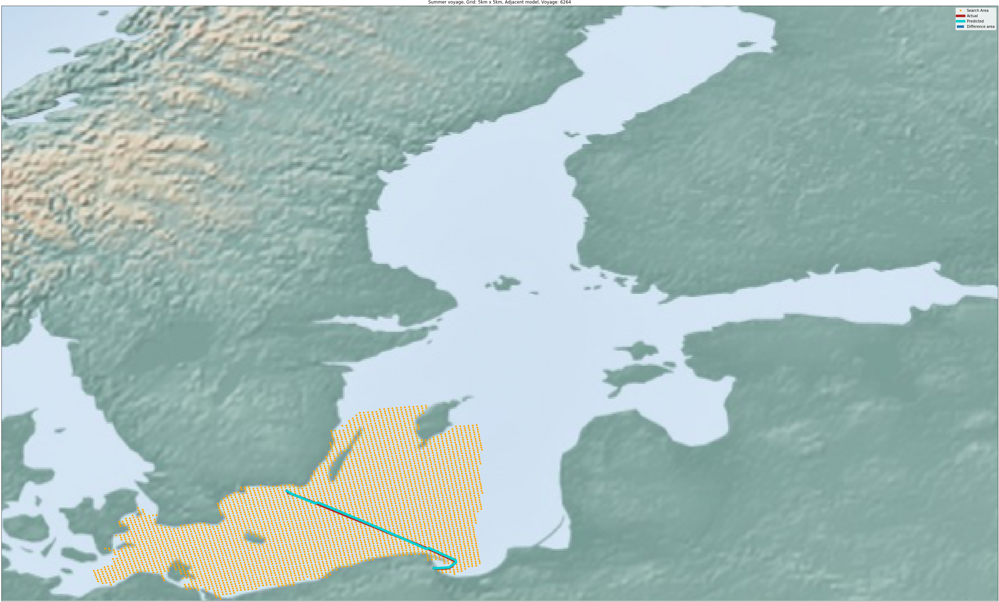

In [27]:
plot_route_and_search_area(routes_adjacent_5km, areas_adjacent_5km, test_voyages, 'Summer voyage, Grid: 5km x 5km, Adjacent model, Voyage: ', 4, False)

In [34]:
# Predicting routes using the ship model 5km

importlib.reload(shortest_path)
graph_ship_5km.use_turn_penalty = False
graph_ship_5km.use_shallow_penalty = True
graph_ship_5km.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(summer_test_voyages.tail(5), grid_5km, graph_ship_5km, speed_model_5km, None, shallow_graph_5km)
routes_ship_model_5km = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_ship_model_5km = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 5000
Error count= 0
[]
CPU times: user 2min 24s, sys: 2.38 s, total: 2min 26s
Wall time: 2min 32s


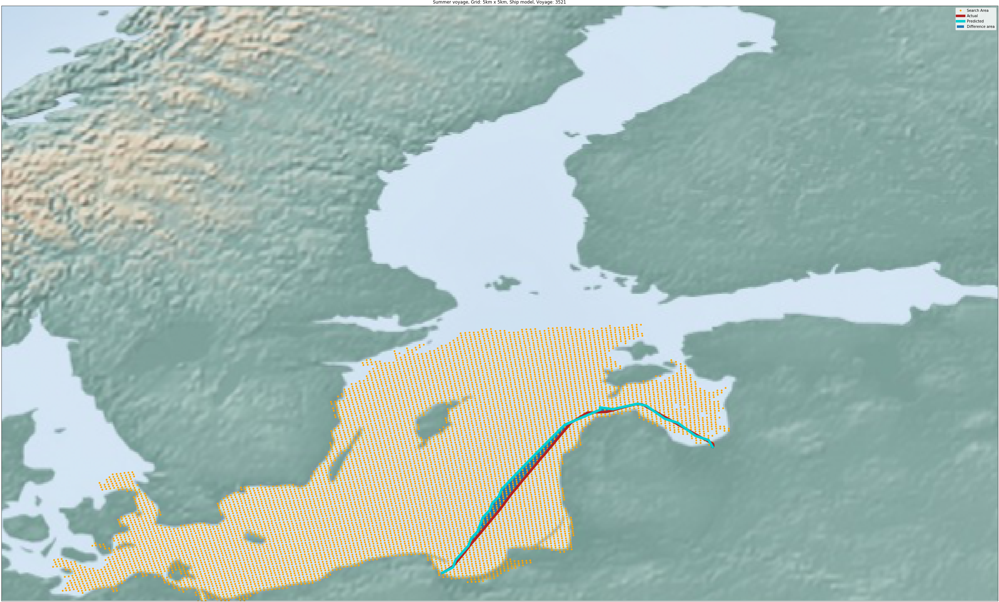

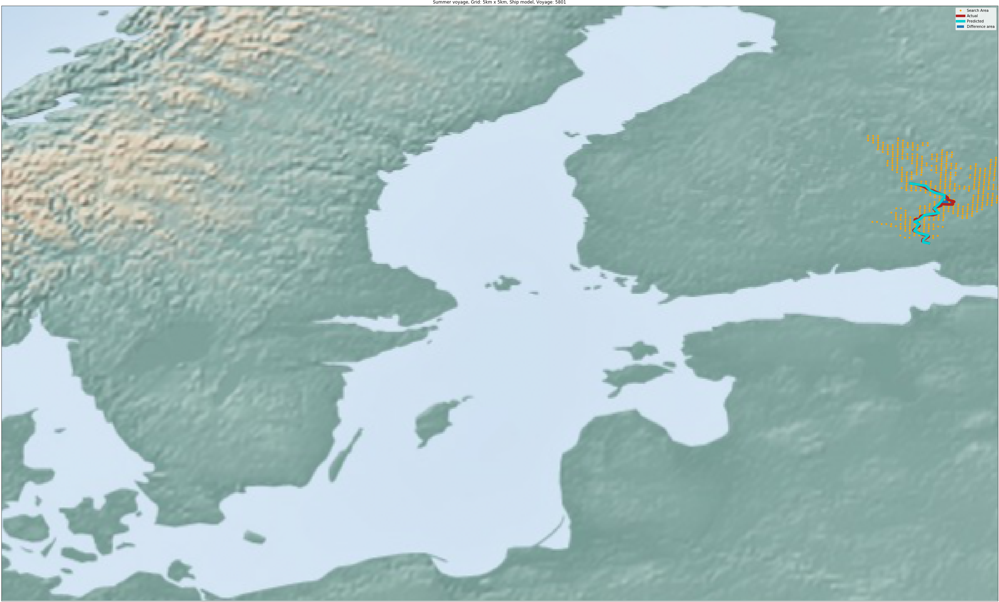

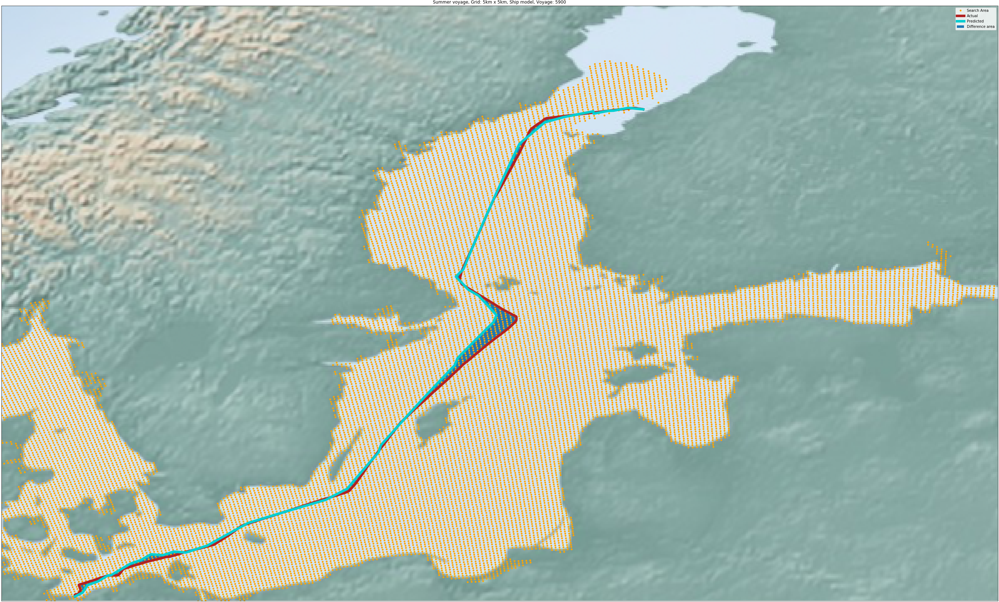

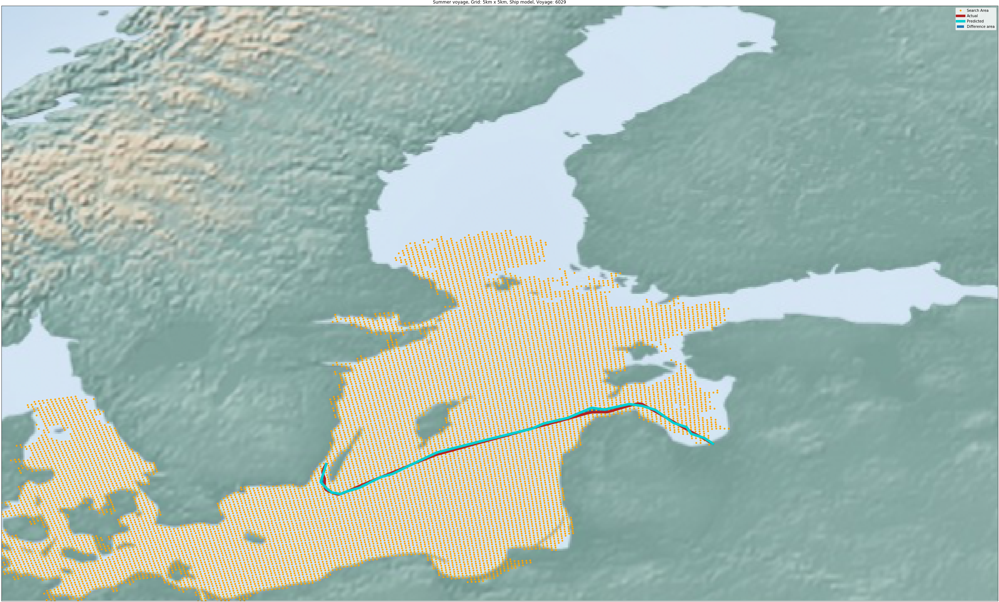

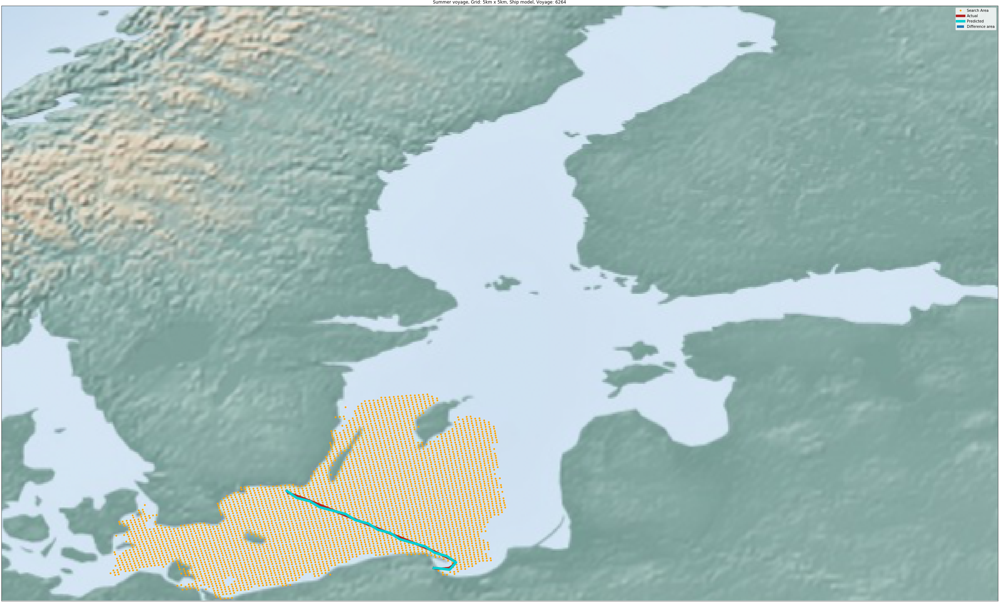

In [35]:
plot_route_and_search_area(routes_ship_model_5km, areas_ship_model_5km, test_voyages,'Summer voyage, Grid: 5km x 5km, Ship model, Voyage: ', 4, False)

In [36]:
# Predicting routes using the adjacent model 2500m

importlib.reload(shortest_path)
graph_adj_2500m.use_turn_penalty = False
graph_adj_2500m.use_shallow_penalty = True
graph_adj_2500m.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(summer_test_voyages.tail(5), grid_2500m, graph_adj_2500m, speed_model_2500m, None, shallow_graph_2500m)
routes_adjacent_2500m = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_adjacent_2500m = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 2500
Path does not exist!
Voyage= 6264
Error count= 1
[[[56.08808333333333, 15.56909], [54.54555500000001, 18.505303333333334]]]
CPU times: user 2min 19s, sys: 1.22 s, total: 2min 20s
Wall time: 2min 22s


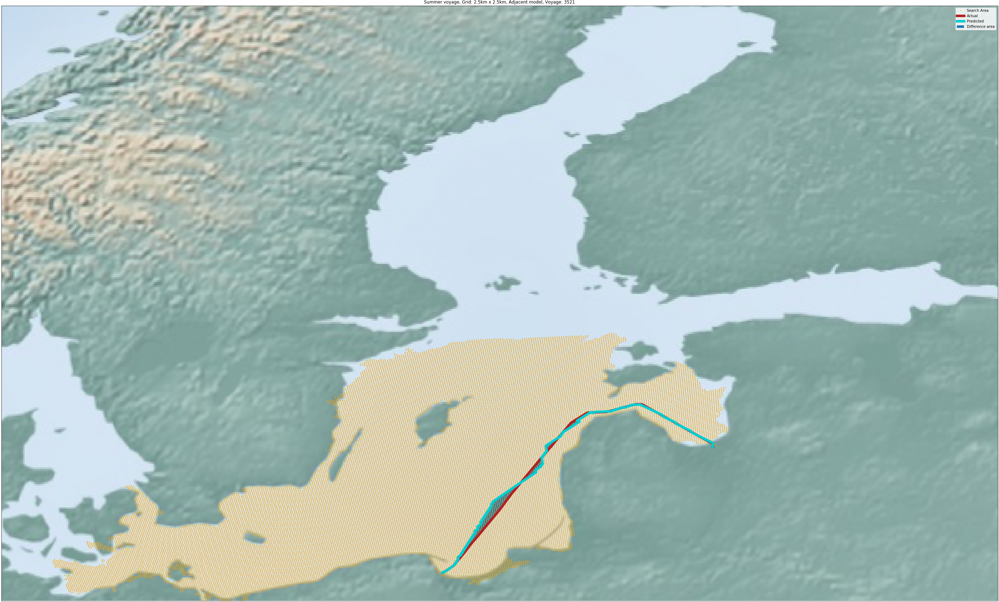

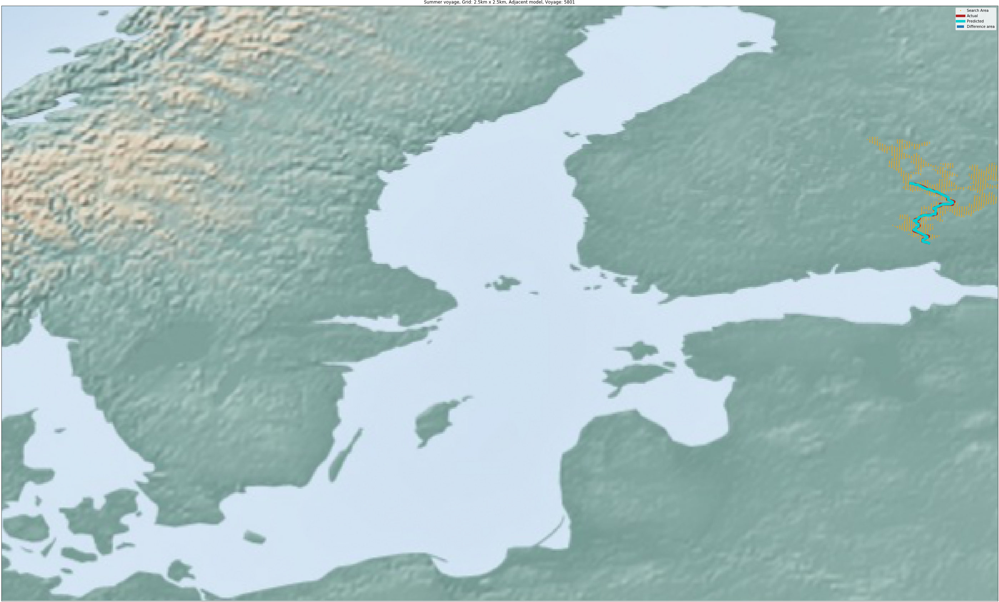

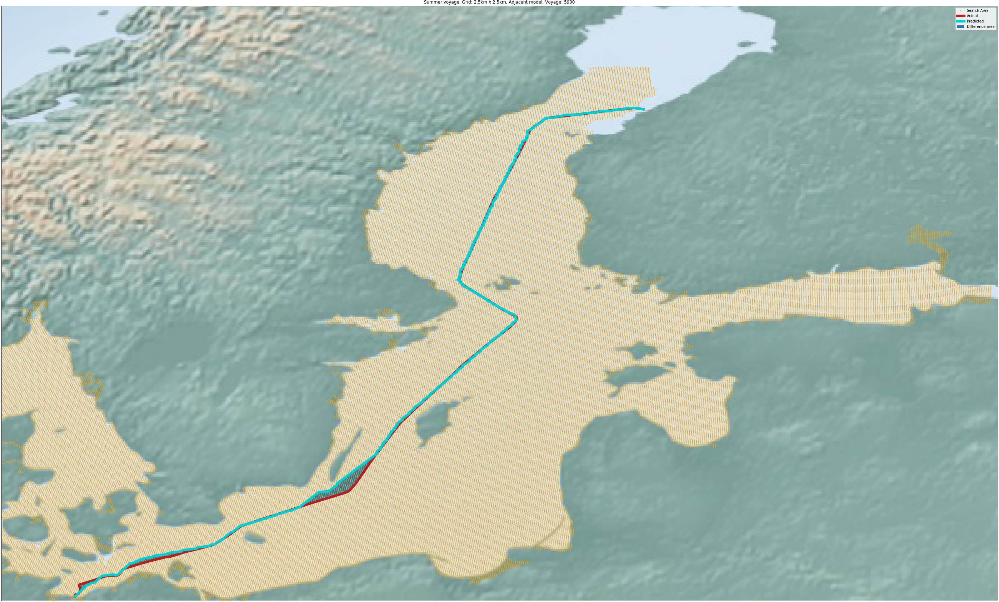

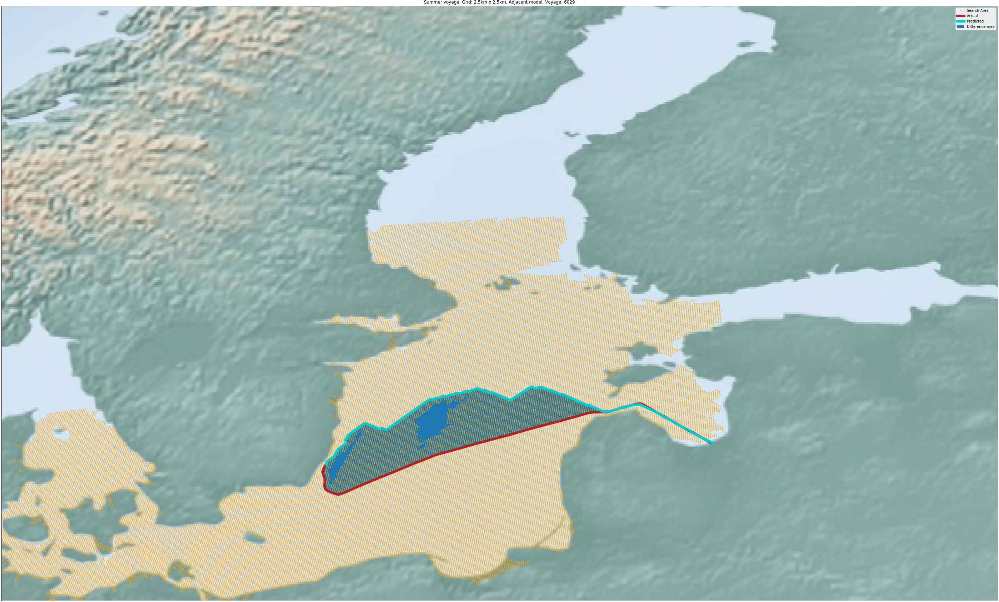

In [37]:
plot_route_and_search_area(routes_adjacent_2500m, areas_adjacent_2500m, test_voyages,'Summer voyage, Grid: 2.5km x 2.5km, Adjacent model, Voyage: ', 1.5, False)

In [38]:
# Predicting routes using the adjacent model 2500m

importlib.reload(shortest_path)
graph_ship_2500m.use_turn_penalty = False
graph_ship_2500m.use_shallow_penalty = True
graph_ship_2500m.use_dirways = False

%time routes_and_areas = shortest_path.predict_routes(summer_test_voyages.tail(5), grid_2500m, graph_ship_2500m, speed_model_2500m, None, shallow_graph_2500m)
routes_ship_model_2500m = pd.DataFrame(data=routes_and_areas[0], columns=['lat', 'lon', 'node', 'speed', 'mmsi', 'voyage', 'start_time', 'number'])
areas_ship_model_2500m = pd.DataFrame(data=routes_and_areas[1], columns=['lat', 'lon', 'voyage','g', 'h', 'f'])

use_dirways= False
use_turn_penalty= False
use_shallow_penalty= True
side_length: 2500
Path does not exist!
Voyage= 6264
Error count= 1
[[[56.08808333333333, 15.56909], [54.54555500000001, 18.505303333333334]]]
CPU times: user 59min 51s, sys: 17.1 s, total: 1h 8s
Wall time: 1h 45s


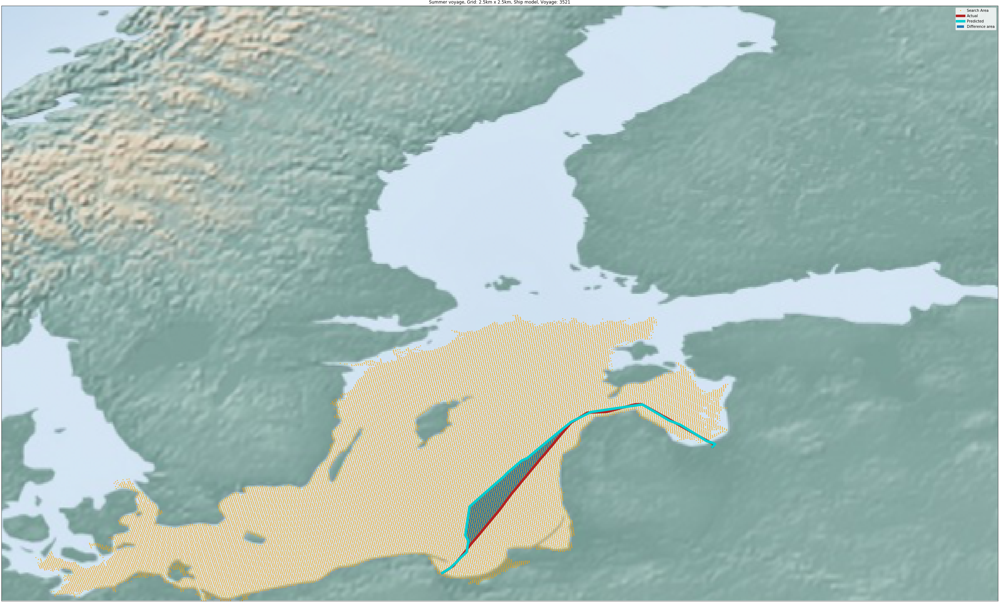

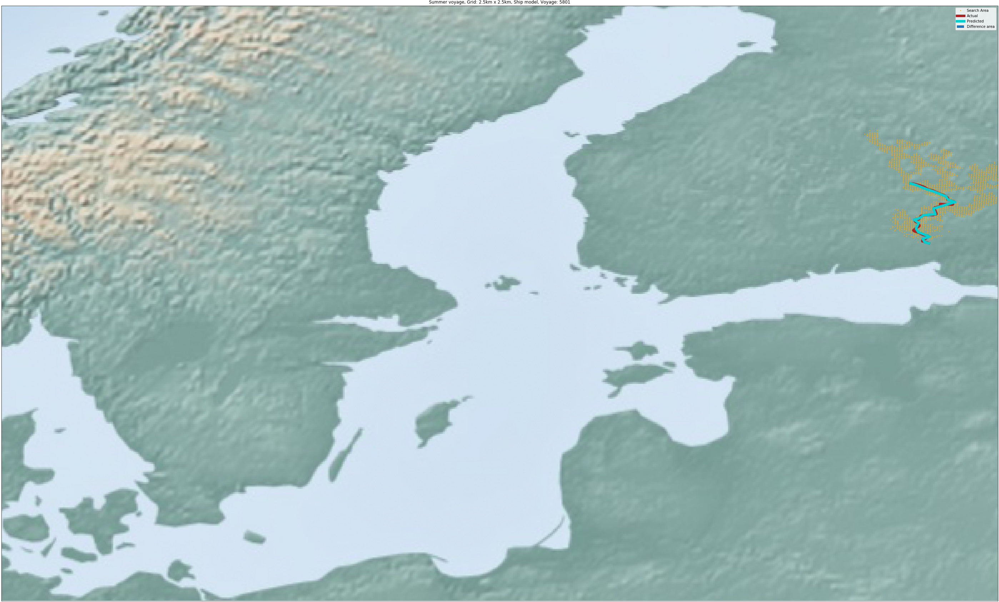

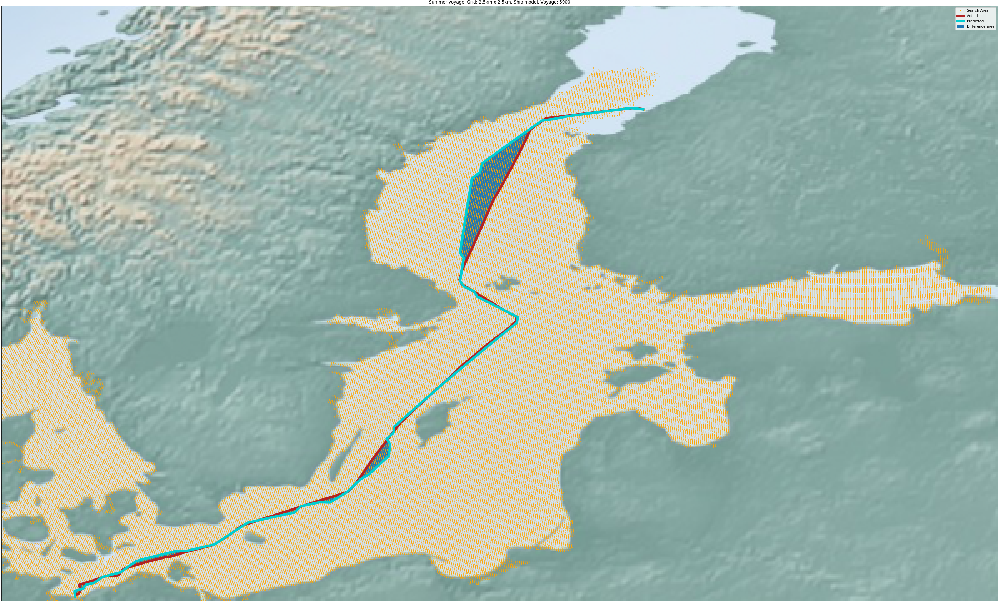

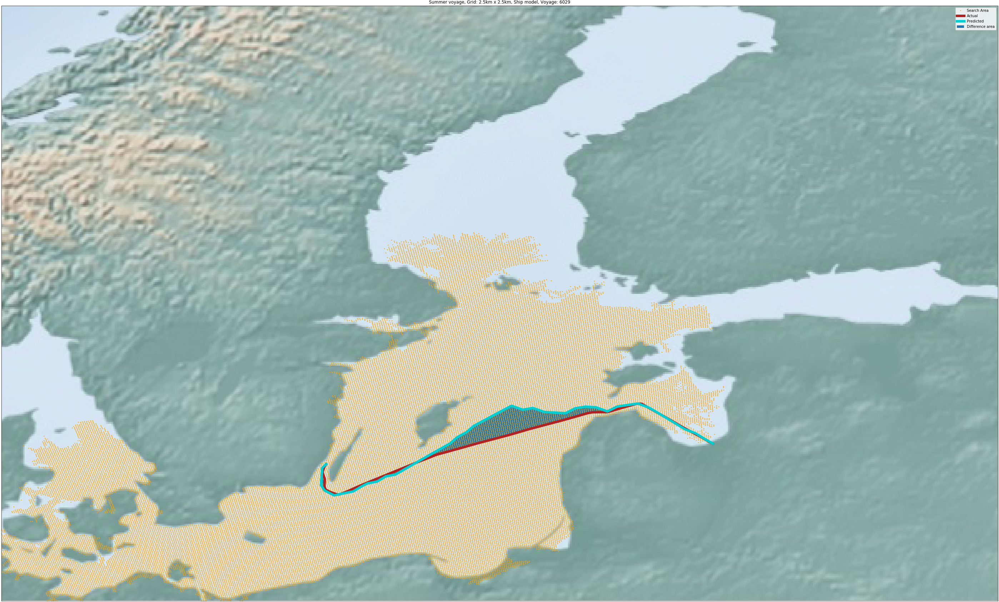

In [39]:
plot_route_and_search_area(routes_ship_model_2500m, areas_ship_model_2500m, test_voyages, 'Summer voyage, Grid: 2.5km x 2.5km, Ship model, Voyage: ', 1.5, False)